# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [2]:
!mkdir data

子目录或文件 data 已经存在。


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [4]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

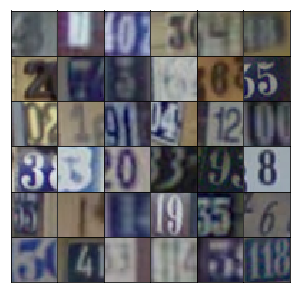

In [5]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [6]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [7]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [8]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [9]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        #first convolution
        xFirst = tf.layers.dense(z, 4*4*512)
        xFirst = tf.reshape(xFirst, (-1, 4, 4, 512))
        xFirst = tf.layers.batch_normalization(xFirst, training=training)
        xFirst = tf.maximum(alpha * xFirst, xFirst)
        
        #second convolution
        xSecond = tf.layers.conv2d_transpose(xFirst, 256, 5, strides=2, padding='same')
        xSecond = tf.layers.batch_normalization(xSecond, training=training)
        xSecond = tf.maximum(xSecond * alpha, xSecond)
        
        #third convolution
        xThrid = tf.layers.conv2d_transpose(xSecond, 128, 5, strides=2, padding='same')
        xThrid = tf.layers.batch_normalization(xThrid, training=training)
        xThrid = tf.maximum(xThrid * alpha, xThrid)
        
        
        # Output layer, 32x32x3
        logits = tf.layers.conv2d_transpose(xThrid, output_dim, 5, strides=2, padding='same')
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've built before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [10]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        #first convolution
        xFirst = tf.layers.conv2d(x, 64, 5, strides=2, padding='same')
        relu = tf.maximum(xFirst * alpha, xFirst)
        
        #second convolution
        xSecond = tf.layers.conv2d_transpose(relu, 256, 5, strides=2, padding='same')
        xSecond = tf.layers.batch_normalization(xSecond, training=True)
        relu2 = tf.maximum(alpha * xSecond, xSecond)
        
        #third convolution
        xThird = tf.layers.conv2d(relu2, 256, 5, strides=2, padding='same')
        xThird = tf.layers.batch_normalization(xThird, training=True)
        relu3 = tf.maximum(alpha * xThird, xThird)
        
        flat = tf.reshape(relu3, (-1, 4*4*256))
        
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [11]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [12]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [13]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=alpha)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [14]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [15]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [16]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.002
batch_size = 128
epochs = 28
alpha = 0.15
beta1 = 0.4

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/28... Discriminator Loss: 1.3995... Generator Loss: 4.6918
Epoch 1/28... Discriminator Loss: 0.0815... Generator Loss: 3.0932
Epoch 1/28... Discriminator Loss: 1.0581... Generator Loss: 1.1981
Epoch 1/28... Discriminator Loss: 1.3006... Generator Loss: 1.7434
Epoch 1/28... Discriminator Loss: 0.7873... Generator Loss: 1.1260
Epoch 1/28... Discriminator Loss: 1.2283... Generator Loss: 0.7027
Epoch 1/28... Discriminator Loss: 0.1964... Generator Loss: 3.4261
Epoch 1/28... Discriminator Loss: 3.0980... Generator Loss: 5.4324
Epoch 1/28... Discriminator Loss: 0.8935... Generator Loss: 0.8567
Epoch 1/28... Discriminator Loss: 0.5329... Generator Loss: 1.3311


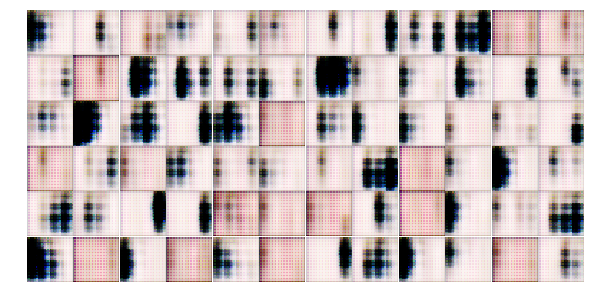

Epoch 1/28... Discriminator Loss: 0.5819... Generator Loss: 1.6107
Epoch 1/28... Discriminator Loss: 0.5683... Generator Loss: 3.1810
Epoch 1/28... Discriminator Loss: 0.7434... Generator Loss: 3.3818
Epoch 1/28... Discriminator Loss: 0.2680... Generator Loss: 1.7424
Epoch 1/28... Discriminator Loss: 0.4316... Generator Loss: 1.4136
Epoch 1/28... Discriminator Loss: 0.1191... Generator Loss: 2.4985
Epoch 1/28... Discriminator Loss: 0.5859... Generator Loss: 2.1933
Epoch 1/28... Discriminator Loss: 0.0665... Generator Loss: 3.3499
Epoch 1/28... Discriminator Loss: 1.6629... Generator Loss: 1.0268
Epoch 1/28... Discriminator Loss: 1.1417... Generator Loss: 1.2878


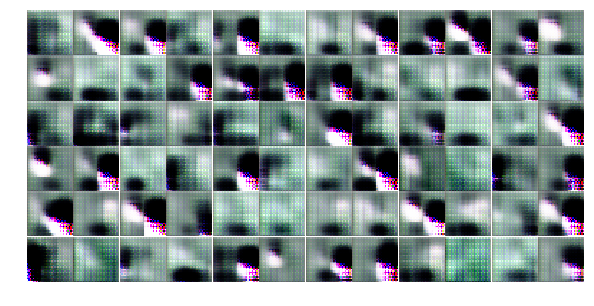

Epoch 1/28... Discriminator Loss: 1.1300... Generator Loss: 1.5434
Epoch 1/28... Discriminator Loss: 1.1648... Generator Loss: 1.9316
Epoch 1/28... Discriminator Loss: 1.0366... Generator Loss: 1.4507
Epoch 1/28... Discriminator Loss: 0.6929... Generator Loss: 1.2769
Epoch 1/28... Discriminator Loss: 1.8431... Generator Loss: 0.2395
Epoch 1/28... Discriminator Loss: 0.9713... Generator Loss: 0.8105
Epoch 1/28... Discriminator Loss: 0.6081... Generator Loss: 2.6852
Epoch 1/28... Discriminator Loss: 0.1054... Generator Loss: 3.0415
Epoch 1/28... Discriminator Loss: 0.0411... Generator Loss: 3.4572
Epoch 1/28... Discriminator Loss: 0.1196... Generator Loss: 2.6507


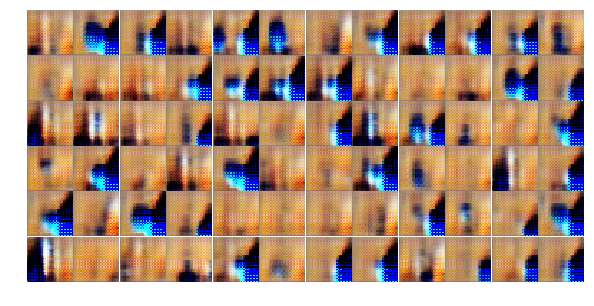

Epoch 1/28... Discriminator Loss: 0.1018... Generator Loss: 3.2061
Epoch 1/28... Discriminator Loss: 0.0148... Generator Loss: 5.5169
Epoch 1/28... Discriminator Loss: 0.0112... Generator Loss: 5.1030
Epoch 1/28... Discriminator Loss: 0.0292... Generator Loss: 4.0498
Epoch 1/28... Discriminator Loss: 0.0210... Generator Loss: 4.4189
Epoch 1/28... Discriminator Loss: 1.3141... Generator Loss: 0.9074
Epoch 1/28... Discriminator Loss: 2.1804... Generator Loss: 1.4093
Epoch 1/28... Discriminator Loss: 0.9720... Generator Loss: 1.9013
Epoch 1/28... Discriminator Loss: 1.2446... Generator Loss: 1.3263
Epoch 1/28... Discriminator Loss: 1.1839... Generator Loss: 0.9866


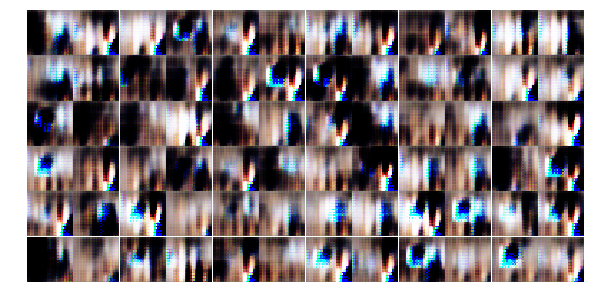

Epoch 1/28... Discriminator Loss: 1.0338... Generator Loss: 0.9243
Epoch 1/28... Discriminator Loss: 1.4572... Generator Loss: 1.5411
Epoch 1/28... Discriminator Loss: 0.9499... Generator Loss: 1.2318
Epoch 1/28... Discriminator Loss: 0.7758... Generator Loss: 2.1547
Epoch 1/28... Discriminator Loss: 0.8842... Generator Loss: 0.8686
Epoch 1/28... Discriminator Loss: 0.6587... Generator Loss: 1.4449
Epoch 1/28... Discriminator Loss: 0.6895... Generator Loss: 3.0294
Epoch 1/28... Discriminator Loss: 0.0500... Generator Loss: 5.1733
Epoch 1/28... Discriminator Loss: 0.0139... Generator Loss: 5.7692
Epoch 1/28... Discriminator Loss: 0.0351... Generator Loss: 3.8083


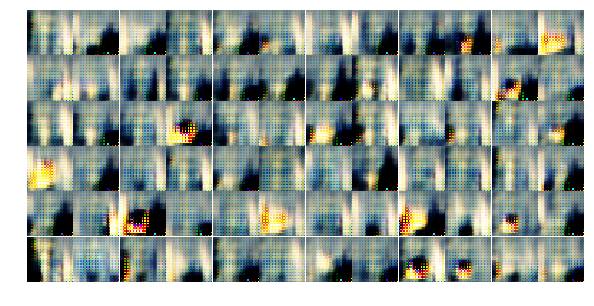

Epoch 1/28... Discriminator Loss: 0.0059... Generator Loss: 7.8889
Epoch 1/28... Discriminator Loss: 0.0086... Generator Loss: 5.5000
Epoch 1/28... Discriminator Loss: 1.3539... Generator Loss: 0.6684
Epoch 1/28... Discriminator Loss: 0.4073... Generator Loss: 1.6551
Epoch 1/28... Discriminator Loss: 1.3037... Generator Loss: 0.9305
Epoch 1/28... Discriminator Loss: 1.1693... Generator Loss: 0.6799
Epoch 1/28... Discriminator Loss: 0.3728... Generator Loss: 1.5109
Epoch 2/28... Discriminator Loss: 0.1605... Generator Loss: 2.4526
Epoch 2/28... Discriminator Loss: 0.0710... Generator Loss: 3.3329
Epoch 2/28... Discriminator Loss: 0.0204... Generator Loss: 4.8860


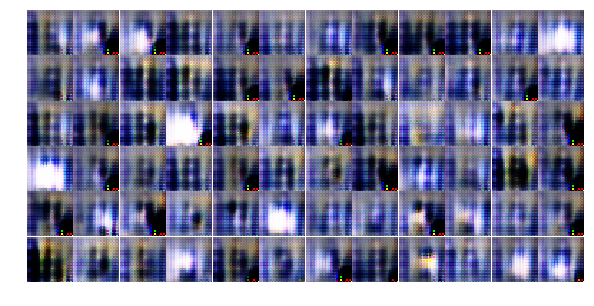

Epoch 2/28... Discriminator Loss: 0.0211... Generator Loss: 4.6503
Epoch 2/28... Discriminator Loss: 0.0101... Generator Loss: 5.7706
Epoch 2/28... Discriminator Loss: 0.0076... Generator Loss: 5.3983
Epoch 2/28... Discriminator Loss: 0.0038... Generator Loss: 6.2700
Epoch 2/28... Discriminator Loss: 0.0086... Generator Loss: 5.3441
Epoch 2/28... Discriminator Loss: 0.0091... Generator Loss: 4.8623
Epoch 2/28... Discriminator Loss: 0.0040... Generator Loss: 5.8340
Epoch 2/28... Discriminator Loss: 0.0114... Generator Loss: 4.7160
Epoch 2/28... Discriminator Loss: 0.0062... Generator Loss: 5.3022
Epoch 2/28... Discriminator Loss: 0.0071... Generator Loss: 5.4511


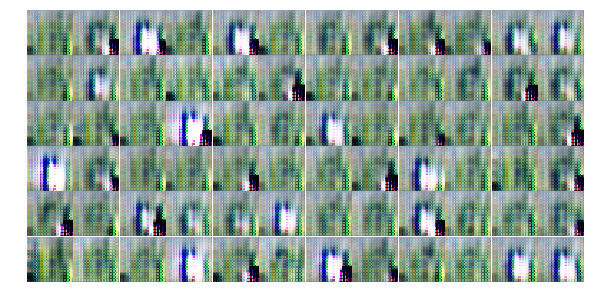

Epoch 2/28... Discriminator Loss: 0.0015... Generator Loss: 8.1996
Epoch 2/28... Discriminator Loss: 0.0013... Generator Loss: 7.4320
Epoch 2/28... Discriminator Loss: 0.0064... Generator Loss: 5.2524
Epoch 2/28... Discriminator Loss: 0.0087... Generator Loss: 5.5321
Epoch 2/28... Discriminator Loss: 0.0071... Generator Loss: 5.2604
Epoch 2/28... Discriminator Loss: 0.0054... Generator Loss: 8.6453
Epoch 2/28... Discriminator Loss: 0.0027... Generator Loss: 6.7806
Epoch 2/28... Discriminator Loss: 0.0016... Generator Loss: 9.0255
Epoch 2/28... Discriminator Loss: 0.0022... Generator Loss: 6.5799
Epoch 2/28... Discriminator Loss: 0.0051... Generator Loss: 5.6963


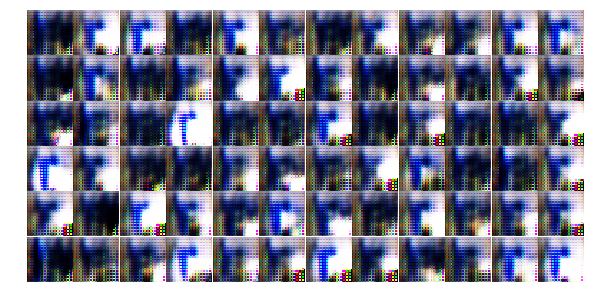

Epoch 2/28... Discriminator Loss: 0.0042... Generator Loss: 6.3307
Epoch 2/28... Discriminator Loss: 0.0024... Generator Loss: 11.8314
Epoch 2/28... Discriminator Loss: 0.0013... Generator Loss: 7.6888
Epoch 2/28... Discriminator Loss: 0.0018... Generator Loss: 7.0107
Epoch 2/28... Discriminator Loss: 0.0027... Generator Loss: 6.7011
Epoch 2/28... Discriminator Loss: 0.0029... Generator Loss: 6.4038
Epoch 2/28... Discriminator Loss: 0.0027... Generator Loss: 6.4088
Epoch 2/28... Discriminator Loss: 0.0026... Generator Loss: 6.3624
Epoch 2/28... Discriminator Loss: 0.0022... Generator Loss: 6.5184
Epoch 2/28... Discriminator Loss: 0.0031... Generator Loss: 6.4095


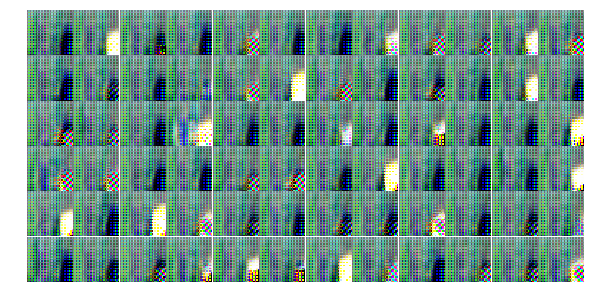

Epoch 2/28... Discriminator Loss: 0.0021... Generator Loss: 6.5576
Epoch 2/28... Discriminator Loss: 0.0018... Generator Loss: 6.6850
Epoch 2/28... Discriminator Loss: 0.0016... Generator Loss: 6.8275
Epoch 2/28... Discriminator Loss: 0.0013... Generator Loss: 7.0456
Epoch 2/28... Discriminator Loss: 0.0010... Generator Loss: 7.3730
Epoch 2/28... Discriminator Loss: 0.0010... Generator Loss: 7.3316
Epoch 2/28... Discriminator Loss: 0.0011... Generator Loss: 7.4506
Epoch 2/28... Discriminator Loss: 0.0009... Generator Loss: 7.4800
Epoch 2/28... Discriminator Loss: 0.0010... Generator Loss: 7.2544
Epoch 2/28... Discriminator Loss: 0.0010... Generator Loss: 7.2443


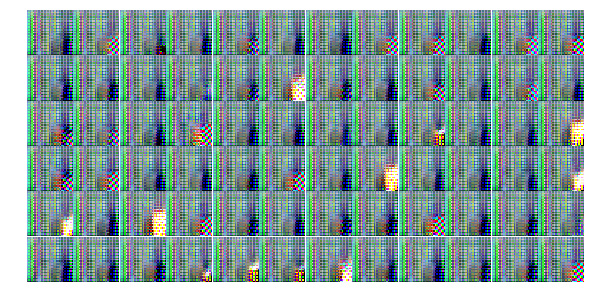

Epoch 2/28... Discriminator Loss: 0.0010... Generator Loss: 7.1964
Epoch 2/28... Discriminator Loss: 0.0009... Generator Loss: 7.3682
Epoch 2/28... Discriminator Loss: 0.0011... Generator Loss: 7.1136
Epoch 2/28... Discriminator Loss: 0.0011... Generator Loss: 7.0830
Epoch 2/28... Discriminator Loss: 0.0010... Generator Loss: 7.2182
Epoch 2/28... Discriminator Loss: 0.0010... Generator Loss: 7.2278
Epoch 2/28... Discriminator Loss: 0.0009... Generator Loss: 7.3314
Epoch 2/28... Discriminator Loss: 0.0010... Generator Loss: 7.1994
Epoch 2/28... Discriminator Loss: 0.0010... Generator Loss: 7.2409
Epoch 2/28... Discriminator Loss: 0.0010... Generator Loss: 7.2680


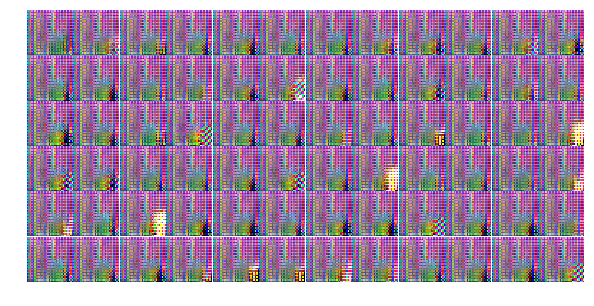

Epoch 2/28... Discriminator Loss: 0.0009... Generator Loss: 7.3152
Epoch 2/28... Discriminator Loss: 0.0008... Generator Loss: 7.4301
Epoch 2/28... Discriminator Loss: 0.0009... Generator Loss: 7.3417
Epoch 2/28... Discriminator Loss: 0.0008... Generator Loss: 7.5147
Epoch 3/28... Discriminator Loss: 0.0007... Generator Loss: 7.6261
Epoch 3/28... Discriminator Loss: 0.0006... Generator Loss: 7.8115
Epoch 3/28... Discriminator Loss: 0.0005... Generator Loss: 7.9200
Epoch 3/28... Discriminator Loss: 0.0005... Generator Loss: 7.9008
Epoch 3/28... Discriminator Loss: 0.0005... Generator Loss: 8.0462
Epoch 3/28... Discriminator Loss: 0.0006... Generator Loss: 7.7773


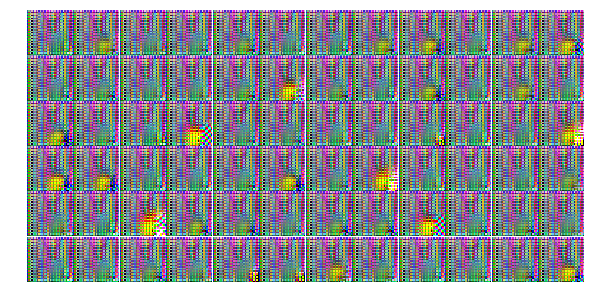

Epoch 3/28... Discriminator Loss: 0.0006... Generator Loss: 7.6555
Epoch 3/28... Discriminator Loss: 0.0005... Generator Loss: 7.7963
Epoch 3/28... Discriminator Loss: 0.0004... Generator Loss: 8.0264
Epoch 3/28... Discriminator Loss: 0.0005... Generator Loss: 7.9588
Epoch 3/28... Discriminator Loss: 0.0006... Generator Loss: 7.9399
Epoch 3/28... Discriminator Loss: 0.0004... Generator Loss: 7.9827
Epoch 3/28... Discriminator Loss: 0.0004... Generator Loss: 8.0298
Epoch 3/28... Discriminator Loss: 0.0004... Generator Loss: 8.0228
Epoch 3/28... Discriminator Loss: 0.0004... Generator Loss: 8.1817
Epoch 3/28... Discriminator Loss: 0.0006... Generator Loss: 7.8178


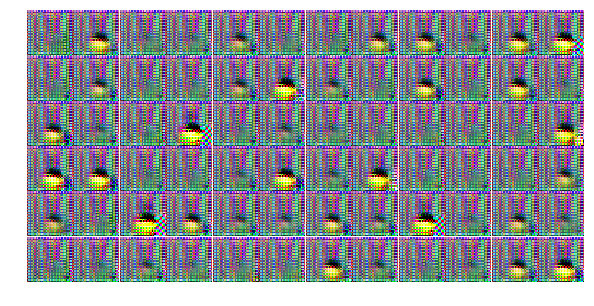

Epoch 3/28... Discriminator Loss: 0.0006... Generator Loss: 7.7596
Epoch 3/28... Discriminator Loss: 0.0006... Generator Loss: 7.8168
Epoch 3/28... Discriminator Loss: 0.0006... Generator Loss: 7.7933
Epoch 3/28... Discriminator Loss: 0.0006... Generator Loss: 7.7043
Epoch 3/28... Discriminator Loss: 0.0006... Generator Loss: 7.7405
Epoch 3/28... Discriminator Loss: 0.0007... Generator Loss: 7.7375
Epoch 3/28... Discriminator Loss: 0.0006... Generator Loss: 7.6386
Epoch 3/28... Discriminator Loss: 0.0006... Generator Loss: 7.7613
Epoch 3/28... Discriminator Loss: 0.0005... Generator Loss: 7.7898
Epoch 3/28... Discriminator Loss: 0.0005... Generator Loss: 8.0397


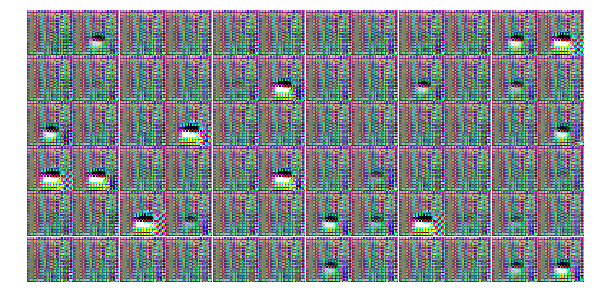

Epoch 3/28... Discriminator Loss: 0.0005... Generator Loss: 7.9131
Epoch 3/28... Discriminator Loss: 0.0005... Generator Loss: 7.9359
Epoch 3/28... Discriminator Loss: 0.0004... Generator Loss: 8.0603
Epoch 3/28... Discriminator Loss: 0.0006... Generator Loss: 7.9156
Epoch 3/28... Discriminator Loss: 0.0002... Generator Loss: 9.2164
Epoch 3/28... Discriminator Loss: 0.0003... Generator Loss: 8.3974
Epoch 3/28... Discriminator Loss: 0.0001... Generator Loss: 10.3351
Epoch 3/28... Discriminator Loss: 0.0001... Generator Loss: 9.4259
Epoch 3/28... Discriminator Loss: 0.0050... Generator Loss: 5.4528
Epoch 3/28... Discriminator Loss: 0.0011... Generator Loss: 7.0700


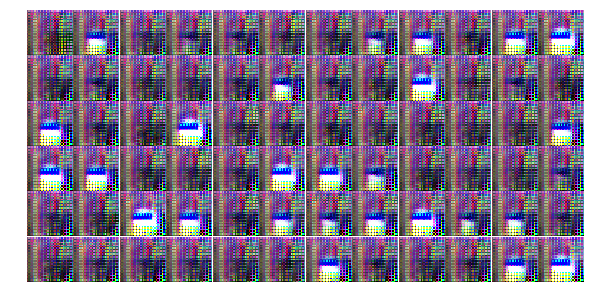

Epoch 3/28... Discriminator Loss: 0.0001... Generator Loss: 10.3845
Epoch 3/28... Discriminator Loss: 0.0005... Generator Loss: 11.3896
Epoch 3/28... Discriminator Loss: 0.0003... Generator Loss: 11.7382
Epoch 3/28... Discriminator Loss: 0.0026... Generator Loss: 14.3481
Epoch 3/28... Discriminator Loss: 0.0002... Generator Loss: 9.3293
Epoch 3/28... Discriminator Loss: 2.4954... Generator Loss: 0.8680
Epoch 3/28... Discriminator Loss: 2.7275... Generator Loss: 1.7419
Epoch 3/28... Discriminator Loss: 1.0244... Generator Loss: 1.3423
Epoch 3/28... Discriminator Loss: 2.1192... Generator Loss: 1.3522
Epoch 3/28... Discriminator Loss: 0.7017... Generator Loss: 1.4939


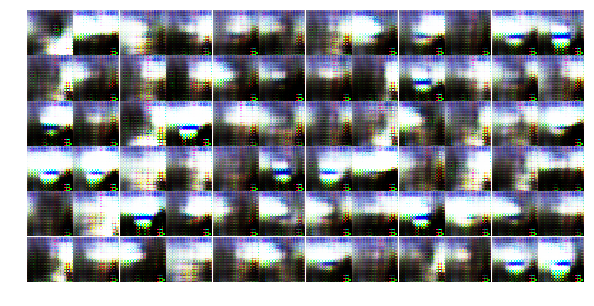

Epoch 3/28... Discriminator Loss: 1.0532... Generator Loss: 0.6438
Epoch 3/28... Discriminator Loss: 1.1157... Generator Loss: 0.6763
Epoch 3/28... Discriminator Loss: 2.7358... Generator Loss: 3.0007
Epoch 3/28... Discriminator Loss: 0.6089... Generator Loss: 2.3502
Epoch 3/28... Discriminator Loss: 1.3133... Generator Loss: 0.6816
Epoch 3/28... Discriminator Loss: 1.0609... Generator Loss: 1.0533
Epoch 3/28... Discriminator Loss: 0.8861... Generator Loss: 0.9940
Epoch 3/28... Discriminator Loss: 0.9584... Generator Loss: 1.3923
Epoch 3/28... Discriminator Loss: 2.1468... Generator Loss: 2.9404
Epoch 3/28... Discriminator Loss: 1.3204... Generator Loss: 0.9635


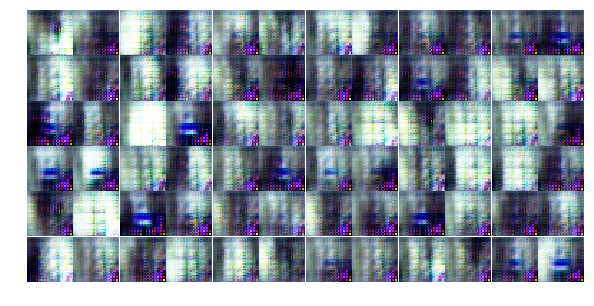

Epoch 3/28... Discriminator Loss: 1.3236... Generator Loss: 0.7132
Epoch 4/28... Discriminator Loss: 1.7086... Generator Loss: 0.2834
Epoch 4/28... Discriminator Loss: 1.1458... Generator Loss: 1.3055
Epoch 4/28... Discriminator Loss: 1.4437... Generator Loss: 0.9606
Epoch 4/28... Discriminator Loss: 1.0410... Generator Loss: 0.7853
Epoch 4/28... Discriminator Loss: 1.4483... Generator Loss: 0.9964
Epoch 4/28... Discriminator Loss: 1.1025... Generator Loss: 0.6897
Epoch 4/28... Discriminator Loss: 0.9943... Generator Loss: 1.2916
Epoch 4/28... Discriminator Loss: 1.2536... Generator Loss: 0.7894
Epoch 4/28... Discriminator Loss: 1.4186... Generator Loss: 0.3997


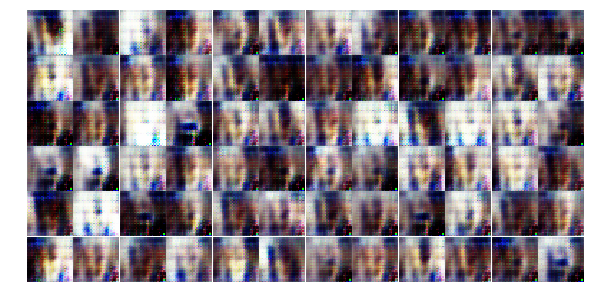

Epoch 4/28... Discriminator Loss: 1.1661... Generator Loss: 1.3628
Epoch 4/28... Discriminator Loss: 1.6103... Generator Loss: 2.1039
Epoch 4/28... Discriminator Loss: 1.3424... Generator Loss: 0.5786
Epoch 4/28... Discriminator Loss: 1.2810... Generator Loss: 0.9571
Epoch 4/28... Discriminator Loss: 1.5808... Generator Loss: 0.6466
Epoch 4/28... Discriminator Loss: 1.1754... Generator Loss: 0.9638
Epoch 4/28... Discriminator Loss: 1.0149... Generator Loss: 1.1844
Epoch 4/28... Discriminator Loss: 1.3067... Generator Loss: 1.0054
Epoch 4/28... Discriminator Loss: 1.2958... Generator Loss: 1.2960
Epoch 4/28... Discriminator Loss: 1.6791... Generator Loss: 1.8094


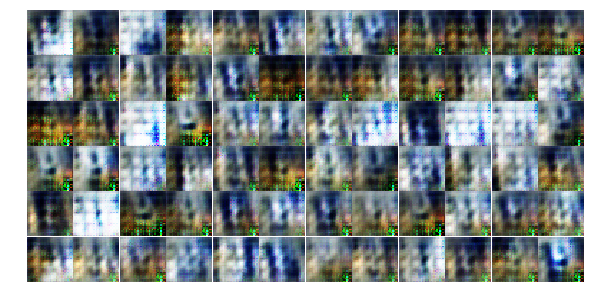

Epoch 4/28... Discriminator Loss: 1.1649... Generator Loss: 1.1156
Epoch 4/28... Discriminator Loss: 2.4102... Generator Loss: 3.1368
Epoch 4/28... Discriminator Loss: 1.3596... Generator Loss: 0.5829
Epoch 4/28... Discriminator Loss: 1.4437... Generator Loss: 1.5615
Epoch 4/28... Discriminator Loss: 0.7822... Generator Loss: 1.2434
Epoch 4/28... Discriminator Loss: 0.9234... Generator Loss: 1.1214
Epoch 4/28... Discriminator Loss: 1.2979... Generator Loss: 0.5791
Epoch 4/28... Discriminator Loss: 1.0188... Generator Loss: 0.9030
Epoch 4/28... Discriminator Loss: 1.0843... Generator Loss: 0.8686
Epoch 4/28... Discriminator Loss: 1.3199... Generator Loss: 0.8289


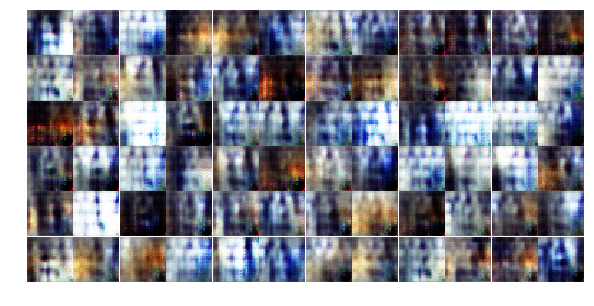

Epoch 4/28... Discriminator Loss: 1.2437... Generator Loss: 0.8283
Epoch 4/28... Discriminator Loss: 1.1530... Generator Loss: 1.0735
Epoch 4/28... Discriminator Loss: 1.0317... Generator Loss: 1.4121
Epoch 4/28... Discriminator Loss: 0.9307... Generator Loss: 0.7779
Epoch 4/28... Discriminator Loss: 1.1109... Generator Loss: 0.9290
Epoch 4/28... Discriminator Loss: 1.3730... Generator Loss: 0.9213
Epoch 4/28... Discriminator Loss: 1.4487... Generator Loss: 0.4616
Epoch 4/28... Discriminator Loss: 1.3270... Generator Loss: 0.4442
Epoch 4/28... Discriminator Loss: 0.9240... Generator Loss: 0.8419
Epoch 4/28... Discriminator Loss: 1.4800... Generator Loss: 0.3720


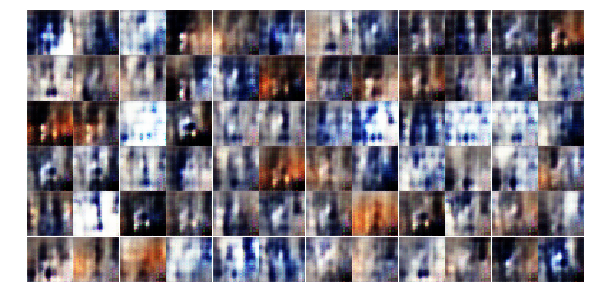

Epoch 4/28... Discriminator Loss: 1.2001... Generator Loss: 0.8481
Epoch 4/28... Discriminator Loss: 1.2951... Generator Loss: 0.5596
Epoch 4/28... Discriminator Loss: 1.4495... Generator Loss: 0.6092
Epoch 4/28... Discriminator Loss: 1.5835... Generator Loss: 0.3573
Epoch 4/28... Discriminator Loss: 1.1257... Generator Loss: 0.8327
Epoch 4/28... Discriminator Loss: 1.0107... Generator Loss: 0.8852
Epoch 4/28... Discriminator Loss: 1.0966... Generator Loss: 1.0871
Epoch 4/28... Discriminator Loss: 1.6440... Generator Loss: 1.7439
Epoch 4/28... Discriminator Loss: 1.2115... Generator Loss: 0.8567
Epoch 4/28... Discriminator Loss: 1.1448... Generator Loss: 0.5935


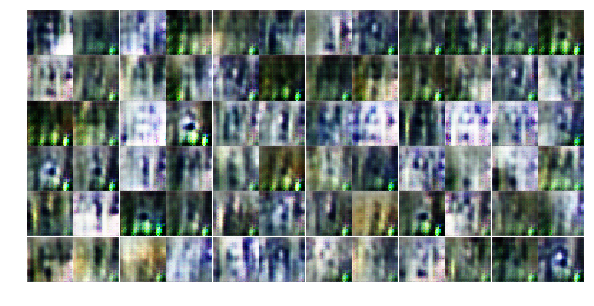

Epoch 4/28... Discriminator Loss: 1.2113... Generator Loss: 1.0429
Epoch 4/28... Discriminator Loss: 1.3392... Generator Loss: 0.9581
Epoch 4/28... Discriminator Loss: 1.1987... Generator Loss: 0.8795
Epoch 4/28... Discriminator Loss: 0.5749... Generator Loss: 1.6435
Epoch 4/28... Discriminator Loss: 1.1987... Generator Loss: 1.1911
Epoch 4/28... Discriminator Loss: 1.1264... Generator Loss: 0.9372
Epoch 4/28... Discriminator Loss: 0.9595... Generator Loss: 1.0498
Epoch 4/28... Discriminator Loss: 1.0370... Generator Loss: 0.9775
Epoch 4/28... Discriminator Loss: 1.1565... Generator Loss: 1.8417
Epoch 5/28... Discriminator Loss: 1.5002... Generator Loss: 0.3629


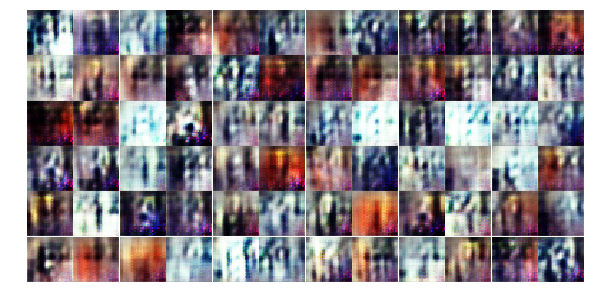

Epoch 5/28... Discriminator Loss: 1.1066... Generator Loss: 0.7418
Epoch 5/28... Discriminator Loss: 1.1170... Generator Loss: 0.8728
Epoch 5/28... Discriminator Loss: 1.0903... Generator Loss: 1.4023
Epoch 5/28... Discriminator Loss: 0.8198... Generator Loss: 1.7857
Epoch 5/28... Discriminator Loss: 1.2512... Generator Loss: 0.5058
Epoch 5/28... Discriminator Loss: 1.7443... Generator Loss: 0.8222
Epoch 5/28... Discriminator Loss: 1.4697... Generator Loss: 0.4249
Epoch 5/28... Discriminator Loss: 1.1590... Generator Loss: 0.7926
Epoch 5/28... Discriminator Loss: 1.1991... Generator Loss: 0.7405
Epoch 5/28... Discriminator Loss: 1.4706... Generator Loss: 0.5566


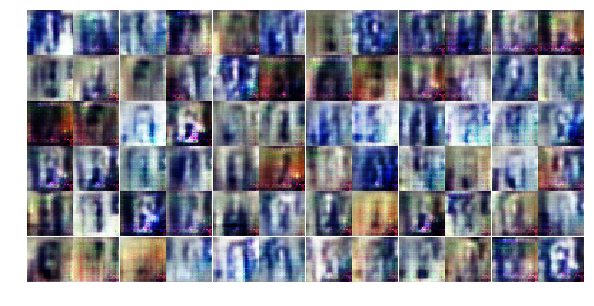

Epoch 5/28... Discriminator Loss: 1.4959... Generator Loss: 0.4395
Epoch 5/28... Discriminator Loss: 1.3255... Generator Loss: 0.6822
Epoch 5/28... Discriminator Loss: 1.1676... Generator Loss: 0.9707
Epoch 5/28... Discriminator Loss: 1.0966... Generator Loss: 0.9414
Epoch 5/28... Discriminator Loss: 1.0730... Generator Loss: 0.9981
Epoch 5/28... Discriminator Loss: 1.0933... Generator Loss: 0.9321
Epoch 5/28... Discriminator Loss: 1.4320... Generator Loss: 0.5668
Epoch 5/28... Discriminator Loss: 1.2071... Generator Loss: 0.7896
Epoch 5/28... Discriminator Loss: 1.1133... Generator Loss: 0.8195
Epoch 5/28... Discriminator Loss: 0.9272... Generator Loss: 1.1649


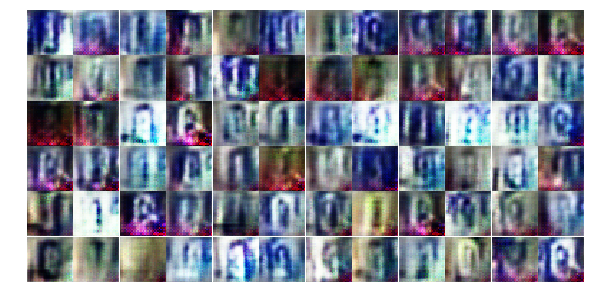

Epoch 5/28... Discriminator Loss: 1.1990... Generator Loss: 1.0723
Epoch 5/28... Discriminator Loss: 1.4315... Generator Loss: 0.8514
Epoch 5/28... Discriminator Loss: 0.9758... Generator Loss: 0.9386
Epoch 5/28... Discriminator Loss: 1.5750... Generator Loss: 1.4970
Epoch 5/28... Discriminator Loss: 1.3938... Generator Loss: 0.8817
Epoch 5/28... Discriminator Loss: 1.1427... Generator Loss: 0.7125
Epoch 5/28... Discriminator Loss: 1.4307... Generator Loss: 0.8292
Epoch 5/28... Discriminator Loss: 1.2596... Generator Loss: 0.7914
Epoch 5/28... Discriminator Loss: 1.2443... Generator Loss: 0.7057
Epoch 5/28... Discriminator Loss: 1.1412... Generator Loss: 1.0878


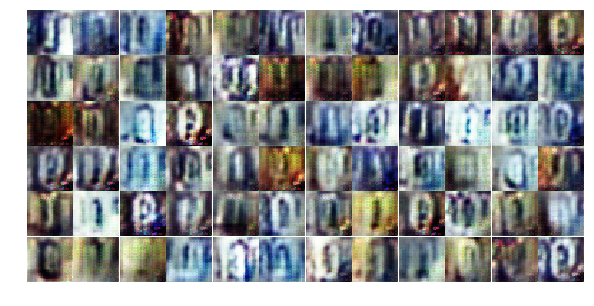

Epoch 5/28... Discriminator Loss: 1.1369... Generator Loss: 0.9408
Epoch 5/28... Discriminator Loss: 1.1532... Generator Loss: 0.7114
Epoch 5/28... Discriminator Loss: 1.3118... Generator Loss: 0.5071
Epoch 5/28... Discriminator Loss: 1.1817... Generator Loss: 0.7959
Epoch 5/28... Discriminator Loss: 1.0036... Generator Loss: 0.8819
Epoch 5/28... Discriminator Loss: 0.9875... Generator Loss: 1.0518
Epoch 5/28... Discriminator Loss: 1.0777... Generator Loss: 0.8424
Epoch 5/28... Discriminator Loss: 0.5743... Generator Loss: 1.2904
Epoch 5/28... Discriminator Loss: 1.3053... Generator Loss: 1.6562
Epoch 5/28... Discriminator Loss: 1.4541... Generator Loss: 0.5198


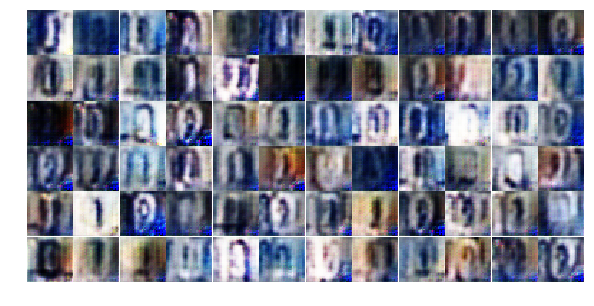

Epoch 5/28... Discriminator Loss: 1.1274... Generator Loss: 0.9364
Epoch 5/28... Discriminator Loss: 1.2314... Generator Loss: 0.8736
Epoch 5/28... Discriminator Loss: 1.3669... Generator Loss: 0.6271
Epoch 5/28... Discriminator Loss: 0.9302... Generator Loss: 0.8394
Epoch 5/28... Discriminator Loss: 1.3120... Generator Loss: 0.5734
Epoch 5/28... Discriminator Loss: 1.2922... Generator Loss: 0.7341
Epoch 5/28... Discriminator Loss: 1.1731... Generator Loss: 0.8982
Epoch 5/28... Discriminator Loss: 1.2612... Generator Loss: 0.8367
Epoch 5/28... Discriminator Loss: 1.1997... Generator Loss: 0.7698
Epoch 5/28... Discriminator Loss: 1.1919... Generator Loss: 0.7058


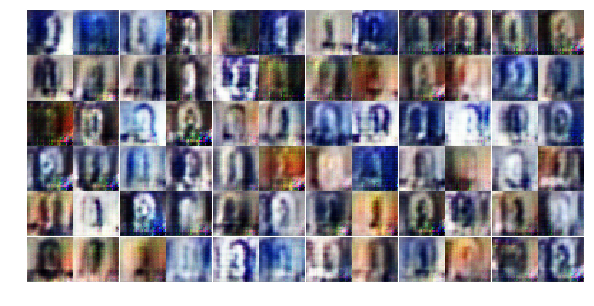

Epoch 5/28... Discriminator Loss: 1.1984... Generator Loss: 1.1949
Epoch 5/28... Discriminator Loss: 1.2492... Generator Loss: 0.4376
Epoch 5/28... Discriminator Loss: 1.0458... Generator Loss: 0.9500
Epoch 5/28... Discriminator Loss: 1.2240... Generator Loss: 0.5141
Epoch 5/28... Discriminator Loss: 1.3495... Generator Loss: 0.5668
Epoch 5/28... Discriminator Loss: 1.4329... Generator Loss: 0.5826
Epoch 6/28... Discriminator Loss: 1.2359... Generator Loss: 0.6574
Epoch 6/28... Discriminator Loss: 1.4838... Generator Loss: 0.6138
Epoch 6/28... Discriminator Loss: 1.3605... Generator Loss: 0.7078
Epoch 6/28... Discriminator Loss: 1.2764... Generator Loss: 0.4433


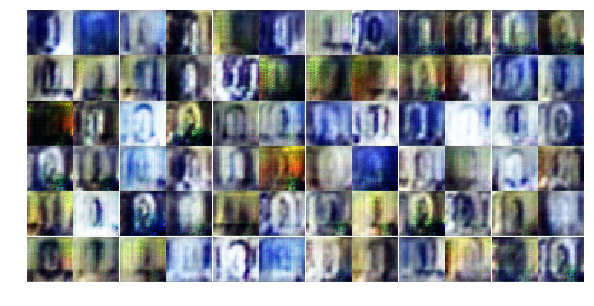

Epoch 6/28... Discriminator Loss: 1.1750... Generator Loss: 0.9593
Epoch 6/28... Discriminator Loss: 1.0583... Generator Loss: 1.9831
Epoch 6/28... Discriminator Loss: 1.4157... Generator Loss: 0.8694
Epoch 6/28... Discriminator Loss: 0.9859... Generator Loss: 0.9519
Epoch 6/28... Discriminator Loss: 1.1595... Generator Loss: 0.7999
Epoch 6/28... Discriminator Loss: 1.4246... Generator Loss: 0.7656
Epoch 6/28... Discriminator Loss: 1.1814... Generator Loss: 0.8036
Epoch 6/28... Discriminator Loss: 1.3460... Generator Loss: 0.5430
Epoch 6/28... Discriminator Loss: 1.7692... Generator Loss: 1.5973
Epoch 6/28... Discriminator Loss: 1.1673... Generator Loss: 0.8156


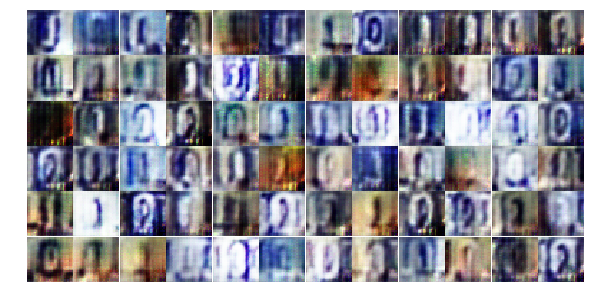

Epoch 6/28... Discriminator Loss: 1.1459... Generator Loss: 0.9011
Epoch 6/28... Discriminator Loss: 1.3015... Generator Loss: 0.7669
Epoch 6/28... Discriminator Loss: 0.7655... Generator Loss: 1.2209
Epoch 6/28... Discriminator Loss: 1.0713... Generator Loss: 1.0169
Epoch 6/28... Discriminator Loss: 1.2366... Generator Loss: 0.6998
Epoch 6/28... Discriminator Loss: 1.4987... Generator Loss: 0.7274
Epoch 6/28... Discriminator Loss: 1.0924... Generator Loss: 0.8935
Epoch 6/28... Discriminator Loss: 0.8919... Generator Loss: 0.8024
Epoch 6/28... Discriminator Loss: 1.8026... Generator Loss: 2.2059
Epoch 6/28... Discriminator Loss: 1.0289... Generator Loss: 0.6510


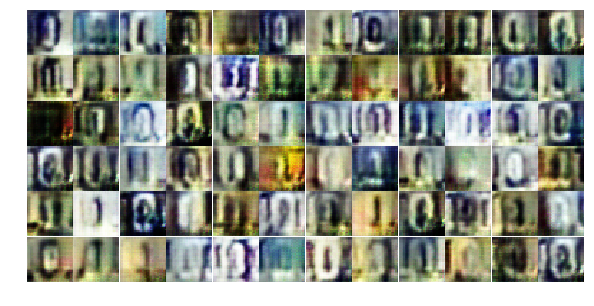

Epoch 6/28... Discriminator Loss: 1.0108... Generator Loss: 1.2682
Epoch 6/28... Discriminator Loss: 1.3777... Generator Loss: 0.9285
Epoch 6/28... Discriminator Loss: 1.3960... Generator Loss: 0.8415
Epoch 6/28... Discriminator Loss: 1.3392... Generator Loss: 0.7285
Epoch 6/28... Discriminator Loss: 1.1503... Generator Loss: 0.9517
Epoch 6/28... Discriminator Loss: 1.3265... Generator Loss: 0.6876
Epoch 6/28... Discriminator Loss: 1.2177... Generator Loss: 0.6973
Epoch 6/28... Discriminator Loss: 1.0402... Generator Loss: 1.1741
Epoch 6/28... Discriminator Loss: 1.4475... Generator Loss: 0.3703
Epoch 6/28... Discriminator Loss: 1.1539... Generator Loss: 0.8206


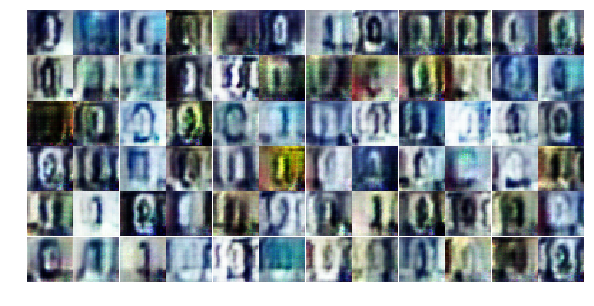

Epoch 6/28... Discriminator Loss: 1.5858... Generator Loss: 0.8358
Epoch 6/28... Discriminator Loss: 1.3885... Generator Loss: 0.8529
Epoch 6/28... Discriminator Loss: 1.1922... Generator Loss: 0.8459
Epoch 6/28... Discriminator Loss: 1.2487... Generator Loss: 0.7202
Epoch 6/28... Discriminator Loss: 1.2714... Generator Loss: 0.6878
Epoch 6/28... Discriminator Loss: 1.3185... Generator Loss: 0.8867
Epoch 6/28... Discriminator Loss: 1.2519... Generator Loss: 0.8900
Epoch 6/28... Discriminator Loss: 1.0921... Generator Loss: 1.0587
Epoch 6/28... Discriminator Loss: 1.2574... Generator Loss: 0.5498
Epoch 6/28... Discriminator Loss: 1.4039... Generator Loss: 0.7648


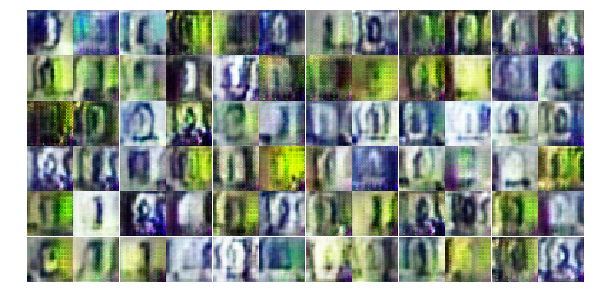

Epoch 6/28... Discriminator Loss: 1.3544... Generator Loss: 0.5921
Epoch 6/28... Discriminator Loss: 1.0702... Generator Loss: 0.9294
Epoch 6/28... Discriminator Loss: 1.2249... Generator Loss: 0.8301
Epoch 6/28... Discriminator Loss: 1.4395... Generator Loss: 1.0056
Epoch 6/28... Discriminator Loss: 1.2726... Generator Loss: 0.8175
Epoch 6/28... Discriminator Loss: 1.0453... Generator Loss: 1.6197
Epoch 6/28... Discriminator Loss: 1.2381... Generator Loss: 1.4307
Epoch 6/28... Discriminator Loss: 1.1716... Generator Loss: 0.7815
Epoch 6/28... Discriminator Loss: 1.2146... Generator Loss: 0.8251
Epoch 6/28... Discriminator Loss: 1.3953... Generator Loss: 0.8781


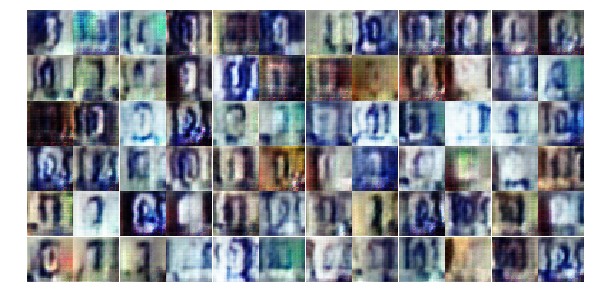

Epoch 6/28... Discriminator Loss: 1.0503... Generator Loss: 0.6881
Epoch 6/28... Discriminator Loss: 1.2837... Generator Loss: 0.5720
Epoch 6/28... Discriminator Loss: 1.1745... Generator Loss: 1.2642
Epoch 7/28... Discriminator Loss: 1.3137... Generator Loss: 0.6544
Epoch 7/28... Discriminator Loss: 1.0462... Generator Loss: 1.1964
Epoch 7/28... Discriminator Loss: 1.1661... Generator Loss: 0.8313
Epoch 7/28... Discriminator Loss: 1.1100... Generator Loss: 0.8453
Epoch 7/28... Discriminator Loss: 1.1313... Generator Loss: 1.3933
Epoch 7/28... Discriminator Loss: 1.4393... Generator Loss: 0.3870
Epoch 7/28... Discriminator Loss: 1.2455... Generator Loss: 0.8024


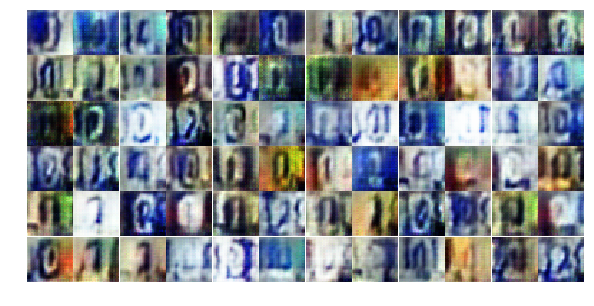

Epoch 7/28... Discriminator Loss: 1.1156... Generator Loss: 0.8677
Epoch 7/28... Discriminator Loss: 1.4598... Generator Loss: 0.7144
Epoch 7/28... Discriminator Loss: 1.1830... Generator Loss: 0.7926
Epoch 7/28... Discriminator Loss: 1.1862... Generator Loss: 0.8331
Epoch 7/28... Discriminator Loss: 1.1673... Generator Loss: 0.7223
Epoch 7/28... Discriminator Loss: 1.1129... Generator Loss: 0.7506
Epoch 7/28... Discriminator Loss: 1.3897... Generator Loss: 0.8205
Epoch 7/28... Discriminator Loss: 1.5123... Generator Loss: 1.5187
Epoch 7/28... Discriminator Loss: 1.1846... Generator Loss: 1.1671
Epoch 7/28... Discriminator Loss: 1.0252... Generator Loss: 0.8366


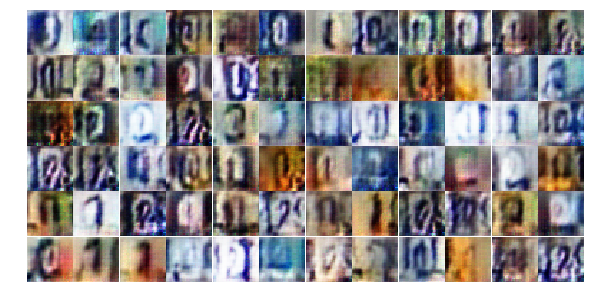

Epoch 7/28... Discriminator Loss: 1.2281... Generator Loss: 0.7946
Epoch 7/28... Discriminator Loss: 1.2087... Generator Loss: 0.8170
Epoch 7/28... Discriminator Loss: 0.8722... Generator Loss: 0.8863
Epoch 7/28... Discriminator Loss: 1.4092... Generator Loss: 1.0652
Epoch 7/28... Discriminator Loss: 1.0968... Generator Loss: 1.0131
Epoch 7/28... Discriminator Loss: 1.0169... Generator Loss: 0.5417
Epoch 7/28... Discriminator Loss: 1.1087... Generator Loss: 1.0924
Epoch 7/28... Discriminator Loss: 1.2066... Generator Loss: 0.6853
Epoch 7/28... Discriminator Loss: 1.2281... Generator Loss: 0.7639
Epoch 7/28... Discriminator Loss: 1.1148... Generator Loss: 1.0689


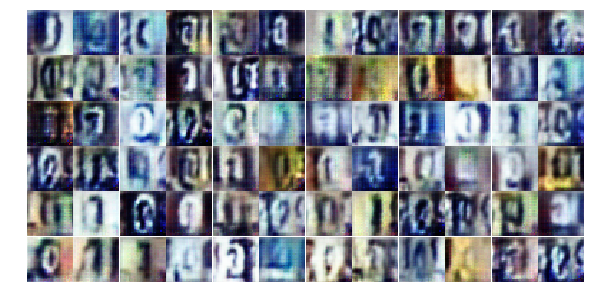

Epoch 7/28... Discriminator Loss: 1.3021... Generator Loss: 0.7283
Epoch 7/28... Discriminator Loss: 1.1804... Generator Loss: 0.7742
Epoch 7/28... Discriminator Loss: 1.0443... Generator Loss: 1.4988
Epoch 7/28... Discriminator Loss: 1.3018... Generator Loss: 0.8291
Epoch 7/28... Discriminator Loss: 1.3642... Generator Loss: 0.5649
Epoch 7/28... Discriminator Loss: 1.3837... Generator Loss: 0.9841
Epoch 7/28... Discriminator Loss: 1.2953... Generator Loss: 0.6475
Epoch 7/28... Discriminator Loss: 1.4353... Generator Loss: 0.8285
Epoch 7/28... Discriminator Loss: 1.2931... Generator Loss: 0.8623
Epoch 7/28... Discriminator Loss: 1.2972... Generator Loss: 0.7312


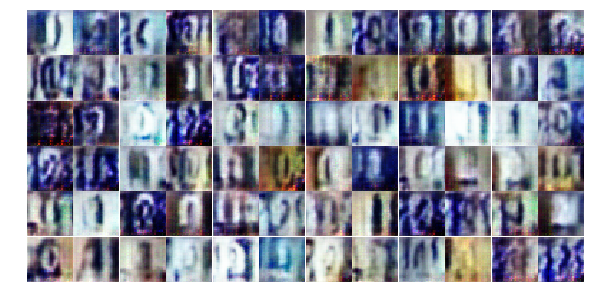

Epoch 7/28... Discriminator Loss: 1.0837... Generator Loss: 0.8744
Epoch 7/28... Discriminator Loss: 1.3024... Generator Loss: 0.6693
Epoch 7/28... Discriminator Loss: 1.2796... Generator Loss: 0.7243
Epoch 7/28... Discriminator Loss: 1.1959... Generator Loss: 0.9004
Epoch 7/28... Discriminator Loss: 1.2868... Generator Loss: 1.2167
Epoch 7/28... Discriminator Loss: 1.1819... Generator Loss: 0.8707
Epoch 7/28... Discriminator Loss: 1.2954... Generator Loss: 1.1478
Epoch 7/28... Discriminator Loss: 1.3319... Generator Loss: 0.8148
Epoch 7/28... Discriminator Loss: 1.1517... Generator Loss: 0.8148
Epoch 7/28... Discriminator Loss: 1.2406... Generator Loss: 0.7835


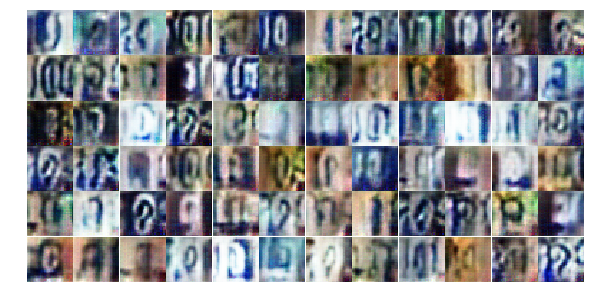

Epoch 7/28... Discriminator Loss: 1.1252... Generator Loss: 0.9241
Epoch 7/28... Discriminator Loss: 1.1641... Generator Loss: 0.7735
Epoch 7/28... Discriminator Loss: 1.1153... Generator Loss: 1.1783
Epoch 7/28... Discriminator Loss: 1.0470... Generator Loss: 1.0657
Epoch 7/28... Discriminator Loss: 1.1054... Generator Loss: 0.9629
Epoch 7/28... Discriminator Loss: 1.5674... Generator Loss: 0.4613
Epoch 7/28... Discriminator Loss: 1.2224... Generator Loss: 0.7559
Epoch 7/28... Discriminator Loss: 1.1811... Generator Loss: 0.6417
Epoch 7/28... Discriminator Loss: 1.4310... Generator Loss: 0.5374
Epoch 7/28... Discriminator Loss: 1.2172... Generator Loss: 0.7958


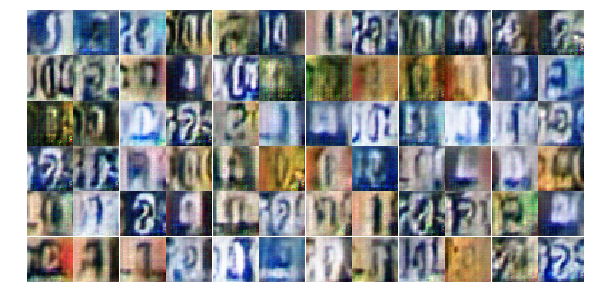

Epoch 7/28... Discriminator Loss: 1.2585... Generator Loss: 0.7851
Epoch 8/28... Discriminator Loss: 1.1827... Generator Loss: 0.8029
Epoch 8/28... Discriminator Loss: 1.2582... Generator Loss: 0.7131
Epoch 8/28... Discriminator Loss: 1.3184... Generator Loss: 0.6582
Epoch 8/28... Discriminator Loss: 1.1371... Generator Loss: 0.8314
Epoch 8/28... Discriminator Loss: 1.2738... Generator Loss: 0.7135
Epoch 8/28... Discriminator Loss: 1.2147... Generator Loss: 0.9555
Epoch 8/28... Discriminator Loss: 1.1399... Generator Loss: 0.9467
Epoch 8/28... Discriminator Loss: 1.3344... Generator Loss: 0.7001
Epoch 8/28... Discriminator Loss: 1.1430... Generator Loss: 0.8373


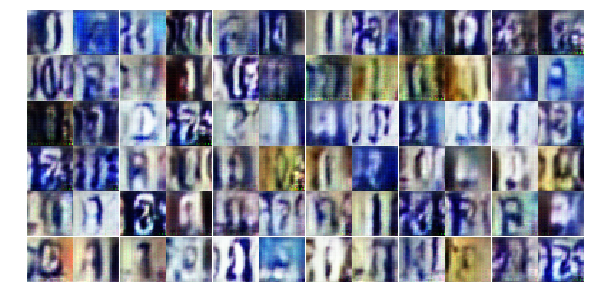

Epoch 8/28... Discriminator Loss: 1.2034... Generator Loss: 0.9174
Epoch 8/28... Discriminator Loss: 1.1253... Generator Loss: 0.8339
Epoch 8/28... Discriminator Loss: 1.4405... Generator Loss: 0.6014
Epoch 8/28... Discriminator Loss: 1.4360... Generator Loss: 0.5292
Epoch 8/28... Discriminator Loss: 1.5638... Generator Loss: 0.4087
Epoch 8/28... Discriminator Loss: 1.0208... Generator Loss: 1.2689
Epoch 8/28... Discriminator Loss: 1.5043... Generator Loss: 1.5335
Epoch 8/28... Discriminator Loss: 1.1646... Generator Loss: 0.8952
Epoch 8/28... Discriminator Loss: 1.1746... Generator Loss: 0.8643
Epoch 8/28... Discriminator Loss: 1.5036... Generator Loss: 0.7658


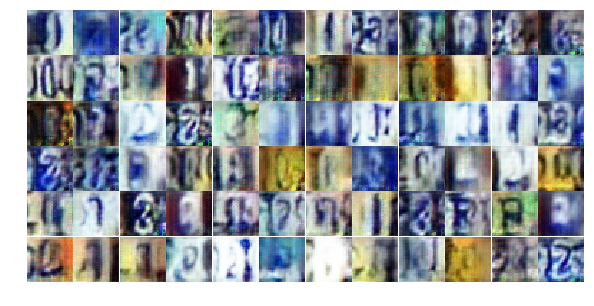

Epoch 8/28... Discriminator Loss: 1.1935... Generator Loss: 0.7930
Epoch 8/28... Discriminator Loss: 1.2217... Generator Loss: 0.6256
Epoch 8/28... Discriminator Loss: 1.3579... Generator Loss: 0.8371
Epoch 8/28... Discriminator Loss: 1.2484... Generator Loss: 0.7501
Epoch 8/28... Discriminator Loss: 1.2383... Generator Loss: 0.8007
Epoch 8/28... Discriminator Loss: 1.1334... Generator Loss: 0.7922
Epoch 8/28... Discriminator Loss: 1.2899... Generator Loss: 1.0997
Epoch 8/28... Discriminator Loss: 1.1833... Generator Loss: 0.6846
Epoch 8/28... Discriminator Loss: 1.4464... Generator Loss: 1.0498
Epoch 8/28... Discriminator Loss: 1.3615... Generator Loss: 0.8563


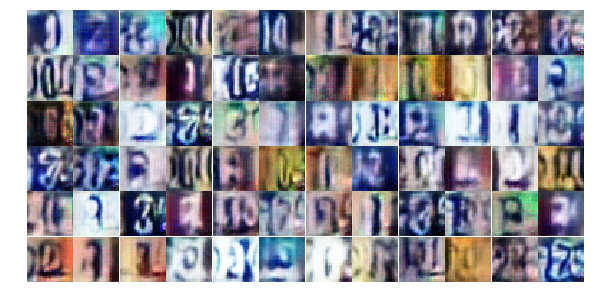

Epoch 8/28... Discriminator Loss: 1.2358... Generator Loss: 0.9710
Epoch 8/28... Discriminator Loss: 1.2158... Generator Loss: 0.7279
Epoch 8/28... Discriminator Loss: 1.2744... Generator Loss: 0.7342
Epoch 8/28... Discriminator Loss: 1.3164... Generator Loss: 0.9021
Epoch 8/28... Discriminator Loss: 1.2297... Generator Loss: 0.6754
Epoch 8/28... Discriminator Loss: 1.0694... Generator Loss: 1.0409
Epoch 8/28... Discriminator Loss: 1.2095... Generator Loss: 0.6262
Epoch 8/28... Discriminator Loss: 1.5394... Generator Loss: 0.7727
Epoch 8/28... Discriminator Loss: 1.2525... Generator Loss: 0.7429
Epoch 8/28... Discriminator Loss: 1.1224... Generator Loss: 0.8499


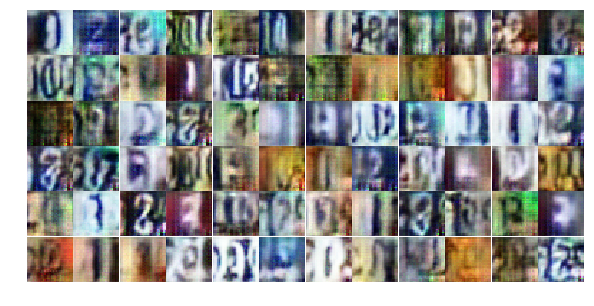

Epoch 8/28... Discriminator Loss: 1.2097... Generator Loss: 0.8400
Epoch 8/28... Discriminator Loss: 1.3207... Generator Loss: 0.9003
Epoch 8/28... Discriminator Loss: 1.2518... Generator Loss: 0.6713
Epoch 8/28... Discriminator Loss: 1.2325... Generator Loss: 0.9664
Epoch 8/28... Discriminator Loss: 1.3321... Generator Loss: 0.7895
Epoch 8/28... Discriminator Loss: 1.1944... Generator Loss: 0.7403
Epoch 8/28... Discriminator Loss: 1.0623... Generator Loss: 1.0699
Epoch 8/28... Discriminator Loss: 1.2418... Generator Loss: 0.9487
Epoch 8/28... Discriminator Loss: 1.1419... Generator Loss: 0.9111
Epoch 8/28... Discriminator Loss: 1.3193... Generator Loss: 0.7502


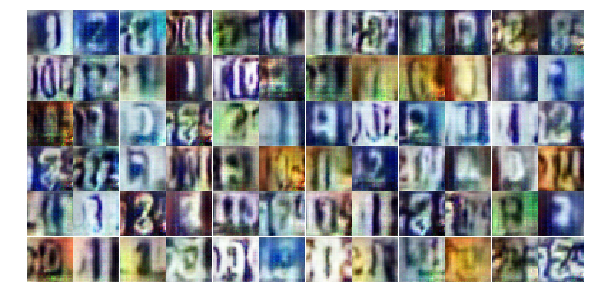

Epoch 8/28... Discriminator Loss: 1.2173... Generator Loss: 0.8106
Epoch 8/28... Discriminator Loss: 1.2342... Generator Loss: 0.5622
Epoch 8/28... Discriminator Loss: 1.2077... Generator Loss: 1.1180
Epoch 8/28... Discriminator Loss: 1.2558... Generator Loss: 1.0480
Epoch 8/28... Discriminator Loss: 1.2217... Generator Loss: 1.0496
Epoch 8/28... Discriminator Loss: 1.1358... Generator Loss: 0.8013
Epoch 8/28... Discriminator Loss: 1.0892... Generator Loss: 0.8786
Epoch 8/28... Discriminator Loss: 1.2130... Generator Loss: 1.0516
Epoch 9/28... Discriminator Loss: 1.4865... Generator Loss: 0.3542
Epoch 9/28... Discriminator Loss: 1.3598... Generator Loss: 0.5713


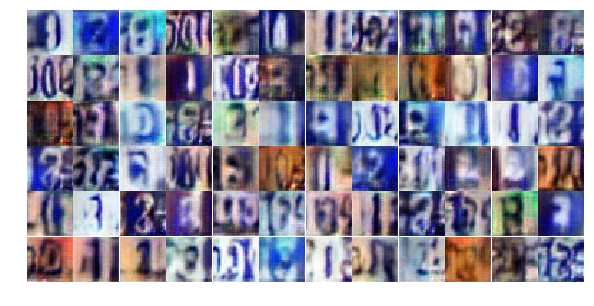

Epoch 9/28... Discriminator Loss: 1.1450... Generator Loss: 0.9197
Epoch 9/28... Discriminator Loss: 1.2626... Generator Loss: 0.6120
Epoch 9/28... Discriminator Loss: 1.1661... Generator Loss: 0.7963
Epoch 9/28... Discriminator Loss: 1.1613... Generator Loss: 0.7943
Epoch 9/28... Discriminator Loss: 1.3367... Generator Loss: 0.5185
Epoch 9/28... Discriminator Loss: 1.3881... Generator Loss: 1.3309
Epoch 9/28... Discriminator Loss: 1.2496... Generator Loss: 0.6981
Epoch 9/28... Discriminator Loss: 0.8255... Generator Loss: 1.5513
Epoch 9/28... Discriminator Loss: 1.6429... Generator Loss: 0.3201
Epoch 9/28... Discriminator Loss: 1.3019... Generator Loss: 0.7517


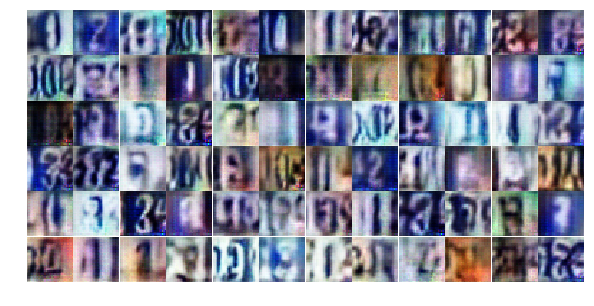

Epoch 9/28... Discriminator Loss: 1.3000... Generator Loss: 0.7226
Epoch 9/28... Discriminator Loss: 1.5504... Generator Loss: 0.3450
Epoch 9/28... Discriminator Loss: 1.2485... Generator Loss: 1.1027
Epoch 9/28... Discriminator Loss: 1.1127... Generator Loss: 0.8166
Epoch 9/28... Discriminator Loss: 1.0482... Generator Loss: 0.9332
Epoch 9/28... Discriminator Loss: 1.1474... Generator Loss: 0.8592
Epoch 9/28... Discriminator Loss: 1.2434... Generator Loss: 0.7250
Epoch 9/28... Discriminator Loss: 0.9078... Generator Loss: 0.9665
Epoch 9/28... Discriminator Loss: 1.2666... Generator Loss: 1.2695
Epoch 9/28... Discriminator Loss: 1.2179... Generator Loss: 0.7109


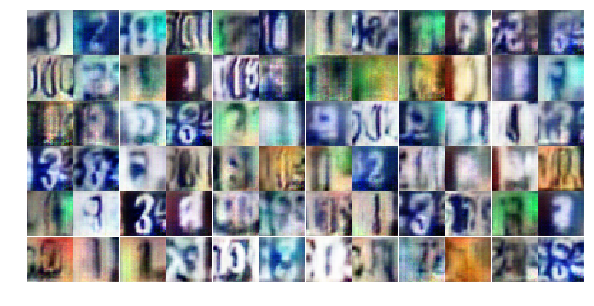

Epoch 9/28... Discriminator Loss: 1.3060... Generator Loss: 0.6932
Epoch 9/28... Discriminator Loss: 1.1902... Generator Loss: 0.7259
Epoch 9/28... Discriminator Loss: 0.9824... Generator Loss: 0.9935
Epoch 9/28... Discriminator Loss: 1.2419... Generator Loss: 0.6425
Epoch 9/28... Discriminator Loss: 1.4973... Generator Loss: 1.0968
Epoch 9/28... Discriminator Loss: 2.0546... Generator Loss: 0.1762
Epoch 9/28... Discriminator Loss: 1.0957... Generator Loss: 0.6227
Epoch 9/28... Discriminator Loss: 1.3935... Generator Loss: 0.5028
Epoch 9/28... Discriminator Loss: 1.2701... Generator Loss: 0.6121
Epoch 9/28... Discriminator Loss: 1.3889... Generator Loss: 0.4894


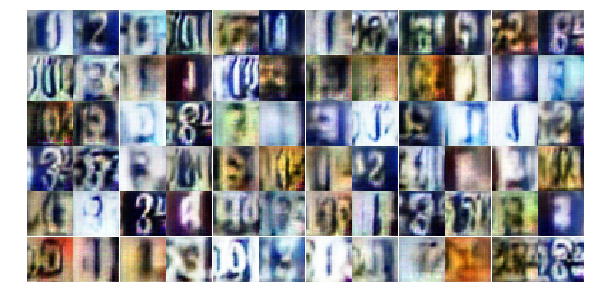

Epoch 9/28... Discriminator Loss: 1.2654... Generator Loss: 0.7982
Epoch 9/28... Discriminator Loss: 1.1562... Generator Loss: 0.8049
Epoch 9/28... Discriminator Loss: 1.5405... Generator Loss: 1.0871
Epoch 9/28... Discriminator Loss: 1.2357... Generator Loss: 0.7259
Epoch 9/28... Discriminator Loss: 1.1919... Generator Loss: 0.8659
Epoch 9/28... Discriminator Loss: 1.1982... Generator Loss: 0.7234
Epoch 9/28... Discriminator Loss: 1.3273... Generator Loss: 0.7113
Epoch 9/28... Discriminator Loss: 0.9511... Generator Loss: 0.9496
Epoch 9/28... Discriminator Loss: 0.7669... Generator Loss: 2.1734
Epoch 9/28... Discriminator Loss: 1.3055... Generator Loss: 0.7980


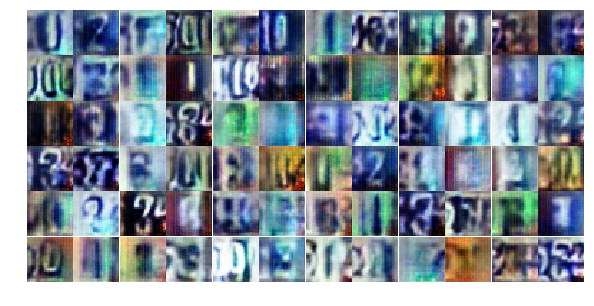

Epoch 9/28... Discriminator Loss: 1.3140... Generator Loss: 0.8487
Epoch 9/28... Discriminator Loss: 1.3285... Generator Loss: 0.6306
Epoch 9/28... Discriminator Loss: 1.3251... Generator Loss: 0.6914
Epoch 9/28... Discriminator Loss: 1.2859... Generator Loss: 0.7644
Epoch 9/28... Discriminator Loss: 1.3002... Generator Loss: 0.7941
Epoch 9/28... Discriminator Loss: 1.4622... Generator Loss: 0.6806
Epoch 9/28... Discriminator Loss: 1.3108... Generator Loss: 0.6821
Epoch 9/28... Discriminator Loss: 1.3198... Generator Loss: 0.6306
Epoch 9/28... Discriminator Loss: 1.1992... Generator Loss: 0.7199
Epoch 9/28... Discriminator Loss: 1.3066... Generator Loss: 0.5896


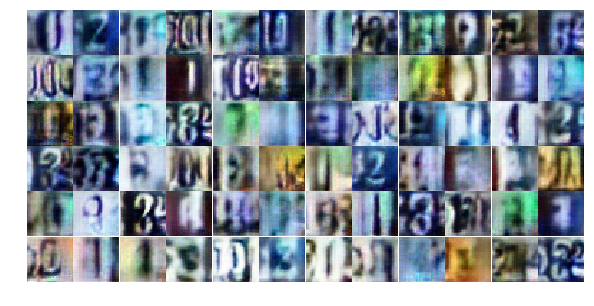

Epoch 9/28... Discriminator Loss: 1.2356... Generator Loss: 0.6824
Epoch 9/28... Discriminator Loss: 1.4254... Generator Loss: 0.8508
Epoch 9/28... Discriminator Loss: 1.2639... Generator Loss: 0.7777
Epoch 9/28... Discriminator Loss: 1.1807... Generator Loss: 0.7511
Epoch 9/28... Discriminator Loss: 1.1647... Generator Loss: 0.8945
Epoch 10/28... Discriminator Loss: 1.1680... Generator Loss: 0.7517
Epoch 10/28... Discriminator Loss: 1.3003... Generator Loss: 0.8016
Epoch 10/28... Discriminator Loss: 1.2177... Generator Loss: 0.6672
Epoch 10/28... Discriminator Loss: 1.2885... Generator Loss: 0.6968
Epoch 10/28... Discriminator Loss: 1.3307... Generator Loss: 0.6099


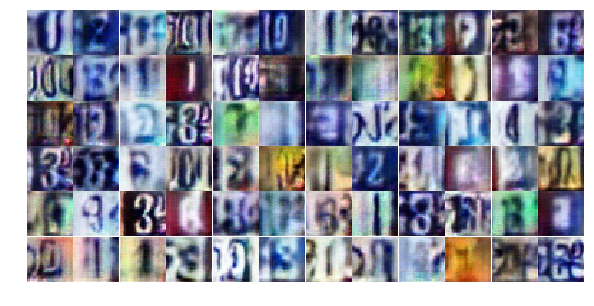

Epoch 10/28... Discriminator Loss: 1.2946... Generator Loss: 0.6118
Epoch 10/28... Discriminator Loss: 1.2193... Generator Loss: 0.9065
Epoch 10/28... Discriminator Loss: 1.2793... Generator Loss: 0.6430
Epoch 10/28... Discriminator Loss: 1.2782... Generator Loss: 0.8120
Epoch 10/28... Discriminator Loss: 1.1508... Generator Loss: 0.8132
Epoch 10/28... Discriminator Loss: 1.2954... Generator Loss: 0.6489
Epoch 10/28... Discriminator Loss: 1.2530... Generator Loss: 0.7606
Epoch 10/28... Discriminator Loss: 1.2891... Generator Loss: 0.6728
Epoch 10/28... Discriminator Loss: 1.2690... Generator Loss: 0.6631
Epoch 10/28... Discriminator Loss: 1.3619... Generator Loss: 0.5649


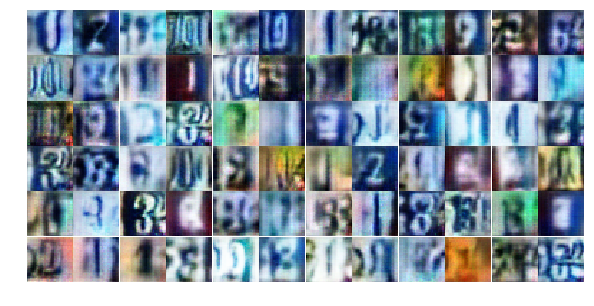

Epoch 10/28... Discriminator Loss: 1.2315... Generator Loss: 0.8672
Epoch 10/28... Discriminator Loss: 1.4167... Generator Loss: 0.5308
Epoch 10/28... Discriminator Loss: 1.2492... Generator Loss: 0.7936
Epoch 10/28... Discriminator Loss: 1.2680... Generator Loss: 0.6336
Epoch 10/28... Discriminator Loss: 1.2033... Generator Loss: 0.8317
Epoch 10/28... Discriminator Loss: 1.2986... Generator Loss: 0.9547
Epoch 10/28... Discriminator Loss: 1.1904... Generator Loss: 0.7048
Epoch 10/28... Discriminator Loss: 1.2746... Generator Loss: 0.6938
Epoch 10/28... Discriminator Loss: 1.2735... Generator Loss: 0.6390
Epoch 10/28... Discriminator Loss: 1.3145... Generator Loss: 1.1346


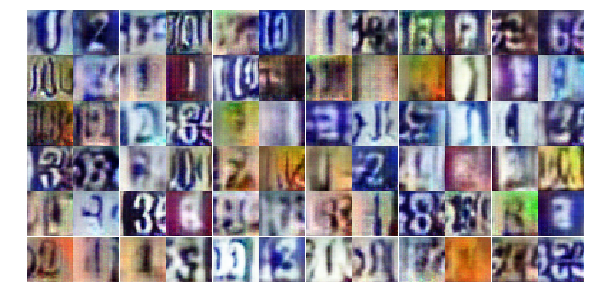

Epoch 10/28... Discriminator Loss: 1.3718... Generator Loss: 0.5408
Epoch 10/28... Discriminator Loss: 1.2587... Generator Loss: 0.6701
Epoch 10/28... Discriminator Loss: 1.1716... Generator Loss: 0.9510
Epoch 10/28... Discriminator Loss: 1.5937... Generator Loss: 1.5995
Epoch 10/28... Discriminator Loss: 1.3209... Generator Loss: 0.6102
Epoch 10/28... Discriminator Loss: 1.2298... Generator Loss: 0.7320
Epoch 10/28... Discriminator Loss: 1.0866... Generator Loss: 0.9168
Epoch 10/28... Discriminator Loss: 1.0629... Generator Loss: 1.3571
Epoch 10/28... Discriminator Loss: 1.1558... Generator Loss: 1.0494
Epoch 10/28... Discriminator Loss: 1.2673... Generator Loss: 1.0891


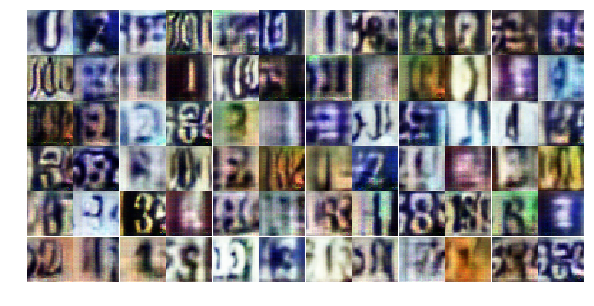

Epoch 10/28... Discriminator Loss: 1.6533... Generator Loss: 2.2306
Epoch 10/28... Discriminator Loss: 1.6690... Generator Loss: 1.6551
Epoch 10/28... Discriminator Loss: 1.2799... Generator Loss: 0.8642
Epoch 10/28... Discriminator Loss: 1.1924... Generator Loss: 0.8301
Epoch 10/28... Discriminator Loss: 1.2921... Generator Loss: 0.8282
Epoch 10/28... Discriminator Loss: 1.0685... Generator Loss: 0.9899
Epoch 10/28... Discriminator Loss: 1.5100... Generator Loss: 0.7473
Epoch 10/28... Discriminator Loss: 1.2271... Generator Loss: 0.7432
Epoch 10/28... Discriminator Loss: 1.2558... Generator Loss: 0.6976
Epoch 10/28... Discriminator Loss: 1.2933... Generator Loss: 0.8790


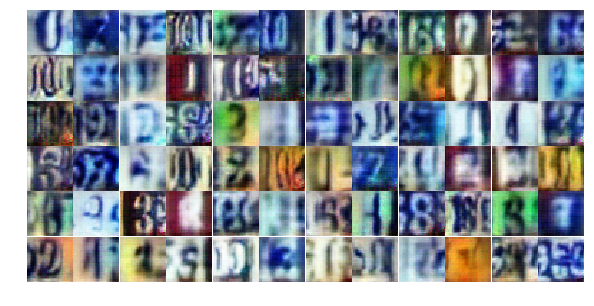

Epoch 10/28... Discriminator Loss: 1.2605... Generator Loss: 0.7117
Epoch 10/28... Discriminator Loss: 1.1886... Generator Loss: 0.8652
Epoch 10/28... Discriminator Loss: 1.3990... Generator Loss: 0.4584
Epoch 10/28... Discriminator Loss: 0.9594... Generator Loss: 1.4343
Epoch 10/28... Discriminator Loss: 1.2564... Generator Loss: 1.0910
Epoch 10/28... Discriminator Loss: 1.1819... Generator Loss: 0.7871
Epoch 10/28... Discriminator Loss: 1.2414... Generator Loss: 0.7866
Epoch 10/28... Discriminator Loss: 1.1751... Generator Loss: 0.8322
Epoch 10/28... Discriminator Loss: 1.1636... Generator Loss: 0.9043
Epoch 10/28... Discriminator Loss: 1.2296... Generator Loss: 0.7336


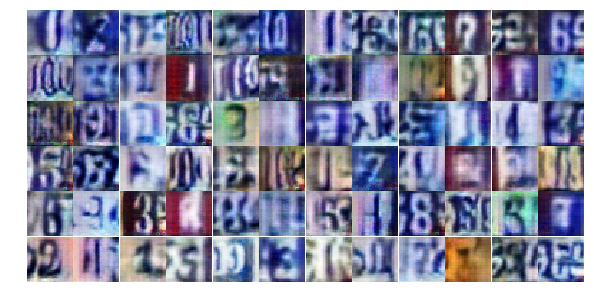

Epoch 10/28... Discriminator Loss: 1.2218... Generator Loss: 0.7186
Epoch 10/28... Discriminator Loss: 1.2783... Generator Loss: 0.8399
Epoch 10/28... Discriminator Loss: 1.2378... Generator Loss: 0.9016
Epoch 11/28... Discriminator Loss: 1.1983... Generator Loss: 0.7795
Epoch 11/28... Discriminator Loss: 1.2915... Generator Loss: 0.7201
Epoch 11/28... Discriminator Loss: 1.2894... Generator Loss: 0.6789
Epoch 11/28... Discriminator Loss: 1.0007... Generator Loss: 0.6005
Epoch 11/28... Discriminator Loss: 1.6483... Generator Loss: 0.3176
Epoch 11/28... Discriminator Loss: 1.3233... Generator Loss: 0.5698
Epoch 11/28... Discriminator Loss: 1.1209... Generator Loss: 0.8836


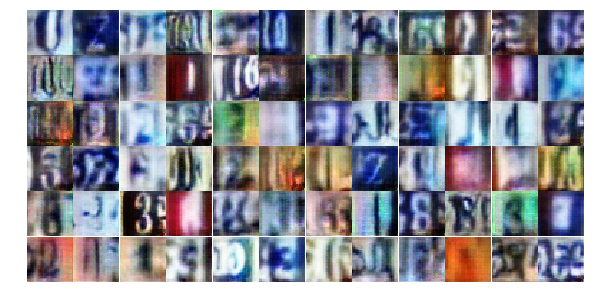

Epoch 11/28... Discriminator Loss: 1.0037... Generator Loss: 0.8629
Epoch 11/28... Discriminator Loss: 1.0222... Generator Loss: 1.1798
Epoch 11/28... Discriminator Loss: 1.2747... Generator Loss: 0.7007
Epoch 11/28... Discriminator Loss: 1.4232... Generator Loss: 0.7546
Epoch 11/28... Discriminator Loss: 1.3316... Generator Loss: 0.7694
Epoch 11/28... Discriminator Loss: 1.3319... Generator Loss: 0.8312
Epoch 11/28... Discriminator Loss: 1.2405... Generator Loss: 0.7420
Epoch 11/28... Discriminator Loss: 1.1482... Generator Loss: 0.8894
Epoch 11/28... Discriminator Loss: 1.2650... Generator Loss: 0.7244
Epoch 11/28... Discriminator Loss: 1.3042... Generator Loss: 0.6270


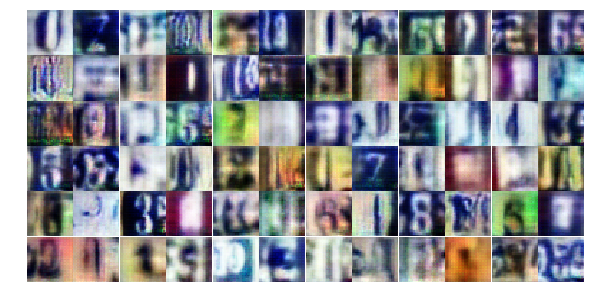

Epoch 11/28... Discriminator Loss: 1.2787... Generator Loss: 0.6602
Epoch 11/28... Discriminator Loss: 1.2293... Generator Loss: 1.0099
Epoch 11/28... Discriminator Loss: 1.3520... Generator Loss: 0.4890
Epoch 11/28... Discriminator Loss: 1.2710... Generator Loss: 0.7579
Epoch 11/28... Discriminator Loss: 1.1593... Generator Loss: 0.8181
Epoch 11/28... Discriminator Loss: 1.0404... Generator Loss: 0.8863
Epoch 11/28... Discriminator Loss: 1.2912... Generator Loss: 0.6763
Epoch 11/28... Discriminator Loss: 0.9035... Generator Loss: 0.9976
Epoch 11/28... Discriminator Loss: 1.3955... Generator Loss: 0.5838
Epoch 11/28... Discriminator Loss: 0.5417... Generator Loss: 1.8475


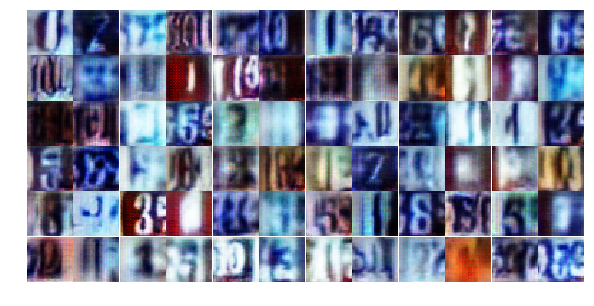

Epoch 11/28... Discriminator Loss: 1.2442... Generator Loss: 0.6964
Epoch 11/28... Discriminator Loss: 1.4804... Generator Loss: 0.6522
Epoch 11/28... Discriminator Loss: 1.4421... Generator Loss: 1.1817
Epoch 11/28... Discriminator Loss: 1.3867... Generator Loss: 0.7145
Epoch 11/28... Discriminator Loss: 1.1378... Generator Loss: 0.7929
Epoch 11/28... Discriminator Loss: 1.3566... Generator Loss: 0.6982
Epoch 11/28... Discriminator Loss: 1.2130... Generator Loss: 0.8716
Epoch 11/28... Discriminator Loss: 1.1880... Generator Loss: 0.8202
Epoch 11/28... Discriminator Loss: 1.2634... Generator Loss: 0.8114
Epoch 11/28... Discriminator Loss: 1.3061... Generator Loss: 0.6024


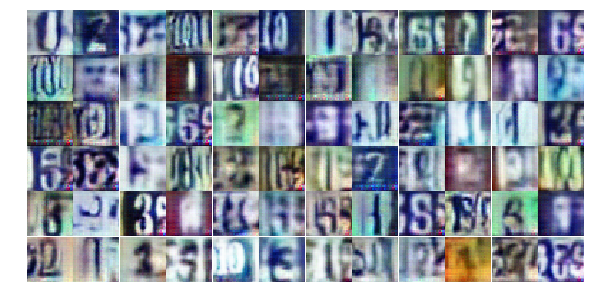

Epoch 11/28... Discriminator Loss: 1.3412... Generator Loss: 0.6966
Epoch 11/28... Discriminator Loss: 1.2394... Generator Loss: 0.8839
Epoch 11/28... Discriminator Loss: 1.2632... Generator Loss: 0.7849
Epoch 11/28... Discriminator Loss: 1.3559... Generator Loss: 0.5110
Epoch 11/28... Discriminator Loss: 1.3361... Generator Loss: 0.6279
Epoch 11/28... Discriminator Loss: 1.1893... Generator Loss: 0.8003
Epoch 11/28... Discriminator Loss: 1.2314... Generator Loss: 0.7241
Epoch 11/28... Discriminator Loss: 1.2551... Generator Loss: 0.7365
Epoch 11/28... Discriminator Loss: 1.3445... Generator Loss: 0.4623
Epoch 11/28... Discriminator Loss: 1.1903... Generator Loss: 0.8282


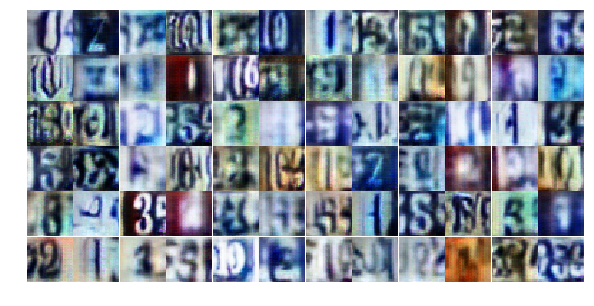

Epoch 11/28... Discriminator Loss: 1.2132... Generator Loss: 0.7846
Epoch 11/28... Discriminator Loss: 1.1485... Generator Loss: 0.9007
Epoch 11/28... Discriminator Loss: 1.2918... Generator Loss: 0.6519
Epoch 11/28... Discriminator Loss: 1.2972... Generator Loss: 0.8267
Epoch 11/28... Discriminator Loss: 1.3638... Generator Loss: 0.5055
Epoch 11/28... Discriminator Loss: 1.2310... Generator Loss: 0.7969
Epoch 11/28... Discriminator Loss: 1.3547... Generator Loss: 1.2429
Epoch 11/28... Discriminator Loss: 1.2022... Generator Loss: 0.9356
Epoch 11/28... Discriminator Loss: 1.3529... Generator Loss: 0.6548
Epoch 11/28... Discriminator Loss: 1.3114... Generator Loss: 0.6592


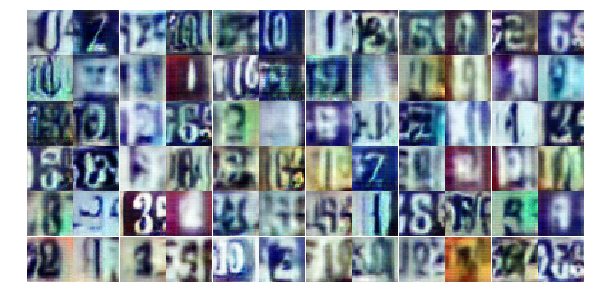

Epoch 12/28... Discriminator Loss: 1.3240... Generator Loss: 0.9073
Epoch 12/28... Discriminator Loss: 1.2613... Generator Loss: 1.0043
Epoch 12/28... Discriminator Loss: 1.2916... Generator Loss: 0.6271
Epoch 12/28... Discriminator Loss: 1.2285... Generator Loss: 0.8591
Epoch 12/28... Discriminator Loss: 1.1039... Generator Loss: 1.1717
Epoch 12/28... Discriminator Loss: 2.5131... Generator Loss: 1.9785
Epoch 12/28... Discriminator Loss: 1.2840... Generator Loss: 0.7971
Epoch 12/28... Discriminator Loss: 1.2701... Generator Loss: 0.7669
Epoch 12/28... Discriminator Loss: 1.3058... Generator Loss: 0.6899
Epoch 12/28... Discriminator Loss: 1.3096... Generator Loss: 0.6218


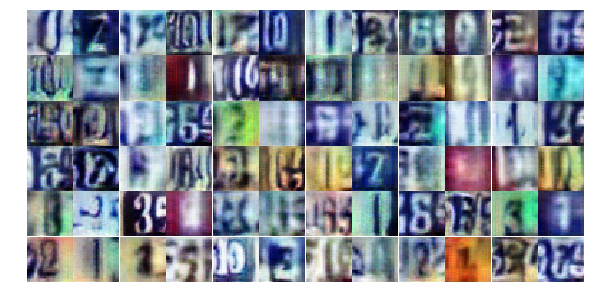

Epoch 12/28... Discriminator Loss: 1.2383... Generator Loss: 0.6832
Epoch 12/28... Discriminator Loss: 1.2569... Generator Loss: 0.6942
Epoch 12/28... Discriminator Loss: 1.2527... Generator Loss: 0.6715
Epoch 12/28... Discriminator Loss: 1.2214... Generator Loss: 0.7741
Epoch 12/28... Discriminator Loss: 1.0655... Generator Loss: 0.8991
Epoch 12/28... Discriminator Loss: 1.0331... Generator Loss: 0.8511
Epoch 12/28... Discriminator Loss: 0.9380... Generator Loss: 0.8064
Epoch 12/28... Discriminator Loss: 1.2345... Generator Loss: 0.7124
Epoch 12/28... Discriminator Loss: 1.3512... Generator Loss: 0.8336
Epoch 12/28... Discriminator Loss: 1.2946... Generator Loss: 0.7438


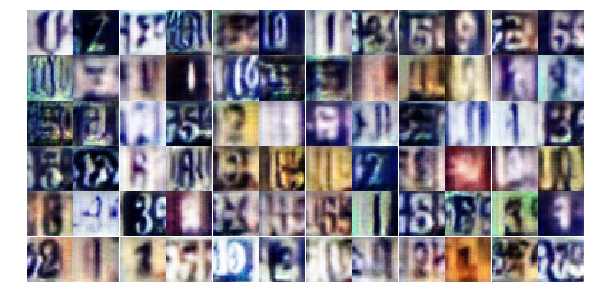

Epoch 12/28... Discriminator Loss: 1.1695... Generator Loss: 0.9624
Epoch 12/28... Discriminator Loss: 1.2321... Generator Loss: 0.7069
Epoch 12/28... Discriminator Loss: 1.1839... Generator Loss: 0.7941
Epoch 12/28... Discriminator Loss: 1.3813... Generator Loss: 0.9817
Epoch 12/28... Discriminator Loss: 1.2314... Generator Loss: 0.7660
Epoch 12/28... Discriminator Loss: 1.1800... Generator Loss: 0.8609
Epoch 12/28... Discriminator Loss: 1.3750... Generator Loss: 0.5435
Epoch 12/28... Discriminator Loss: 1.2216... Generator Loss: 0.9976
Epoch 12/28... Discriminator Loss: 1.1566... Generator Loss: 0.8936
Epoch 12/28... Discriminator Loss: 1.2134... Generator Loss: 0.7855


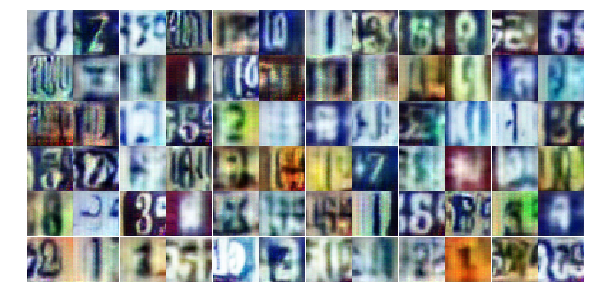

Epoch 12/28... Discriminator Loss: 1.1889... Generator Loss: 0.7287
Epoch 12/28... Discriminator Loss: 1.3162... Generator Loss: 0.8141
Epoch 12/28... Discriminator Loss: 1.2753... Generator Loss: 0.7884
Epoch 12/28... Discriminator Loss: 1.2973... Generator Loss: 0.5219
Epoch 12/28... Discriminator Loss: 1.2351... Generator Loss: 1.0045
Epoch 12/28... Discriminator Loss: 1.3115... Generator Loss: 0.8943
Epoch 12/28... Discriminator Loss: 1.3384... Generator Loss: 0.6134
Epoch 12/28... Discriminator Loss: 1.2907... Generator Loss: 0.6373
Epoch 12/28... Discriminator Loss: 1.3796... Generator Loss: 0.5029
Epoch 12/28... Discriminator Loss: 1.1345... Generator Loss: 0.8829


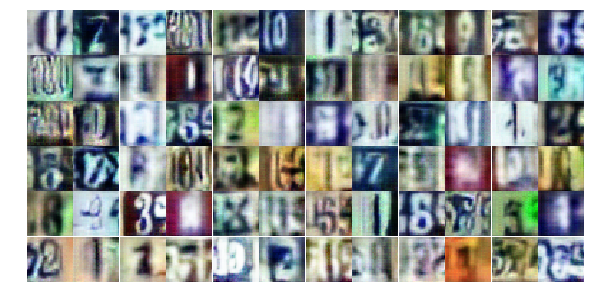

Epoch 12/28... Discriminator Loss: 1.1464... Generator Loss: 0.7918
Epoch 12/28... Discriminator Loss: 1.2325... Generator Loss: 0.8441
Epoch 12/28... Discriminator Loss: 1.1846... Generator Loss: 0.8435
Epoch 12/28... Discriminator Loss: 1.3359... Generator Loss: 0.8479
Epoch 12/28... Discriminator Loss: 1.4122... Generator Loss: 0.4613
Epoch 12/28... Discriminator Loss: 1.2408... Generator Loss: 0.5721
Epoch 12/28... Discriminator Loss: 1.3303... Generator Loss: 0.4956
Epoch 12/28... Discriminator Loss: 1.2822... Generator Loss: 0.6734
Epoch 12/28... Discriminator Loss: 1.1643... Generator Loss: 0.6713
Epoch 12/28... Discriminator Loss: 1.4453... Generator Loss: 1.9747


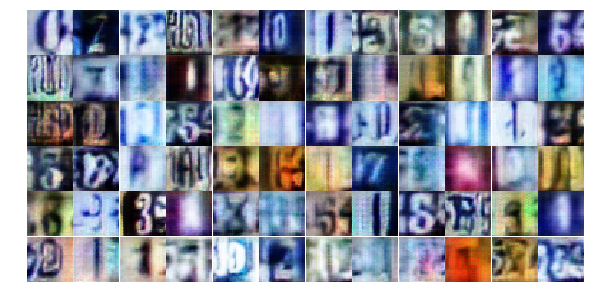

Epoch 12/28... Discriminator Loss: 1.2988... Generator Loss: 0.8590
Epoch 12/28... Discriminator Loss: 1.3271... Generator Loss: 0.4580
Epoch 12/28... Discriminator Loss: 1.0825... Generator Loss: 0.9312
Epoch 12/28... Discriminator Loss: 1.1474... Generator Loss: 1.4805
Epoch 12/28... Discriminator Loss: 0.6414... Generator Loss: 1.4378
Epoch 12/28... Discriminator Loss: 1.0217... Generator Loss: 1.1524
Epoch 12/28... Discriminator Loss: 0.3222... Generator Loss: 1.5488
Epoch 13/28... Discriminator Loss: 0.9719... Generator Loss: 1.7964
Epoch 13/28... Discriminator Loss: 1.2786... Generator Loss: 1.1409
Epoch 13/28... Discriminator Loss: 1.3336... Generator Loss: 0.5577


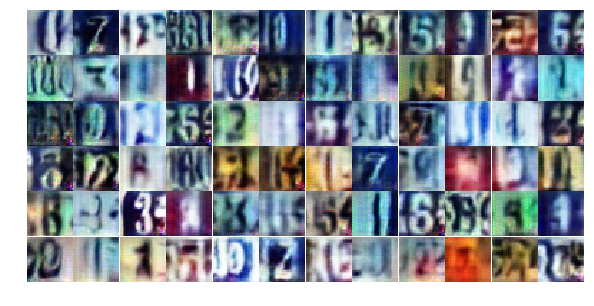

Epoch 13/28... Discriminator Loss: 0.3721... Generator Loss: 1.9845
Epoch 13/28... Discriminator Loss: 1.6067... Generator Loss: 0.3318
Epoch 13/28... Discriminator Loss: 1.3167... Generator Loss: 0.7795
Epoch 13/28... Discriminator Loss: 1.3814... Generator Loss: 0.6260
Epoch 13/28... Discriminator Loss: 0.7122... Generator Loss: 1.6843
Epoch 13/28... Discriminator Loss: 1.3934... Generator Loss: 0.6250
Epoch 13/28... Discriminator Loss: 1.1977... Generator Loss: 0.8828
Epoch 13/28... Discriminator Loss: 1.2803... Generator Loss: 0.6785
Epoch 13/28... Discriminator Loss: 1.2117... Generator Loss: 0.8970
Epoch 13/28... Discriminator Loss: 1.2683... Generator Loss: 0.8117


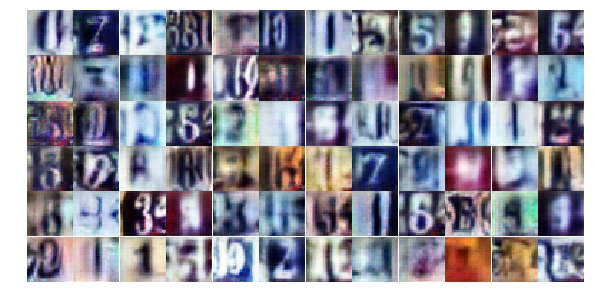

Epoch 13/28... Discriminator Loss: 1.3504... Generator Loss: 0.8106
Epoch 13/28... Discriminator Loss: 1.2555... Generator Loss: 0.7604
Epoch 13/28... Discriminator Loss: 1.2448... Generator Loss: 0.7569
Epoch 13/28... Discriminator Loss: 1.3459... Generator Loss: 0.8517
Epoch 13/28... Discriminator Loss: 1.1364... Generator Loss: 0.6787
Epoch 13/28... Discriminator Loss: 1.2838... Generator Loss: 0.8239
Epoch 13/28... Discriminator Loss: 1.3337... Generator Loss: 0.7599
Epoch 13/28... Discriminator Loss: 1.3577... Generator Loss: 0.5532
Epoch 13/28... Discriminator Loss: 1.2182... Generator Loss: 0.9794
Epoch 13/28... Discriminator Loss: 1.3001... Generator Loss: 0.5868


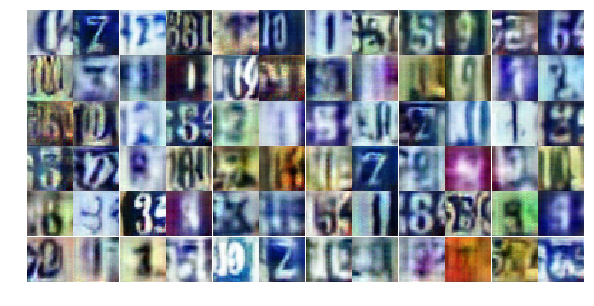

Epoch 13/28... Discriminator Loss: 1.2627... Generator Loss: 0.7044
Epoch 13/28... Discriminator Loss: 1.2295... Generator Loss: 0.6454
Epoch 13/28... Discriminator Loss: 1.3728... Generator Loss: 0.6467
Epoch 13/28... Discriminator Loss: 1.3090... Generator Loss: 0.7873
Epoch 13/28... Discriminator Loss: 1.2828... Generator Loss: 0.6836
Epoch 13/28... Discriminator Loss: 1.2878... Generator Loss: 0.6913
Epoch 13/28... Discriminator Loss: 1.2884... Generator Loss: 0.7717
Epoch 13/28... Discriminator Loss: 1.2711... Generator Loss: 0.8017
Epoch 13/28... Discriminator Loss: 1.3873... Generator Loss: 0.4498
Epoch 13/28... Discriminator Loss: 1.4332... Generator Loss: 0.7851


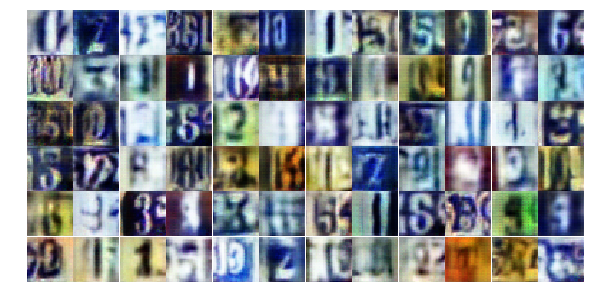

Epoch 13/28... Discriminator Loss: 1.3026... Generator Loss: 0.6770
Epoch 13/28... Discriminator Loss: 1.3320... Generator Loss: 0.8038
Epoch 13/28... Discriminator Loss: 1.2525... Generator Loss: 0.7387
Epoch 13/28... Discriminator Loss: 1.2552... Generator Loss: 0.7398
Epoch 13/28... Discriminator Loss: 1.1432... Generator Loss: 0.8463
Epoch 13/28... Discriminator Loss: 1.1079... Generator Loss: 0.9179
Epoch 13/28... Discriminator Loss: 1.1697... Generator Loss: 0.8890
Epoch 13/28... Discriminator Loss: 1.2618... Generator Loss: 0.8152
Epoch 13/28... Discriminator Loss: 1.2463... Generator Loss: 0.9168
Epoch 13/28... Discriminator Loss: 1.2751... Generator Loss: 0.7668


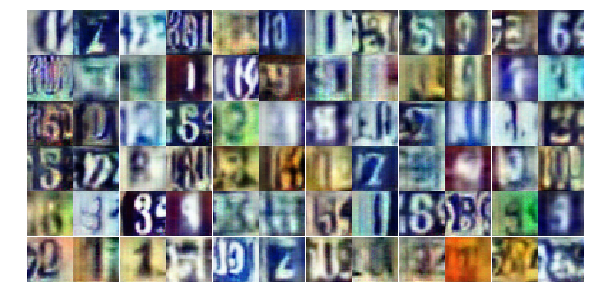

Epoch 13/28... Discriminator Loss: 1.2383... Generator Loss: 0.7328
Epoch 13/28... Discriminator Loss: 1.2845... Generator Loss: 1.0157
Epoch 13/28... Discriminator Loss: 1.3199... Generator Loss: 0.7372
Epoch 13/28... Discriminator Loss: 1.1944... Generator Loss: 0.8728
Epoch 13/28... Discriminator Loss: 1.3570... Generator Loss: 0.5730
Epoch 13/28... Discriminator Loss: 1.2532... Generator Loss: 0.6804
Epoch 13/28... Discriminator Loss: 1.2318... Generator Loss: 0.7478
Epoch 13/28... Discriminator Loss: 1.0046... Generator Loss: 0.7107
Epoch 13/28... Discriminator Loss: 1.3359... Generator Loss: 0.5709
Epoch 13/28... Discriminator Loss: 1.4967... Generator Loss: 0.4396


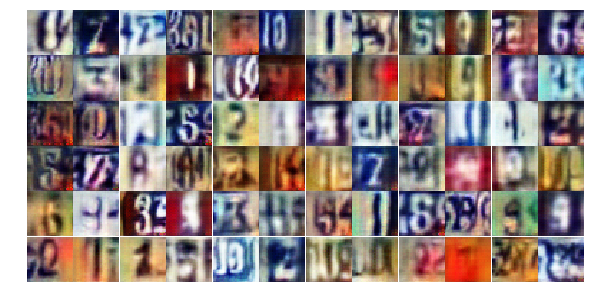

Epoch 13/28... Discriminator Loss: 1.3936... Generator Loss: 0.6323
Epoch 13/28... Discriminator Loss: 1.2859... Generator Loss: 0.7491
Epoch 13/28... Discriminator Loss: 1.2450... Generator Loss: 0.8375
Epoch 13/28... Discriminator Loss: 1.2670... Generator Loss: 0.6874
Epoch 14/28... Discriminator Loss: 1.3143... Generator Loss: 0.6854
Epoch 14/28... Discriminator Loss: 1.3150... Generator Loss: 0.7397
Epoch 14/28... Discriminator Loss: 1.2431... Generator Loss: 0.7541
Epoch 14/28... Discriminator Loss: 1.2154... Generator Loss: 0.9493
Epoch 14/28... Discriminator Loss: 1.1535... Generator Loss: 0.8463
Epoch 14/28... Discriminator Loss: 1.3626... Generator Loss: 0.4882


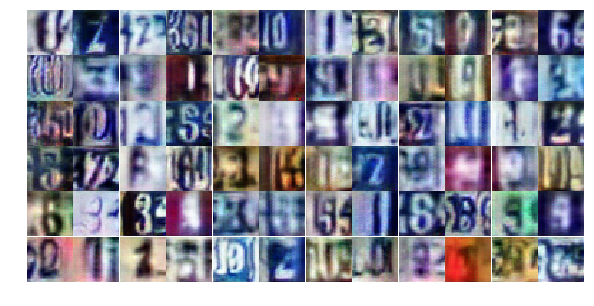

Epoch 14/28... Discriminator Loss: 1.3435... Generator Loss: 0.8944
Epoch 14/28... Discriminator Loss: 1.2453... Generator Loss: 0.6881
Epoch 14/28... Discriminator Loss: 1.3179... Generator Loss: 0.6630
Epoch 14/28... Discriminator Loss: 1.3256... Generator Loss: 0.6659
Epoch 14/28... Discriminator Loss: 1.1962... Generator Loss: 0.7057
Epoch 14/28... Discriminator Loss: 1.1224... Generator Loss: 1.0321
Epoch 14/28... Discriminator Loss: 1.2121... Generator Loss: 0.8138
Epoch 14/28... Discriminator Loss: 1.3151... Generator Loss: 0.6022
Epoch 14/28... Discriminator Loss: 1.3118... Generator Loss: 0.5979
Epoch 14/28... Discriminator Loss: 1.2840... Generator Loss: 0.6967


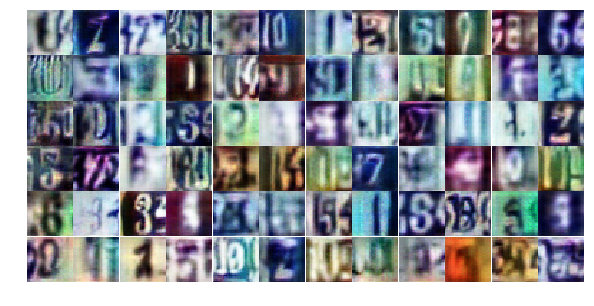

Epoch 14/28... Discriminator Loss: 1.6347... Generator Loss: 0.3505
Epoch 14/28... Discriminator Loss: 1.1325... Generator Loss: 0.5515
Epoch 14/28... Discriminator Loss: 1.1666... Generator Loss: 0.8351
Epoch 14/28... Discriminator Loss: 1.2641... Generator Loss: 0.6172
Epoch 14/28... Discriminator Loss: 1.1952... Generator Loss: 0.8928
Epoch 14/28... Discriminator Loss: 1.2369... Generator Loss: 0.7284
Epoch 14/28... Discriminator Loss: 1.3508... Generator Loss: 0.6068
Epoch 14/28... Discriminator Loss: 1.2657... Generator Loss: 0.6997
Epoch 14/28... Discriminator Loss: 1.2769... Generator Loss: 1.1264
Epoch 14/28... Discriminator Loss: 1.1897... Generator Loss: 0.8070


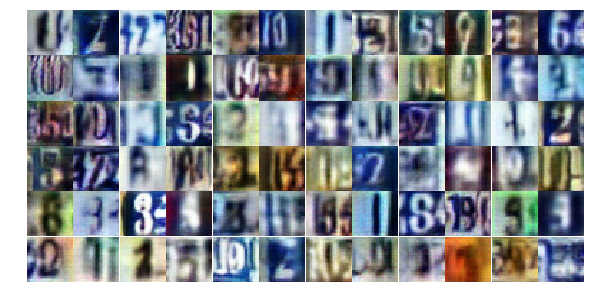

Epoch 14/28... Discriminator Loss: 1.3003... Generator Loss: 0.5714
Epoch 14/28... Discriminator Loss: 1.1512... Generator Loss: 0.8218
Epoch 14/28... Discriminator Loss: 1.2571... Generator Loss: 1.1242
Epoch 14/28... Discriminator Loss: 1.1802... Generator Loss: 0.7755
Epoch 14/28... Discriminator Loss: 1.1719... Generator Loss: 0.9520
Epoch 14/28... Discriminator Loss: 1.3362... Generator Loss: 0.5461
Epoch 14/28... Discriminator Loss: 1.2624... Generator Loss: 0.6243
Epoch 14/28... Discriminator Loss: 1.2296... Generator Loss: 0.7279
Epoch 14/28... Discriminator Loss: 1.1289... Generator Loss: 0.8025
Epoch 14/28... Discriminator Loss: 1.1233... Generator Loss: 0.9795


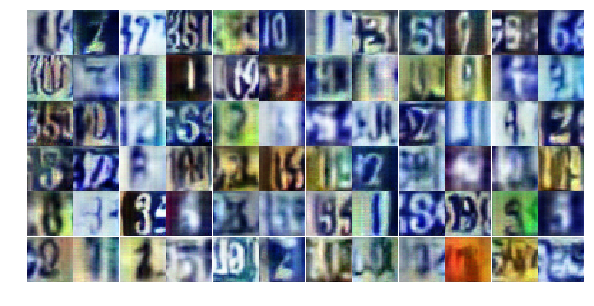

Epoch 14/28... Discriminator Loss: 1.5757... Generator Loss: 1.5341
Epoch 14/28... Discriminator Loss: 1.7058... Generator Loss: 2.3536
Epoch 14/28... Discriminator Loss: 0.8455... Generator Loss: 1.3561
Epoch 14/28... Discriminator Loss: 0.5507... Generator Loss: 3.2396
Epoch 14/28... Discriminator Loss: 0.8059... Generator Loss: 1.8087
Epoch 14/28... Discriminator Loss: 0.1216... Generator Loss: 5.1167
Epoch 14/28... Discriminator Loss: 1.2544... Generator Loss: 0.4800
Epoch 14/28... Discriminator Loss: 0.9572... Generator Loss: 1.1339
Epoch 14/28... Discriminator Loss: 0.1409... Generator Loss: 2.4066
Epoch 14/28... Discriminator Loss: 1.0203... Generator Loss: 0.9401


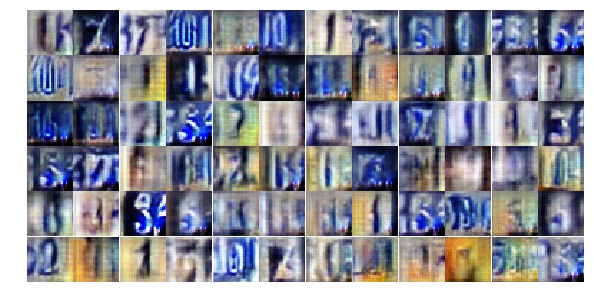

Epoch 14/28... Discriminator Loss: 1.7729... Generator Loss: 2.8558
Epoch 14/28... Discriminator Loss: 0.7734... Generator Loss: 1.1923
Epoch 14/28... Discriminator Loss: 0.1161... Generator Loss: 3.5966
Epoch 14/28... Discriminator Loss: 0.0776... Generator Loss: 3.3305
Epoch 14/28... Discriminator Loss: 1.2008... Generator Loss: 0.8838
Epoch 14/28... Discriminator Loss: 1.2863... Generator Loss: 1.3235
Epoch 14/28... Discriminator Loss: 1.5144... Generator Loss: 0.8641
Epoch 14/28... Discriminator Loss: 1.2498... Generator Loss: 0.7992
Epoch 14/28... Discriminator Loss: 1.1358... Generator Loss: 0.8723
Epoch 14/28... Discriminator Loss: 1.2019... Generator Loss: 0.6379


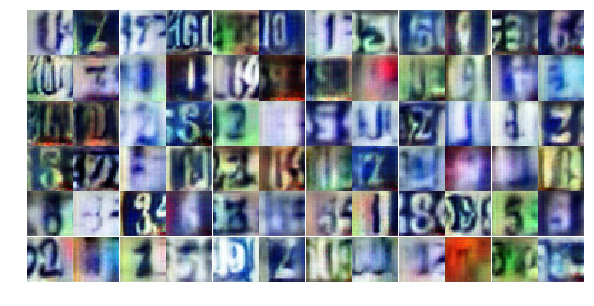

Epoch 14/28... Discriminator Loss: 1.2075... Generator Loss: 0.8668
Epoch 14/28... Discriminator Loss: 1.2473... Generator Loss: 0.9467
Epoch 15/28... Discriminator Loss: 1.0736... Generator Loss: 0.7461
Epoch 15/28... Discriminator Loss: 1.1202... Generator Loss: 0.8445
Epoch 15/28... Discriminator Loss: 1.1224... Generator Loss: 0.8334
Epoch 15/28... Discriminator Loss: 1.2400... Generator Loss: 0.6706
Epoch 15/28... Discriminator Loss: 1.1768... Generator Loss: 0.7078
Epoch 15/28... Discriminator Loss: 1.1820... Generator Loss: 0.8413
Epoch 15/28... Discriminator Loss: 1.2849... Generator Loss: 0.6645
Epoch 15/28... Discriminator Loss: 1.1886... Generator Loss: 0.8555


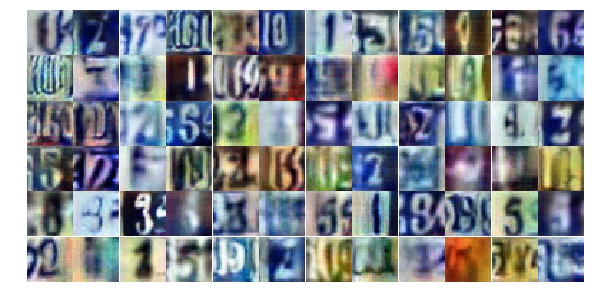

Epoch 15/28... Discriminator Loss: 1.3264... Generator Loss: 0.8109
Epoch 15/28... Discriminator Loss: 1.2853... Generator Loss: 0.8906
Epoch 15/28... Discriminator Loss: 1.2760... Generator Loss: 0.7805
Epoch 15/28... Discriminator Loss: 1.1719... Generator Loss: 0.9030
Epoch 15/28... Discriminator Loss: 1.2801... Generator Loss: 0.8103
Epoch 15/28... Discriminator Loss: 1.1407... Generator Loss: 0.9610
Epoch 15/28... Discriminator Loss: 1.3515... Generator Loss: 0.6011
Epoch 15/28... Discriminator Loss: 1.1947... Generator Loss: 0.9144
Epoch 15/28... Discriminator Loss: 1.2661... Generator Loss: 0.9000
Epoch 15/28... Discriminator Loss: 1.2633... Generator Loss: 0.5782


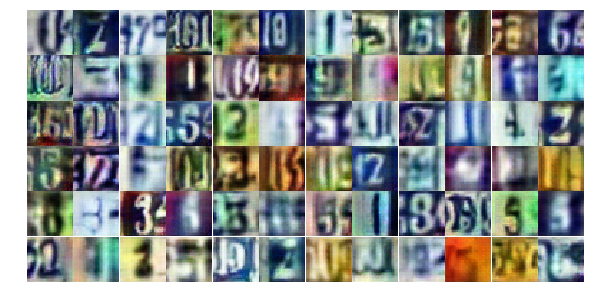

Epoch 15/28... Discriminator Loss: 1.3173... Generator Loss: 0.7545
Epoch 15/28... Discriminator Loss: 1.1801... Generator Loss: 0.9455
Epoch 15/28... Discriminator Loss: 1.2963... Generator Loss: 0.6404
Epoch 15/28... Discriminator Loss: 1.3452... Generator Loss: 0.5226
Epoch 15/28... Discriminator Loss: 1.2359... Generator Loss: 0.6147
Epoch 15/28... Discriminator Loss: 1.2219... Generator Loss: 0.6817
Epoch 15/28... Discriminator Loss: 1.3095... Generator Loss: 0.5840
Epoch 15/28... Discriminator Loss: 1.2618... Generator Loss: 0.6280
Epoch 15/28... Discriminator Loss: 1.1291... Generator Loss: 0.9456
Epoch 15/28... Discriminator Loss: 1.2506... Generator Loss: 0.5857


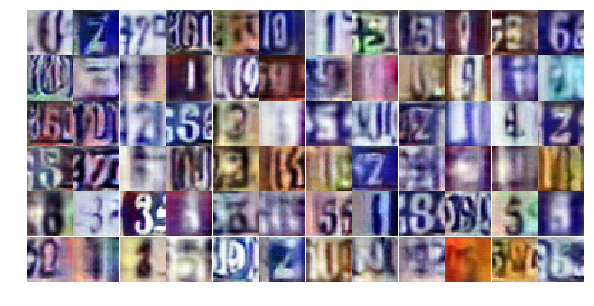

Epoch 15/28... Discriminator Loss: 1.3601... Generator Loss: 0.5000
Epoch 15/28... Discriminator Loss: 1.3546... Generator Loss: 0.5786
Epoch 15/28... Discriminator Loss: 1.1447... Generator Loss: 0.8335
Epoch 15/28... Discriminator Loss: 1.2193... Generator Loss: 0.9218
Epoch 15/28... Discriminator Loss: 1.3067... Generator Loss: 0.7038
Epoch 15/28... Discriminator Loss: 1.3236... Generator Loss: 0.9223
Epoch 15/28... Discriminator Loss: 1.2418... Generator Loss: 0.6562
Epoch 15/28... Discriminator Loss: 1.3135... Generator Loss: 0.6184
Epoch 15/28... Discriminator Loss: 1.1664... Generator Loss: 1.0668
Epoch 15/28... Discriminator Loss: 1.2193... Generator Loss: 0.9105


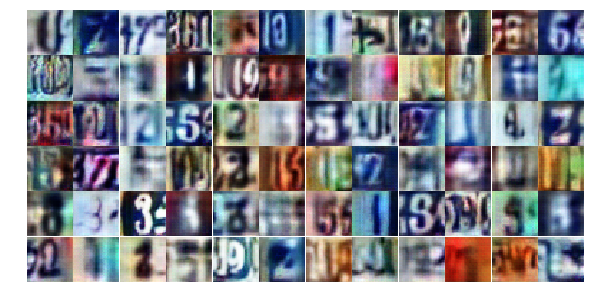

Epoch 15/28... Discriminator Loss: 1.2431... Generator Loss: 0.8805
Epoch 15/28... Discriminator Loss: 1.2337... Generator Loss: 0.6926
Epoch 15/28... Discriminator Loss: 1.3065... Generator Loss: 0.5779
Epoch 15/28... Discriminator Loss: 1.2126... Generator Loss: 0.6927
Epoch 15/28... Discriminator Loss: 1.1986... Generator Loss: 0.6553
Epoch 15/28... Discriminator Loss: 1.4607... Generator Loss: 0.4299
Epoch 15/28... Discriminator Loss: 1.1014... Generator Loss: 0.9933
Epoch 15/28... Discriminator Loss: 1.3515... Generator Loss: 0.8920
Epoch 15/28... Discriminator Loss: 1.2609... Generator Loss: 0.7918
Epoch 15/28... Discriminator Loss: 1.3147... Generator Loss: 0.9158


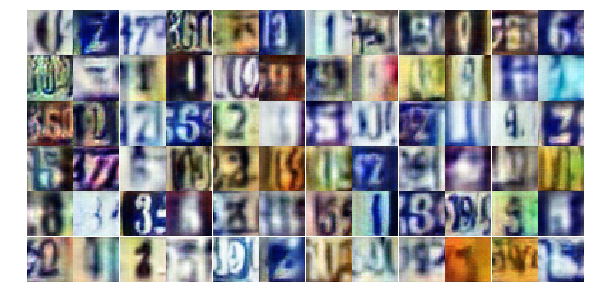

Epoch 15/28... Discriminator Loss: 1.3314... Generator Loss: 0.7394
Epoch 15/28... Discriminator Loss: 1.4093... Generator Loss: 0.4363
Epoch 15/28... Discriminator Loss: 1.2649... Generator Loss: 1.0374
Epoch 15/28... Discriminator Loss: 1.2799... Generator Loss: 0.5701
Epoch 15/28... Discriminator Loss: 1.2835... Generator Loss: 0.6552
Epoch 15/28... Discriminator Loss: 1.2389... Generator Loss: 0.7282
Epoch 15/28... Discriminator Loss: 1.1966... Generator Loss: 0.6877
Epoch 15/28... Discriminator Loss: 1.2190... Generator Loss: 0.9095
Epoch 15/28... Discriminator Loss: 1.2396... Generator Loss: 0.6587
Epoch 16/28... Discriminator Loss: 1.3103... Generator Loss: 0.7377


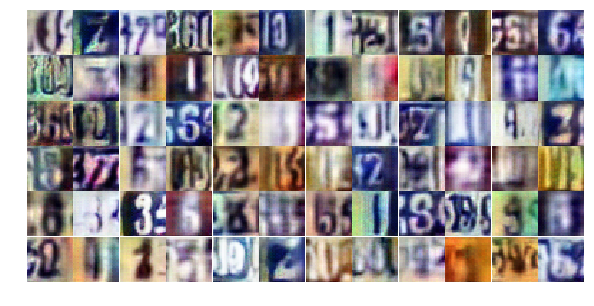

Epoch 16/28... Discriminator Loss: 1.1730... Generator Loss: 0.7943
Epoch 16/28... Discriminator Loss: 1.2770... Generator Loss: 0.9543
Epoch 16/28... Discriminator Loss: 1.2799... Generator Loss: 0.6692
Epoch 16/28... Discriminator Loss: 1.1652... Generator Loss: 0.7646
Epoch 16/28... Discriminator Loss: 1.1338... Generator Loss: 1.0848
Epoch 16/28... Discriminator Loss: 1.3283... Generator Loss: 1.0334
Epoch 16/28... Discriminator Loss: 1.3014... Generator Loss: 0.6705
Epoch 16/28... Discriminator Loss: 1.2522... Generator Loss: 0.8431
Epoch 16/28... Discriminator Loss: 1.1296... Generator Loss: 0.7596
Epoch 16/28... Discriminator Loss: 1.2884... Generator Loss: 0.6569


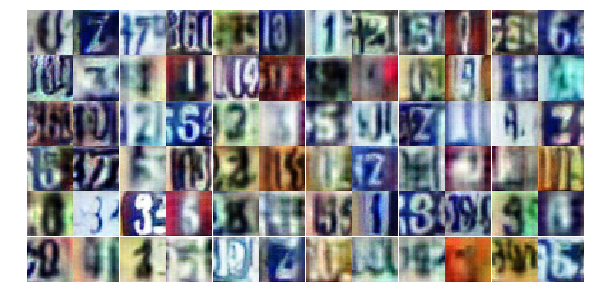

Epoch 16/28... Discriminator Loss: 1.2641... Generator Loss: 0.6272
Epoch 16/28... Discriminator Loss: 1.1686... Generator Loss: 0.8346
Epoch 16/28... Discriminator Loss: 1.3146... Generator Loss: 1.1077
Epoch 16/28... Discriminator Loss: 1.3184... Generator Loss: 0.5677
Epoch 16/28... Discriminator Loss: 1.0489... Generator Loss: 0.9354
Epoch 16/28... Discriminator Loss: 1.2852... Generator Loss: 0.6242
Epoch 16/28... Discriminator Loss: 1.2063... Generator Loss: 0.6231
Epoch 16/28... Discriminator Loss: 1.2840... Generator Loss: 1.3161
Epoch 16/28... Discriminator Loss: 1.2028... Generator Loss: 0.8550
Epoch 16/28... Discriminator Loss: 1.1984... Generator Loss: 0.8060


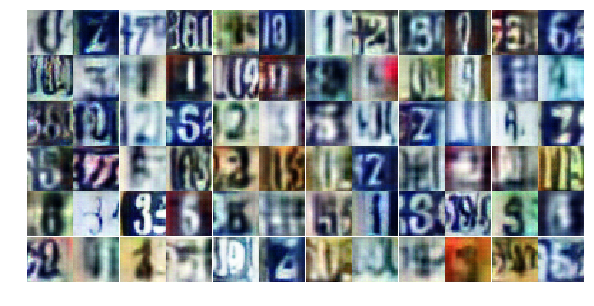

Epoch 16/28... Discriminator Loss: 1.2864... Generator Loss: 0.6336
Epoch 16/28... Discriminator Loss: 1.1814... Generator Loss: 1.1062
Epoch 16/28... Discriminator Loss: 1.1330... Generator Loss: 0.8013
Epoch 16/28... Discriminator Loss: 1.0301... Generator Loss: 0.9233
Epoch 16/28... Discriminator Loss: 0.4925... Generator Loss: 1.2844
Epoch 16/28... Discriminator Loss: 0.3362... Generator Loss: 2.4677
Epoch 16/28... Discriminator Loss: 2.1754... Generator Loss: 1.6834
Epoch 16/28... Discriminator Loss: 1.4493... Generator Loss: 2.0627
Epoch 16/28... Discriminator Loss: 1.1943... Generator Loss: 1.0296
Epoch 16/28... Discriminator Loss: 2.0034... Generator Loss: 0.2141


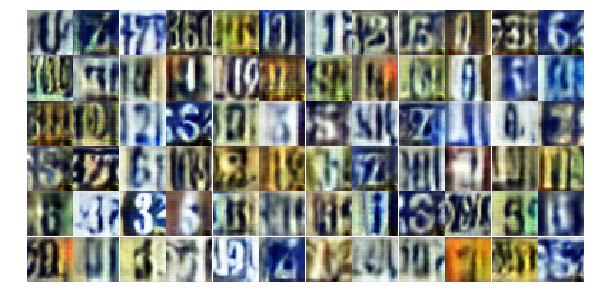

Epoch 16/28... Discriminator Loss: 0.7856... Generator Loss: 1.5773
Epoch 16/28... Discriminator Loss: 0.8663... Generator Loss: 1.6490
Epoch 16/28... Discriminator Loss: 1.0353... Generator Loss: 1.1524
Epoch 16/28... Discriminator Loss: 1.2051... Generator Loss: 0.8124
Epoch 16/28... Discriminator Loss: 1.2223... Generator Loss: 0.6988
Epoch 16/28... Discriminator Loss: 1.4530... Generator Loss: 0.7710
Epoch 16/28... Discriminator Loss: 1.2399... Generator Loss: 0.7588
Epoch 16/28... Discriminator Loss: 1.2179... Generator Loss: 0.6243
Epoch 16/28... Discriminator Loss: 1.2681... Generator Loss: 0.5309
Epoch 16/28... Discriminator Loss: 1.2396... Generator Loss: 0.8588


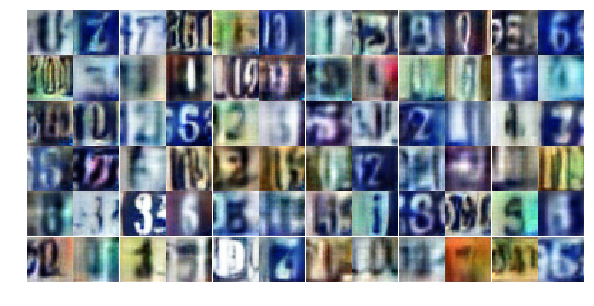

Epoch 16/28... Discriminator Loss: 1.2744... Generator Loss: 0.5962
Epoch 16/28... Discriminator Loss: 1.1434... Generator Loss: 0.7423
Epoch 16/28... Discriminator Loss: 1.3072... Generator Loss: 0.5407
Epoch 16/28... Discriminator Loss: 1.3100... Generator Loss: 0.6353
Epoch 16/28... Discriminator Loss: 1.3400... Generator Loss: 0.5522
Epoch 16/28... Discriminator Loss: 1.3954... Generator Loss: 0.4870
Epoch 16/28... Discriminator Loss: 1.2810... Generator Loss: 1.0372
Epoch 16/28... Discriminator Loss: 1.2111... Generator Loss: 0.7518
Epoch 16/28... Discriminator Loss: 1.2087... Generator Loss: 0.7810
Epoch 16/28... Discriminator Loss: 1.1888... Generator Loss: 0.7987


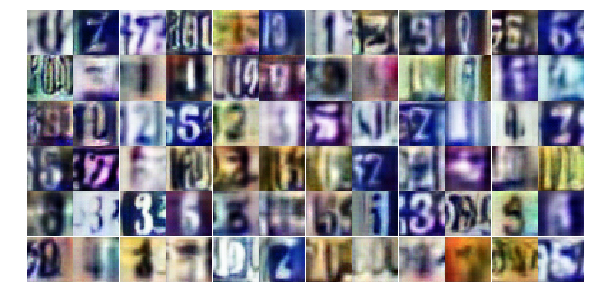

Epoch 16/28... Discriminator Loss: 1.3279... Generator Loss: 0.5878
Epoch 16/28... Discriminator Loss: 1.2742... Generator Loss: 0.8647
Epoch 16/28... Discriminator Loss: 1.5919... Generator Loss: 0.3376
Epoch 16/28... Discriminator Loss: 1.2904... Generator Loss: 0.6894
Epoch 16/28... Discriminator Loss: 1.6146... Generator Loss: 1.9648
Epoch 16/28... Discriminator Loss: 1.2443... Generator Loss: 0.7834
Epoch 17/28... Discriminator Loss: 1.3738... Generator Loss: 0.6641
Epoch 17/28... Discriminator Loss: 1.3062... Generator Loss: 0.7611
Epoch 17/28... Discriminator Loss: 1.2165... Generator Loss: 0.6615
Epoch 17/28... Discriminator Loss: 1.2303... Generator Loss: 0.6300


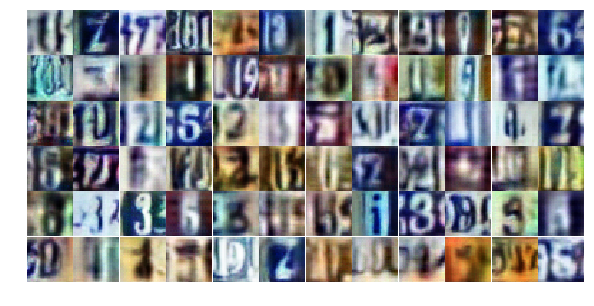

Epoch 17/28... Discriminator Loss: 1.2102... Generator Loss: 0.6791
Epoch 17/28... Discriminator Loss: 1.1005... Generator Loss: 1.0245
Epoch 17/28... Discriminator Loss: 1.2255... Generator Loss: 0.7104
Epoch 17/28... Discriminator Loss: 0.2082... Generator Loss: 3.6700
Epoch 17/28... Discriminator Loss: 0.1722... Generator Loss: 3.2744
Epoch 17/28... Discriminator Loss: 1.6941... Generator Loss: 2.6282
Epoch 17/28... Discriminator Loss: 0.1638... Generator Loss: 3.4182
Epoch 17/28... Discriminator Loss: 0.4491... Generator Loss: 2.3627
Epoch 17/28... Discriminator Loss: 0.0366... Generator Loss: 7.9213
Epoch 17/28... Discriminator Loss: 0.1200... Generator Loss: 4.8172


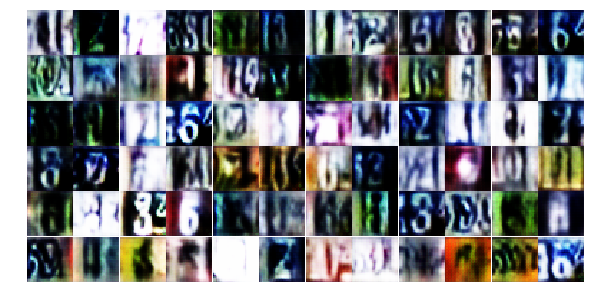

Epoch 17/28... Discriminator Loss: 0.2322... Generator Loss: 2.8282
Epoch 17/28... Discriminator Loss: 1.4441... Generator Loss: 1.5540
Epoch 17/28... Discriminator Loss: 1.2288... Generator Loss: 0.7320
Epoch 17/28... Discriminator Loss: 1.2396... Generator Loss: 0.8968
Epoch 17/28... Discriminator Loss: 1.1706... Generator Loss: 1.1815
Epoch 17/28... Discriminator Loss: 1.1456... Generator Loss: 1.2268
Epoch 17/28... Discriminator Loss: 1.2254... Generator Loss: 0.5088
Epoch 17/28... Discriminator Loss: 0.7389... Generator Loss: 1.6455
Epoch 17/28... Discriminator Loss: 0.2775... Generator Loss: 2.3850
Epoch 17/28... Discriminator Loss: 2.3683... Generator Loss: 2.4500


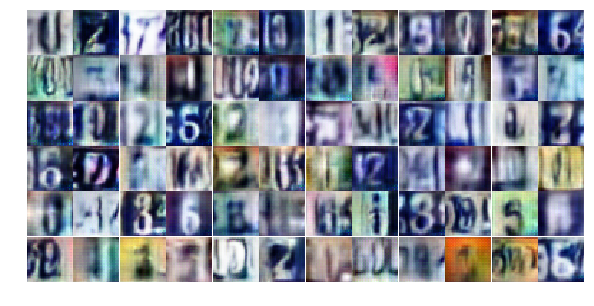

Epoch 17/28... Discriminator Loss: 1.2614... Generator Loss: 0.7058
Epoch 17/28... Discriminator Loss: 0.9191... Generator Loss: 1.0186
Epoch 17/28... Discriminator Loss: 1.0666... Generator Loss: 0.9597
Epoch 17/28... Discriminator Loss: 1.3549... Generator Loss: 0.4493
Epoch 17/28... Discriminator Loss: 1.5458... Generator Loss: 0.4337
Epoch 17/28... Discriminator Loss: 1.0162... Generator Loss: 0.8374
Epoch 17/28... Discriminator Loss: 1.0823... Generator Loss: 0.9613
Epoch 17/28... Discriminator Loss: 1.1648... Generator Loss: 0.7603
Epoch 17/28... Discriminator Loss: 1.4015... Generator Loss: 0.4272
Epoch 17/28... Discriminator Loss: 1.2238... Generator Loss: 0.7531


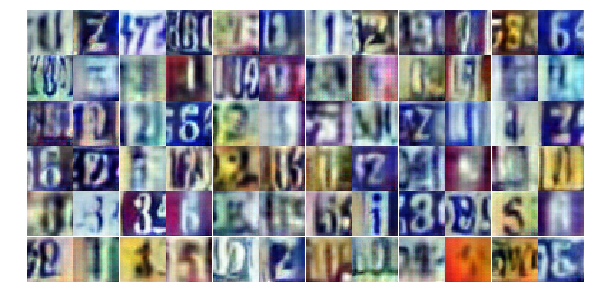

Epoch 17/28... Discriminator Loss: 1.2871... Generator Loss: 0.5077
Epoch 17/28... Discriminator Loss: 1.2308... Generator Loss: 0.6438
Epoch 17/28... Discriminator Loss: 1.0768... Generator Loss: 0.9160
Epoch 17/28... Discriminator Loss: 1.2761... Generator Loss: 0.5011
Epoch 17/28... Discriminator Loss: 1.1184... Generator Loss: 0.7565
Epoch 17/28... Discriminator Loss: 1.1850... Generator Loss: 0.8782
Epoch 17/28... Discriminator Loss: 1.2466... Generator Loss: 0.7562
Epoch 17/28... Discriminator Loss: 1.1238... Generator Loss: 0.6934
Epoch 17/28... Discriminator Loss: 1.0295... Generator Loss: 0.7941
Epoch 17/28... Discriminator Loss: 1.2429... Generator Loss: 0.5624


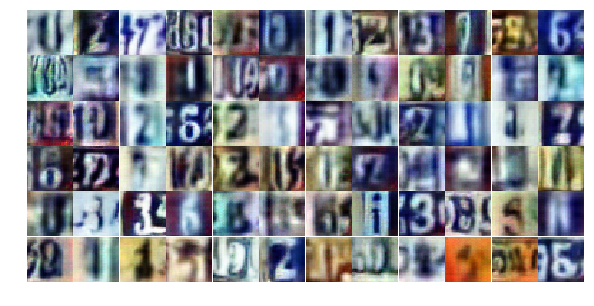

Epoch 17/28... Discriminator Loss: 1.3482... Generator Loss: 1.1843
Epoch 17/28... Discriminator Loss: 1.0986... Generator Loss: 1.1279
Epoch 17/28... Discriminator Loss: 1.5003... Generator Loss: 0.3499
Epoch 17/28... Discriminator Loss: 0.9420... Generator Loss: 1.0616
Epoch 17/28... Discriminator Loss: 1.1733... Generator Loss: 0.6896
Epoch 17/28... Discriminator Loss: 1.2487... Generator Loss: 0.8650
Epoch 17/28... Discriminator Loss: 1.1590... Generator Loss: 0.7201
Epoch 17/28... Discriminator Loss: 1.0878... Generator Loss: 1.0015
Epoch 17/28... Discriminator Loss: 1.1535... Generator Loss: 0.8602
Epoch 17/28... Discriminator Loss: 1.2277... Generator Loss: 0.5954


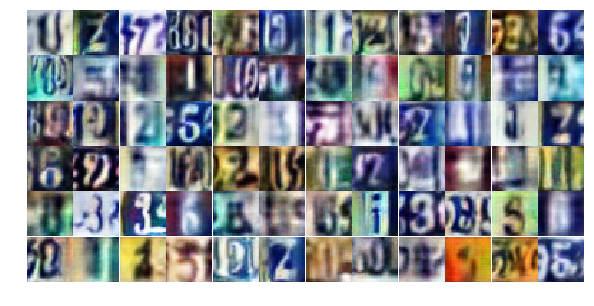

Epoch 17/28... Discriminator Loss: 1.1230... Generator Loss: 1.0553
Epoch 17/28... Discriminator Loss: 1.3156... Generator Loss: 0.5057
Epoch 17/28... Discriminator Loss: 1.1208... Generator Loss: 0.8322
Epoch 17/28... Discriminator Loss: 1.1209... Generator Loss: 0.8887
Epoch 18/28... Discriminator Loss: 1.1715... Generator Loss: 0.6880
Epoch 18/28... Discriminator Loss: 1.1617... Generator Loss: 0.6981
Epoch 18/28... Discriminator Loss: 1.1226... Generator Loss: 0.9341
Epoch 18/28... Discriminator Loss: 1.0757... Generator Loss: 0.8865
Epoch 18/28... Discriminator Loss: 1.2423... Generator Loss: 0.6132
Epoch 18/28... Discriminator Loss: 1.1353... Generator Loss: 0.7084


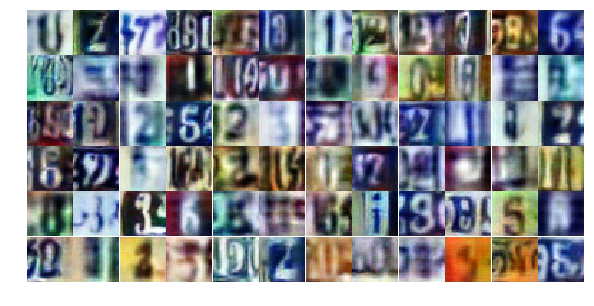

Epoch 18/28... Discriminator Loss: 1.0641... Generator Loss: 1.0503
Epoch 18/28... Discriminator Loss: 1.2526... Generator Loss: 0.5688
Epoch 18/28... Discriminator Loss: 1.0699... Generator Loss: 1.0342
Epoch 18/28... Discriminator Loss: 1.1074... Generator Loss: 0.9637
Epoch 18/28... Discriminator Loss: 1.2192... Generator Loss: 0.7653
Epoch 18/28... Discriminator Loss: 1.3000... Generator Loss: 0.5548
Epoch 18/28... Discriminator Loss: 1.1036... Generator Loss: 0.9122
Epoch 18/28... Discriminator Loss: 1.1593... Generator Loss: 0.6927
Epoch 18/28... Discriminator Loss: 1.1582... Generator Loss: 1.1288
Epoch 18/28... Discriminator Loss: 1.0897... Generator Loss: 0.7154


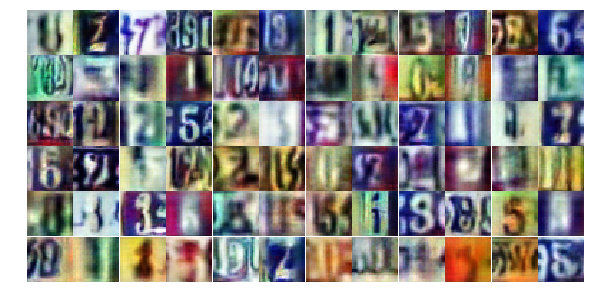

Epoch 18/28... Discriminator Loss: 1.3295... Generator Loss: 0.5989
Epoch 18/28... Discriminator Loss: 1.0612... Generator Loss: 1.0826
Epoch 18/28... Discriminator Loss: 1.2851... Generator Loss: 0.7933
Epoch 18/28... Discriminator Loss: 1.0375... Generator Loss: 0.9491
Epoch 18/28... Discriminator Loss: 1.1044... Generator Loss: 0.8631
Epoch 18/28... Discriminator Loss: 1.0114... Generator Loss: 1.0752
Epoch 18/28... Discriminator Loss: 1.0988... Generator Loss: 0.9010
Epoch 18/28... Discriminator Loss: 1.0287... Generator Loss: 1.1329
Epoch 18/28... Discriminator Loss: 1.2843... Generator Loss: 0.6268
Epoch 18/28... Discriminator Loss: 1.1114... Generator Loss: 1.2635


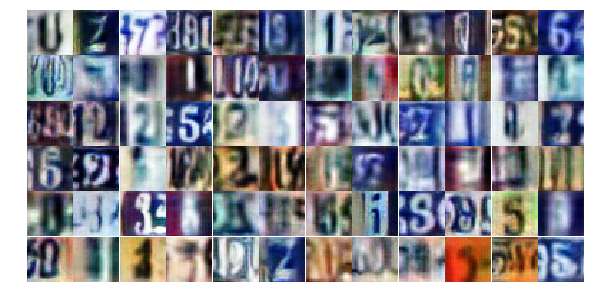

Epoch 18/28... Discriminator Loss: 1.1169... Generator Loss: 0.6621
Epoch 18/28... Discriminator Loss: 1.4757... Generator Loss: 1.9621
Epoch 18/28... Discriminator Loss: 1.1679... Generator Loss: 0.7757
Epoch 18/28... Discriminator Loss: 1.1327... Generator Loss: 1.0699
Epoch 18/28... Discriminator Loss: 1.1644... Generator Loss: 0.6601
Epoch 18/28... Discriminator Loss: 1.1297... Generator Loss: 0.7718
Epoch 18/28... Discriminator Loss: 1.1185... Generator Loss: 0.9726
Epoch 18/28... Discriminator Loss: 1.2639... Generator Loss: 0.5262
Epoch 18/28... Discriminator Loss: 1.1172... Generator Loss: 0.8234
Epoch 18/28... Discriminator Loss: 1.2359... Generator Loss: 1.1994


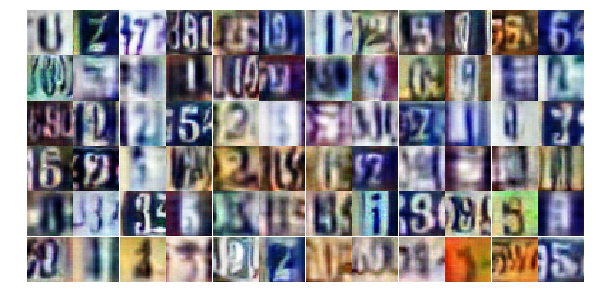

Epoch 18/28... Discriminator Loss: 1.0207... Generator Loss: 1.0424
Epoch 18/28... Discriminator Loss: 1.2023... Generator Loss: 0.7143
Epoch 18/28... Discriminator Loss: 1.1382... Generator Loss: 0.7102
Epoch 18/28... Discriminator Loss: 1.0274... Generator Loss: 1.2379
Epoch 18/28... Discriminator Loss: 1.1284... Generator Loss: 1.0053
Epoch 18/28... Discriminator Loss: 0.8968... Generator Loss: 1.0523
Epoch 18/28... Discriminator Loss: 0.9038... Generator Loss: 1.3305
Epoch 18/28... Discriminator Loss: 1.6398... Generator Loss: 1.7418
Epoch 18/28... Discriminator Loss: 1.0042... Generator Loss: 0.9337
Epoch 18/28... Discriminator Loss: 0.8261... Generator Loss: 1.2336


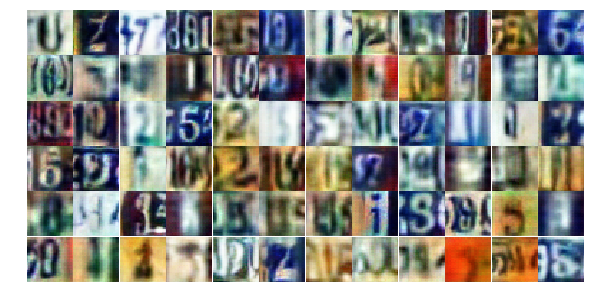

Epoch 18/28... Discriminator Loss: 1.1251... Generator Loss: 0.7566
Epoch 18/28... Discriminator Loss: 1.3581... Generator Loss: 0.4413
Epoch 18/28... Discriminator Loss: 1.3128... Generator Loss: 0.4701
Epoch 18/28... Discriminator Loss: 1.4092... Generator Loss: 0.9966
Epoch 18/28... Discriminator Loss: 1.2761... Generator Loss: 0.6251
Epoch 18/28... Discriminator Loss: 1.1308... Generator Loss: 1.1335
Epoch 18/28... Discriminator Loss: 1.1165... Generator Loss: 1.1245
Epoch 18/28... Discriminator Loss: 1.0760... Generator Loss: 0.7342
Epoch 18/28... Discriminator Loss: 1.1708... Generator Loss: 0.5734
Epoch 18/28... Discriminator Loss: 0.8330... Generator Loss: 1.0288


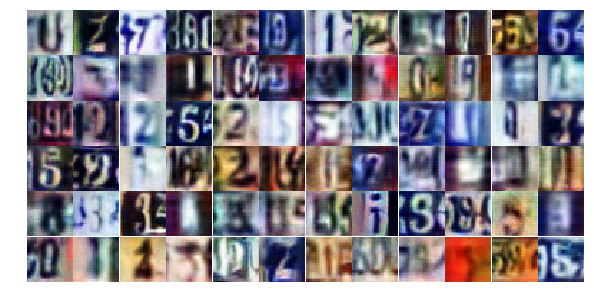

Epoch 18/28... Discriminator Loss: 0.8356... Generator Loss: 1.3767
Epoch 19/28... Discriminator Loss: 2.3292... Generator Loss: 0.1397
Epoch 19/28... Discriminator Loss: 1.3378... Generator Loss: 0.5762
Epoch 19/28... Discriminator Loss: 1.2216... Generator Loss: 0.8578
Epoch 19/28... Discriminator Loss: 1.1513... Generator Loss: 0.9886
Epoch 19/28... Discriminator Loss: 1.2649... Generator Loss: 0.6771
Epoch 19/28... Discriminator Loss: 1.2720... Generator Loss: 0.5587
Epoch 19/28... Discriminator Loss: 1.1989... Generator Loss: 0.7016
Epoch 19/28... Discriminator Loss: 1.1298... Generator Loss: 0.8054
Epoch 19/28... Discriminator Loss: 1.0519... Generator Loss: 0.8819


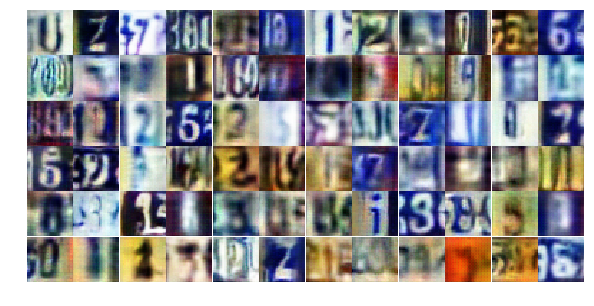

Epoch 19/28... Discriminator Loss: 0.6566... Generator Loss: 2.4433
Epoch 19/28... Discriminator Loss: 1.1596... Generator Loss: 0.4807
Epoch 19/28... Discriminator Loss: 1.1804... Generator Loss: 0.8035
Epoch 19/28... Discriminator Loss: 1.1479... Generator Loss: 0.8146
Epoch 19/28... Discriminator Loss: 1.1328... Generator Loss: 0.7281
Epoch 19/28... Discriminator Loss: 1.1726... Generator Loss: 0.9144
Epoch 19/28... Discriminator Loss: 1.1455... Generator Loss: 0.7820
Epoch 19/28... Discriminator Loss: 0.9442... Generator Loss: 1.0575
Epoch 19/28... Discriminator Loss: 1.2713... Generator Loss: 0.7761
Epoch 19/28... Discriminator Loss: 1.3994... Generator Loss: 0.4893


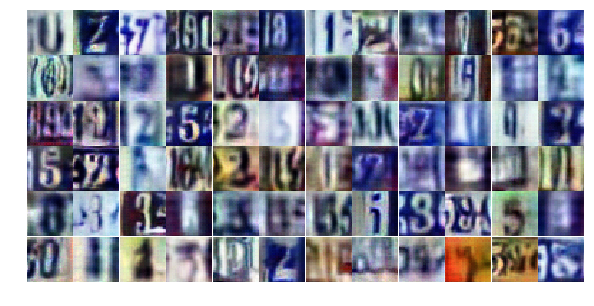

Epoch 19/28... Discriminator Loss: 1.1611... Generator Loss: 0.6871
Epoch 19/28... Discriminator Loss: 1.3150... Generator Loss: 0.5869
Epoch 19/28... Discriminator Loss: 1.1271... Generator Loss: 0.8736
Epoch 19/28... Discriminator Loss: 1.2289... Generator Loss: 0.5766
Epoch 19/28... Discriminator Loss: 1.2098... Generator Loss: 0.6506
Epoch 19/28... Discriminator Loss: 1.1689... Generator Loss: 0.9420
Epoch 19/28... Discriminator Loss: 1.2628... Generator Loss: 0.7059
Epoch 19/28... Discriminator Loss: 1.1029... Generator Loss: 0.8712
Epoch 19/28... Discriminator Loss: 1.1339... Generator Loss: 0.6746
Epoch 19/28... Discriminator Loss: 1.1046... Generator Loss: 0.8030


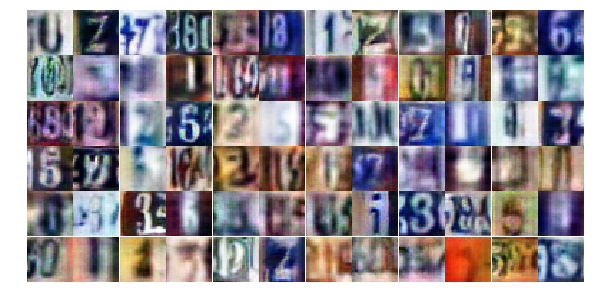

Epoch 19/28... Discriminator Loss: 1.1753... Generator Loss: 1.7720
Epoch 19/28... Discriminator Loss: 1.0420... Generator Loss: 1.2804
Epoch 19/28... Discriminator Loss: 0.9331... Generator Loss: 0.9937
Epoch 19/28... Discriminator Loss: 1.2045... Generator Loss: 0.5987
Epoch 19/28... Discriminator Loss: 1.0714... Generator Loss: 0.6590
Epoch 19/28... Discriminator Loss: 0.7818... Generator Loss: 1.3654
Epoch 19/28... Discriminator Loss: 1.8737... Generator Loss: 3.1767
Epoch 19/28... Discriminator Loss: 1.4361... Generator Loss: 1.0626
Epoch 19/28... Discriminator Loss: 1.0929... Generator Loss: 0.8888
Epoch 19/28... Discriminator Loss: 1.1441... Generator Loss: 0.9002


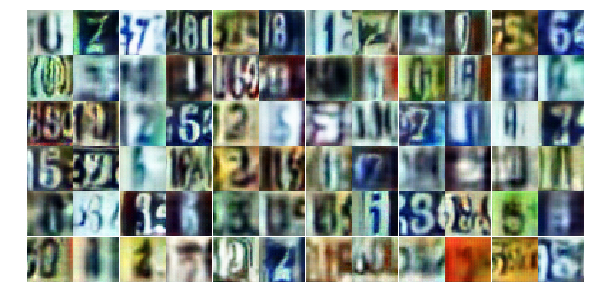

Epoch 19/28... Discriminator Loss: 1.0658... Generator Loss: 0.9527
Epoch 19/28... Discriminator Loss: 1.0800... Generator Loss: 0.8475
Epoch 19/28... Discriminator Loss: 1.1934... Generator Loss: 0.5742
Epoch 19/28... Discriminator Loss: 1.1062... Generator Loss: 0.8987
Epoch 19/28... Discriminator Loss: 1.1969... Generator Loss: 0.9812
Epoch 19/28... Discriminator Loss: 1.1952... Generator Loss: 0.9050
Epoch 19/28... Discriminator Loss: 1.1052... Generator Loss: 1.1004
Epoch 19/28... Discriminator Loss: 1.1489... Generator Loss: 0.7922
Epoch 19/28... Discriminator Loss: 1.1961... Generator Loss: 0.7565
Epoch 19/28... Discriminator Loss: 1.1032... Generator Loss: 0.7288


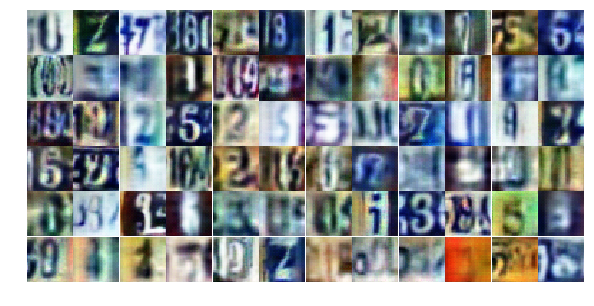

Epoch 19/28... Discriminator Loss: 1.4193... Generator Loss: 0.4392
Epoch 19/28... Discriminator Loss: 1.3611... Generator Loss: 0.5632
Epoch 19/28... Discriminator Loss: 1.3139... Generator Loss: 0.4868
Epoch 19/28... Discriminator Loss: 0.7660... Generator Loss: 0.8988
Epoch 19/28... Discriminator Loss: 0.1106... Generator Loss: 3.5060
Epoch 19/28... Discriminator Loss: 0.3021... Generator Loss: 1.6659
Epoch 19/28... Discriminator Loss: 1.3327... Generator Loss: 0.4912
Epoch 19/28... Discriminator Loss: 1.0964... Generator Loss: 0.7879
Epoch 20/28... Discriminator Loss: 1.0324... Generator Loss: 0.9582
Epoch 20/28... Discriminator Loss: 1.2060... Generator Loss: 1.2929


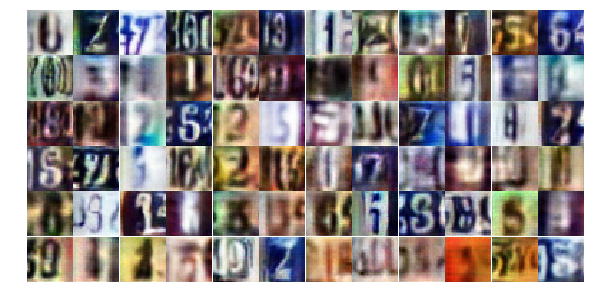

Epoch 20/28... Discriminator Loss: 1.1652... Generator Loss: 0.5664
Epoch 20/28... Discriminator Loss: 1.2899... Generator Loss: 1.2589
Epoch 20/28... Discriminator Loss: 1.4359... Generator Loss: 0.5481
Epoch 20/28... Discriminator Loss: 1.2615... Generator Loss: 0.5238
Epoch 20/28... Discriminator Loss: 1.0852... Generator Loss: 1.3200
Epoch 20/28... Discriminator Loss: 1.1047... Generator Loss: 0.8602
Epoch 20/28... Discriminator Loss: 1.0849... Generator Loss: 1.0851
Epoch 20/28... Discriminator Loss: 1.1501... Generator Loss: 0.8392
Epoch 20/28... Discriminator Loss: 1.2323... Generator Loss: 0.6074
Epoch 20/28... Discriminator Loss: 1.0649... Generator Loss: 0.9919


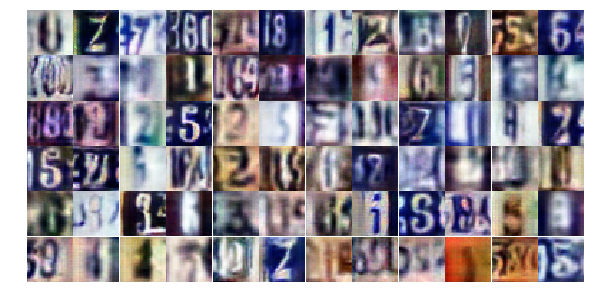

Epoch 20/28... Discriminator Loss: 1.1833... Generator Loss: 0.6527
Epoch 20/28... Discriminator Loss: 1.2652... Generator Loss: 0.6422
Epoch 20/28... Discriminator Loss: 1.1834... Generator Loss: 0.6030
Epoch 20/28... Discriminator Loss: 1.4052... Generator Loss: 0.4314
Epoch 20/28... Discriminator Loss: 1.3236... Generator Loss: 0.5661
Epoch 20/28... Discriminator Loss: 1.0037... Generator Loss: 1.3041
Epoch 20/28... Discriminator Loss: 1.2428... Generator Loss: 0.6611
Epoch 20/28... Discriminator Loss: 1.3135... Generator Loss: 0.5905
Epoch 20/28... Discriminator Loss: 1.1466... Generator Loss: 1.1956
Epoch 20/28... Discriminator Loss: 1.0720... Generator Loss: 0.8374


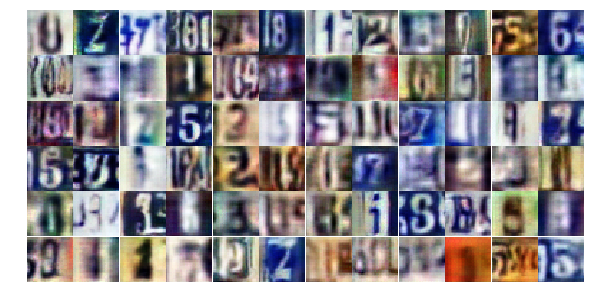

Epoch 20/28... Discriminator Loss: 1.0948... Generator Loss: 0.6529
Epoch 20/28... Discriminator Loss: 1.4797... Generator Loss: 0.4488
Epoch 20/28... Discriminator Loss: 1.1188... Generator Loss: 1.4552
Epoch 20/28... Discriminator Loss: 1.2546... Generator Loss: 0.5483
Epoch 20/28... Discriminator Loss: 1.3853... Generator Loss: 0.6400
Epoch 20/28... Discriminator Loss: 1.3173... Generator Loss: 1.6926
Epoch 20/28... Discriminator Loss: 1.4383... Generator Loss: 1.5139
Epoch 20/28... Discriminator Loss: 1.2030... Generator Loss: 0.8065
Epoch 20/28... Discriminator Loss: 1.2773... Generator Loss: 0.6024
Epoch 20/28... Discriminator Loss: 1.0785... Generator Loss: 0.6969


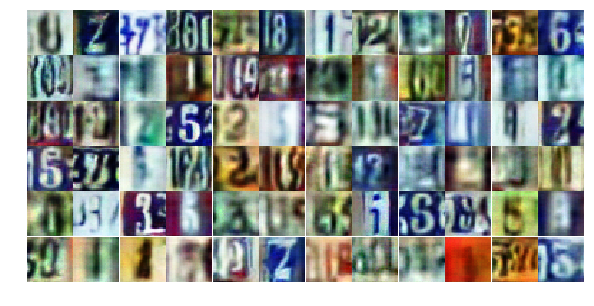

Epoch 20/28... Discriminator Loss: 0.8695... Generator Loss: 0.9945
Epoch 20/28... Discriminator Loss: 1.4468... Generator Loss: 1.3378
Epoch 20/28... Discriminator Loss: 1.2854... Generator Loss: 0.9130
Epoch 20/28... Discriminator Loss: 1.1488... Generator Loss: 0.9665
Epoch 20/28... Discriminator Loss: 1.2573... Generator Loss: 0.5842
Epoch 20/28... Discriminator Loss: 1.3428... Generator Loss: 0.8457
Epoch 20/28... Discriminator Loss: 1.1673... Generator Loss: 1.1540
Epoch 20/28... Discriminator Loss: 1.1194... Generator Loss: 0.8139
Epoch 20/28... Discriminator Loss: 1.2418... Generator Loss: 0.5397
Epoch 20/28... Discriminator Loss: 1.4423... Generator Loss: 0.4122


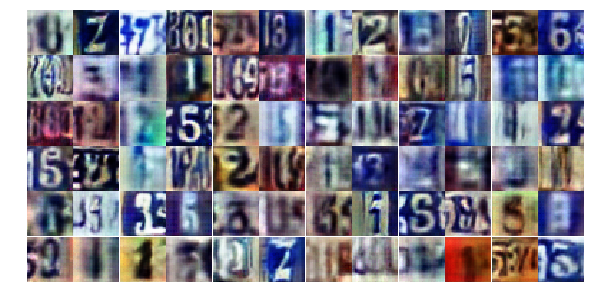

Epoch 20/28... Discriminator Loss: 0.5732... Generator Loss: 2.0183
Epoch 20/28... Discriminator Loss: 0.7529... Generator Loss: 2.4017
Epoch 20/28... Discriminator Loss: 1.4676... Generator Loss: 1.1363
Epoch 20/28... Discriminator Loss: 1.4410... Generator Loss: 0.7834
Epoch 20/28... Discriminator Loss: 1.2147... Generator Loss: 0.9045
Epoch 20/28... Discriminator Loss: 1.4420... Generator Loss: 0.4056
Epoch 20/28... Discriminator Loss: 1.2983... Generator Loss: 0.5962
Epoch 20/28... Discriminator Loss: 1.1581... Generator Loss: 0.8935
Epoch 20/28... Discriminator Loss: 1.1586... Generator Loss: 0.8273
Epoch 20/28... Discriminator Loss: 1.0977... Generator Loss: 0.8817


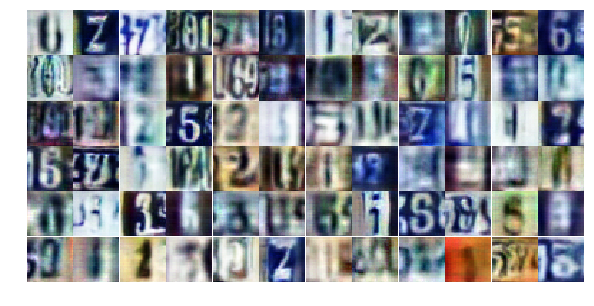

Epoch 20/28... Discriminator Loss: 1.0538... Generator Loss: 1.0944
Epoch 20/28... Discriminator Loss: 0.9048... Generator Loss: 0.9320
Epoch 20/28... Discriminator Loss: 1.0453... Generator Loss: 1.0345
Epoch 20/28... Discriminator Loss: 1.5811... Generator Loss: 1.8619
Epoch 20/28... Discriminator Loss: 1.0690... Generator Loss: 0.8531
Epoch 20/28... Discriminator Loss: 1.0547... Generator Loss: 0.6024
Epoch 21/28... Discriminator Loss: 1.1865... Generator Loss: 0.9497
Epoch 21/28... Discriminator Loss: 1.0351... Generator Loss: 0.9377
Epoch 21/28... Discriminator Loss: 1.4114... Generator Loss: 0.4412
Epoch 21/28... Discriminator Loss: 1.0607... Generator Loss: 0.6242


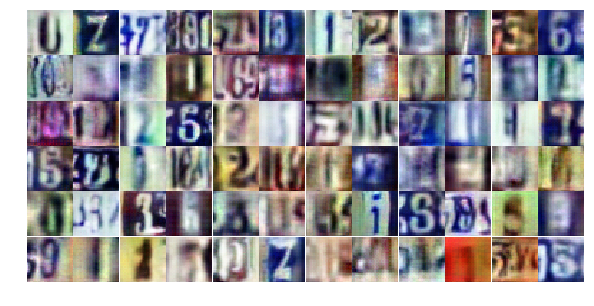

Epoch 21/28... Discriminator Loss: 1.1024... Generator Loss: 0.9355
Epoch 21/28... Discriminator Loss: 1.3258... Generator Loss: 0.7036
Epoch 21/28... Discriminator Loss: 1.1979... Generator Loss: 0.6527
Epoch 21/28... Discriminator Loss: 0.8960... Generator Loss: 0.9902
Epoch 21/28... Discriminator Loss: 1.2243... Generator Loss: 0.6285
Epoch 21/28... Discriminator Loss: 1.1324... Generator Loss: 0.6731
Epoch 21/28... Discriminator Loss: 1.0940... Generator Loss: 1.0228
Epoch 21/28... Discriminator Loss: 1.0923... Generator Loss: 0.7806
Epoch 21/28... Discriminator Loss: 1.1649... Generator Loss: 0.5959
Epoch 21/28... Discriminator Loss: 0.9795... Generator Loss: 0.7765


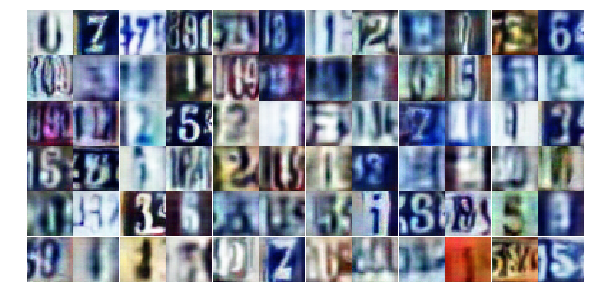

Epoch 21/28... Discriminator Loss: 0.9566... Generator Loss: 1.1591
Epoch 21/28... Discriminator Loss: 1.1146... Generator Loss: 0.7930
Epoch 21/28... Discriminator Loss: 1.0534... Generator Loss: 1.0413
Epoch 21/28... Discriminator Loss: 1.0115... Generator Loss: 0.9581
Epoch 21/28... Discriminator Loss: 0.6051... Generator Loss: 1.0671
Epoch 21/28... Discriminator Loss: 3.9876... Generator Loss: 3.3669
Epoch 21/28... Discriminator Loss: 1.3434... Generator Loss: 0.7607
Epoch 21/28... Discriminator Loss: 1.2737... Generator Loss: 0.9838
Epoch 21/28... Discriminator Loss: 1.1407... Generator Loss: 1.0251
Epoch 21/28... Discriminator Loss: 1.3900... Generator Loss: 0.6406


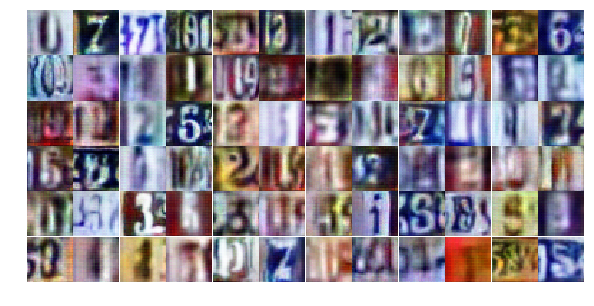

Epoch 21/28... Discriminator Loss: 1.2842... Generator Loss: 0.8320
Epoch 21/28... Discriminator Loss: 1.0659... Generator Loss: 1.0011
Epoch 21/28... Discriminator Loss: 1.1903... Generator Loss: 0.7416
Epoch 21/28... Discriminator Loss: 1.0902... Generator Loss: 0.8923
Epoch 21/28... Discriminator Loss: 1.1574... Generator Loss: 0.7279
Epoch 21/28... Discriminator Loss: 1.2749... Generator Loss: 0.7479
Epoch 21/28... Discriminator Loss: 1.0553... Generator Loss: 0.9954
Epoch 21/28... Discriminator Loss: 1.1085... Generator Loss: 0.7573
Epoch 21/28... Discriminator Loss: 1.0432... Generator Loss: 1.1202
Epoch 21/28... Discriminator Loss: 1.3215... Generator Loss: 0.6553


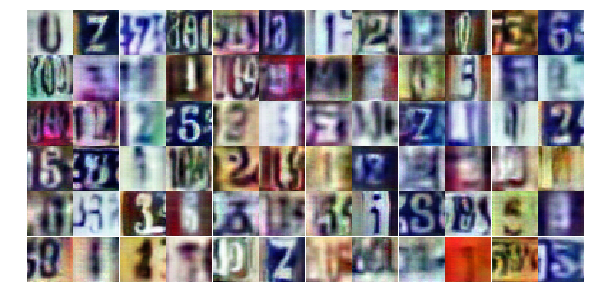

Epoch 21/28... Discriminator Loss: 1.2701... Generator Loss: 0.6187
Epoch 21/28... Discriminator Loss: 1.2895... Generator Loss: 0.5365
Epoch 21/28... Discriminator Loss: 1.2392... Generator Loss: 0.6168
Epoch 21/28... Discriminator Loss: 1.0347... Generator Loss: 0.9925
Epoch 21/28... Discriminator Loss: 0.9903... Generator Loss: 0.8809
Epoch 21/28... Discriminator Loss: 1.0278... Generator Loss: 0.9493
Epoch 21/28... Discriminator Loss: 1.3850... Generator Loss: 0.4676
Epoch 21/28... Discriminator Loss: 1.1328... Generator Loss: 0.5956
Epoch 21/28... Discriminator Loss: 1.0399... Generator Loss: 0.9507
Epoch 21/28... Discriminator Loss: 1.1169... Generator Loss: 1.2699


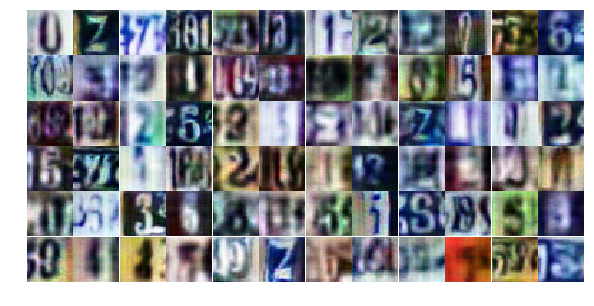

Epoch 21/28... Discriminator Loss: 1.3904... Generator Loss: 0.6915
Epoch 21/28... Discriminator Loss: 1.4600... Generator Loss: 0.6393
Epoch 21/28... Discriminator Loss: 1.3374... Generator Loss: 0.7595
Epoch 21/28... Discriminator Loss: 1.3160... Generator Loss: 0.7074
Epoch 21/28... Discriminator Loss: 1.3056... Generator Loss: 0.7850
Epoch 21/28... Discriminator Loss: 1.2890... Generator Loss: 0.8034
Epoch 21/28... Discriminator Loss: 1.2555... Generator Loss: 0.8160
Epoch 21/28... Discriminator Loss: 1.5212... Generator Loss: 0.4161
Epoch 21/28... Discriminator Loss: 1.1012... Generator Loss: 0.6378
Epoch 21/28... Discriminator Loss: 1.1218... Generator Loss: 1.1757


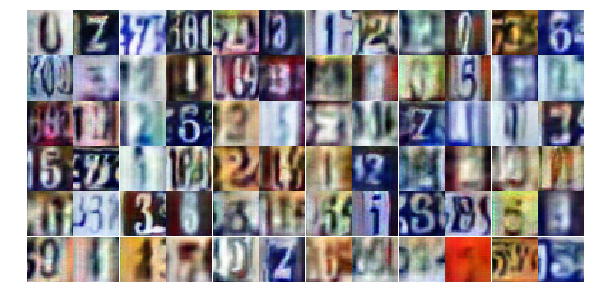

Epoch 21/28... Discriminator Loss: 1.0009... Generator Loss: 0.9029
Epoch 21/28... Discriminator Loss: 1.2983... Generator Loss: 0.6141
Epoch 21/28... Discriminator Loss: 1.1561... Generator Loss: 0.9970
Epoch 22/28... Discriminator Loss: 1.2750... Generator Loss: 0.8940
Epoch 22/28... Discriminator Loss: 1.1262... Generator Loss: 1.0383
Epoch 22/28... Discriminator Loss: 0.9128... Generator Loss: 0.9934
Epoch 22/28... Discriminator Loss: 0.9373... Generator Loss: 0.7945
Epoch 22/28... Discriminator Loss: 1.3976... Generator Loss: 0.9063
Epoch 22/28... Discriminator Loss: 1.7899... Generator Loss: 0.2764
Epoch 22/28... Discriminator Loss: 1.2071... Generator Loss: 1.3040


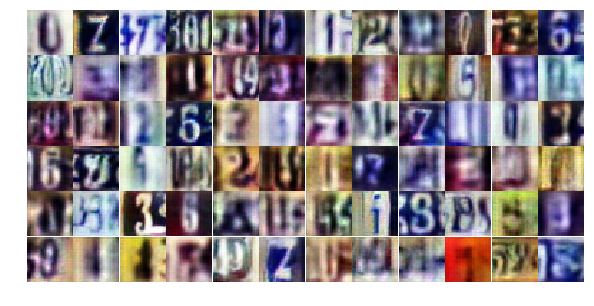

Epoch 22/28... Discriminator Loss: 1.2763... Generator Loss: 0.8263
Epoch 22/28... Discriminator Loss: 1.2147... Generator Loss: 0.7649
Epoch 22/28... Discriminator Loss: 1.1712... Generator Loss: 0.7640
Epoch 22/28... Discriminator Loss: 1.1263... Generator Loss: 0.7945
Epoch 22/28... Discriminator Loss: 1.2535... Generator Loss: 0.6067
Epoch 22/28... Discriminator Loss: 1.0736... Generator Loss: 0.7820
Epoch 22/28... Discriminator Loss: 1.1275... Generator Loss: 1.2205
Epoch 22/28... Discriminator Loss: 1.0343... Generator Loss: 0.7065
Epoch 22/28... Discriminator Loss: 1.2268... Generator Loss: 0.6617
Epoch 22/28... Discriminator Loss: 1.4182... Generator Loss: 0.3868


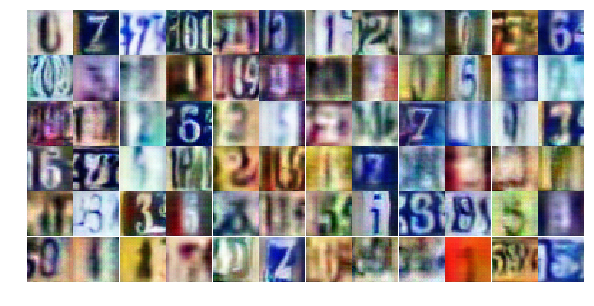

Epoch 22/28... Discriminator Loss: 1.1103... Generator Loss: 0.7294
Epoch 22/28... Discriminator Loss: 1.0535... Generator Loss: 1.1132
Epoch 22/28... Discriminator Loss: 1.1824... Generator Loss: 0.7397
Epoch 22/28... Discriminator Loss: 1.0188... Generator Loss: 1.0846
Epoch 22/28... Discriminator Loss: 1.0422... Generator Loss: 0.9590
Epoch 22/28... Discriminator Loss: 1.1383... Generator Loss: 1.0060
Epoch 22/28... Discriminator Loss: 0.9993... Generator Loss: 1.0753
Epoch 22/28... Discriminator Loss: 0.9234... Generator Loss: 1.1117
Epoch 22/28... Discriminator Loss: 1.0147... Generator Loss: 0.8059
Epoch 22/28... Discriminator Loss: 1.2790... Generator Loss: 0.5493


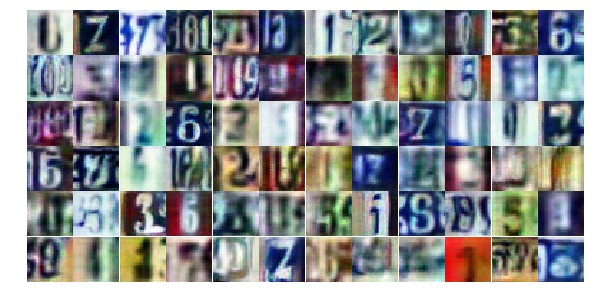

Epoch 22/28... Discriminator Loss: 1.2213... Generator Loss: 0.7009
Epoch 22/28... Discriminator Loss: 0.5533... Generator Loss: 2.0577
Epoch 22/28... Discriminator Loss: 1.0041... Generator Loss: 1.0669
Epoch 22/28... Discriminator Loss: 1.0592... Generator Loss: 0.8314
Epoch 22/28... Discriminator Loss: 1.2317... Generator Loss: 0.5700
Epoch 22/28... Discriminator Loss: 1.0309... Generator Loss: 0.8083
Epoch 22/28... Discriminator Loss: 1.4692... Generator Loss: 0.3811
Epoch 22/28... Discriminator Loss: 1.0676... Generator Loss: 0.6758
Epoch 22/28... Discriminator Loss: 1.1611... Generator Loss: 0.6823
Epoch 22/28... Discriminator Loss: 0.3214... Generator Loss: 4.2989


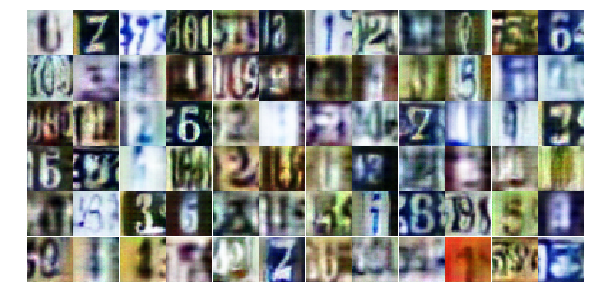

Epoch 22/28... Discriminator Loss: 0.3658... Generator Loss: 1.9024
Epoch 22/28... Discriminator Loss: 0.2591... Generator Loss: 1.8919
Epoch 22/28... Discriminator Loss: 0.4365... Generator Loss: 2.0069
Epoch 22/28... Discriminator Loss: 0.8380... Generator Loss: 0.9936
Epoch 22/28... Discriminator Loss: 0.9546... Generator Loss: 0.9291
Epoch 22/28... Discriminator Loss: 0.8920... Generator Loss: 1.3256
Epoch 22/28... Discriminator Loss: 1.2184... Generator Loss: 1.0542
Epoch 22/28... Discriminator Loss: 1.2032... Generator Loss: 0.8028
Epoch 22/28... Discriminator Loss: 1.4598... Generator Loss: 0.4060
Epoch 22/28... Discriminator Loss: 1.3294... Generator Loss: 1.7005


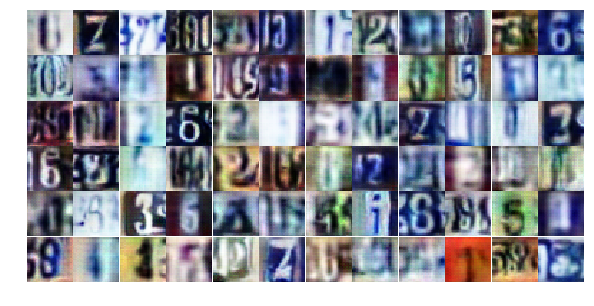

Epoch 22/28... Discriminator Loss: 1.1593... Generator Loss: 0.6597
Epoch 22/28... Discriminator Loss: 1.0139... Generator Loss: 1.0632
Epoch 22/28... Discriminator Loss: 0.9982... Generator Loss: 1.1980
Epoch 22/28... Discriminator Loss: 1.1804... Generator Loss: 1.0601
Epoch 22/28... Discriminator Loss: 1.0234... Generator Loss: 1.3960
Epoch 22/28... Discriminator Loss: 0.9453... Generator Loss: 1.7962
Epoch 22/28... Discriminator Loss: 1.2430... Generator Loss: 0.4958
Epoch 22/28... Discriminator Loss: 0.9540... Generator Loss: 0.8607
Epoch 22/28... Discriminator Loss: 1.4820... Generator Loss: 0.3749
Epoch 22/28... Discriminator Loss: 1.0943... Generator Loss: 0.8650


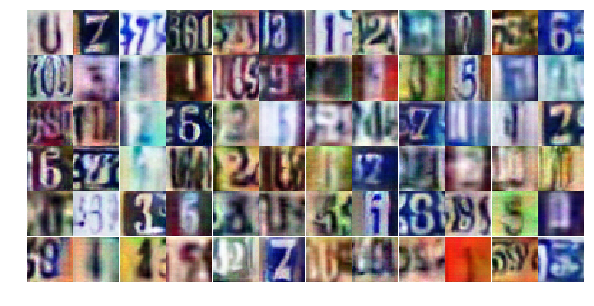

Epoch 23/28... Discriminator Loss: 0.9677... Generator Loss: 0.8814
Epoch 23/28... Discriminator Loss: 0.9799... Generator Loss: 0.8760
Epoch 23/28... Discriminator Loss: 1.0517... Generator Loss: 0.7469
Epoch 23/28... Discriminator Loss: 1.0420... Generator Loss: 0.8714
Epoch 23/28... Discriminator Loss: 1.1174... Generator Loss: 0.9044
Epoch 23/28... Discriminator Loss: 0.9001... Generator Loss: 0.7500
Epoch 23/28... Discriminator Loss: 1.2337... Generator Loss: 0.9077
Epoch 23/28... Discriminator Loss: 1.2583... Generator Loss: 0.5506
Epoch 23/28... Discriminator Loss: 0.9548... Generator Loss: 1.1389
Epoch 23/28... Discriminator Loss: 0.9058... Generator Loss: 1.0904


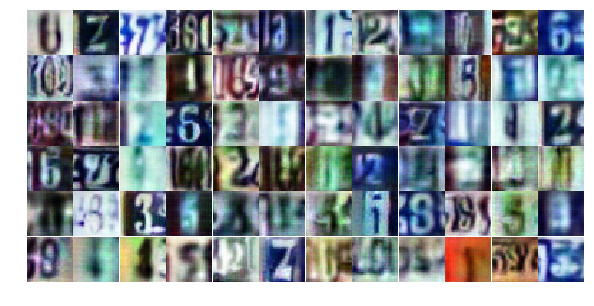

Epoch 23/28... Discriminator Loss: 0.7238... Generator Loss: 1.6874
Epoch 23/28... Discriminator Loss: 0.8071... Generator Loss: 3.1296
Epoch 23/28... Discriminator Loss: 1.0781... Generator Loss: 0.9992
Epoch 23/28... Discriminator Loss: 1.3138... Generator Loss: 0.7265
Epoch 23/28... Discriminator Loss: 0.9900... Generator Loss: 0.9877
Epoch 23/28... Discriminator Loss: 1.2178... Generator Loss: 0.7287
Epoch 23/28... Discriminator Loss: 1.1457... Generator Loss: 1.0573
Epoch 23/28... Discriminator Loss: 0.9024... Generator Loss: 1.0542
Epoch 23/28... Discriminator Loss: 1.0465... Generator Loss: 0.7644
Epoch 23/28... Discriminator Loss: 1.2264... Generator Loss: 0.6932


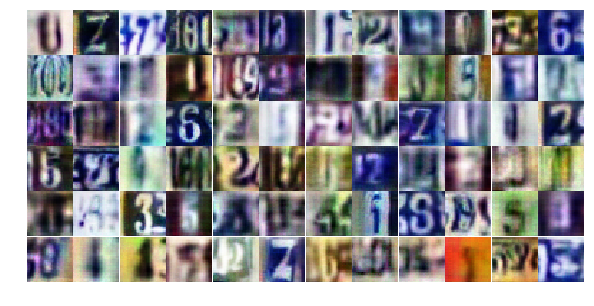

Epoch 23/28... Discriminator Loss: 1.1814... Generator Loss: 0.8418
Epoch 23/28... Discriminator Loss: 0.8533... Generator Loss: 1.2449
Epoch 23/28... Discriminator Loss: 1.0719... Generator Loss: 0.8027
Epoch 23/28... Discriminator Loss: 1.1489... Generator Loss: 1.1098
Epoch 23/28... Discriminator Loss: 0.9846... Generator Loss: 0.8352
Epoch 23/28... Discriminator Loss: 1.0152... Generator Loss: 1.0166
Epoch 23/28... Discriminator Loss: 1.4767... Generator Loss: 2.2545
Epoch 23/28... Discriminator Loss: 1.2132... Generator Loss: 0.6589
Epoch 23/28... Discriminator Loss: 1.2677... Generator Loss: 0.5532
Epoch 23/28... Discriminator Loss: 1.0966... Generator Loss: 1.1908


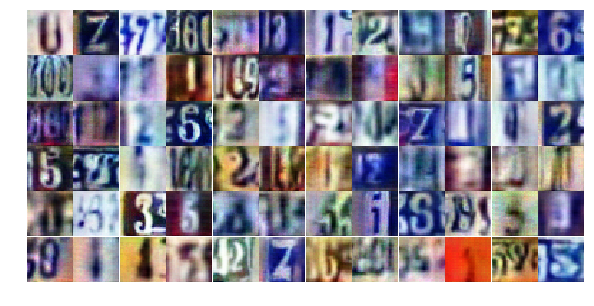

Epoch 23/28... Discriminator Loss: 1.0810... Generator Loss: 1.0139
Epoch 23/28... Discriminator Loss: 1.2835... Generator Loss: 0.6896
Epoch 23/28... Discriminator Loss: 1.1255... Generator Loss: 0.6232
Epoch 23/28... Discriminator Loss: 1.2240... Generator Loss: 1.3018
Epoch 23/28... Discriminator Loss: 1.1497... Generator Loss: 0.9201
Epoch 23/28... Discriminator Loss: 1.0188... Generator Loss: 0.8473
Epoch 23/28... Discriminator Loss: 0.8623... Generator Loss: 1.1858
Epoch 23/28... Discriminator Loss: 0.9539... Generator Loss: 1.1557
Epoch 23/28... Discriminator Loss: 0.9328... Generator Loss: 1.1153
Epoch 23/28... Discriminator Loss: 0.9022... Generator Loss: 1.1173


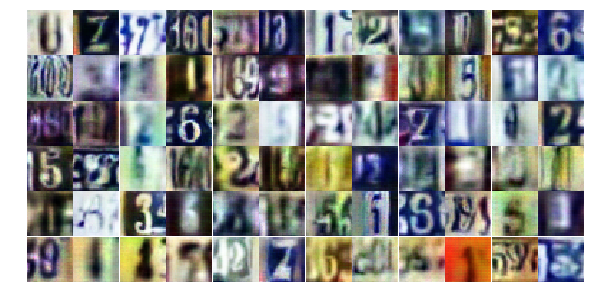

Epoch 23/28... Discriminator Loss: 1.4991... Generator Loss: 0.4778
Epoch 23/28... Discriminator Loss: 1.1694... Generator Loss: 0.6431
Epoch 23/28... Discriminator Loss: 1.2999... Generator Loss: 0.8445
Epoch 23/28... Discriminator Loss: 0.7100... Generator Loss: 1.2262
Epoch 23/28... Discriminator Loss: 1.8005... Generator Loss: 0.4167
Epoch 23/28... Discriminator Loss: 1.1391... Generator Loss: 0.9888
Epoch 23/28... Discriminator Loss: 1.0693... Generator Loss: 0.8575
Epoch 23/28... Discriminator Loss: 1.4019... Generator Loss: 0.5245
Epoch 23/28... Discriminator Loss: 0.8862... Generator Loss: 1.5760
Epoch 23/28... Discriminator Loss: 1.4197... Generator Loss: 0.5415


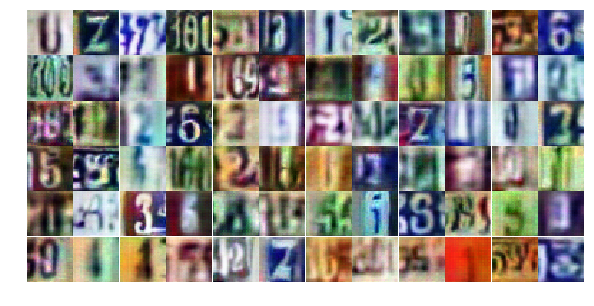

Epoch 23/28... Discriminator Loss: 1.2503... Generator Loss: 0.5262
Epoch 23/28... Discriminator Loss: 1.1667... Generator Loss: 0.6695
Epoch 23/28... Discriminator Loss: 0.7028... Generator Loss: 1.5427
Epoch 23/28... Discriminator Loss: 0.8651... Generator Loss: 1.0170
Epoch 23/28... Discriminator Loss: 1.4437... Generator Loss: 0.4474
Epoch 23/28... Discriminator Loss: 1.9120... Generator Loss: 0.2442
Epoch 23/28... Discriminator Loss: 1.1485... Generator Loss: 0.6463
Epoch 24/28... Discriminator Loss: 0.9542... Generator Loss: 0.8555
Epoch 24/28... Discriminator Loss: 0.9711... Generator Loss: 1.0977
Epoch 24/28... Discriminator Loss: 1.0659... Generator Loss: 0.9006


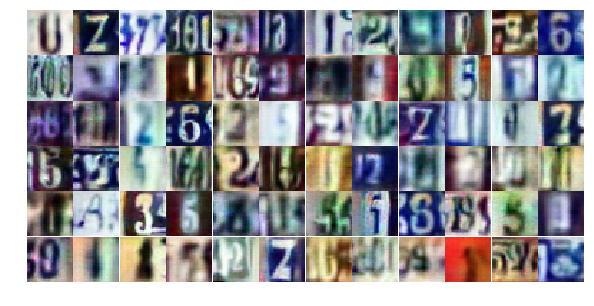

Epoch 24/28... Discriminator Loss: 1.1038... Generator Loss: 1.3872
Epoch 24/28... Discriminator Loss: 0.9371... Generator Loss: 1.1408
Epoch 24/28... Discriminator Loss: 0.4850... Generator Loss: 2.1026
Epoch 24/28... Discriminator Loss: 0.9678... Generator Loss: 0.7450
Epoch 24/28... Discriminator Loss: 1.1574... Generator Loss: 0.9726
Epoch 24/28... Discriminator Loss: 1.2068... Generator Loss: 0.5717
Epoch 24/28... Discriminator Loss: 1.1085... Generator Loss: 0.7846
Epoch 24/28... Discriminator Loss: 1.2831... Generator Loss: 0.9432
Epoch 24/28... Discriminator Loss: 0.6471... Generator Loss: 1.5842
Epoch 24/28... Discriminator Loss: 0.8546... Generator Loss: 1.2181


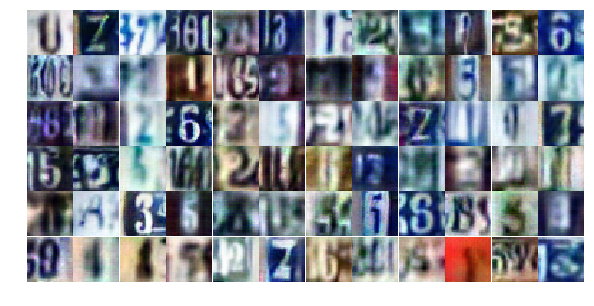

Epoch 24/28... Discriminator Loss: 1.2309... Generator Loss: 0.6130
Epoch 24/28... Discriminator Loss: 1.4315... Generator Loss: 0.5113
Epoch 24/28... Discriminator Loss: 1.5527... Generator Loss: 0.3556
Epoch 24/28... Discriminator Loss: 0.8388... Generator Loss: 1.3678
Epoch 24/28... Discriminator Loss: 1.1947... Generator Loss: 0.6334
Epoch 24/28... Discriminator Loss: 1.1087... Generator Loss: 1.2193
Epoch 24/28... Discriminator Loss: 0.9733... Generator Loss: 0.9058
Epoch 24/28... Discriminator Loss: 1.2312... Generator Loss: 1.0018
Epoch 24/28... Discriminator Loss: 1.0447... Generator Loss: 0.7592
Epoch 24/28... Discriminator Loss: 1.0589... Generator Loss: 0.9312


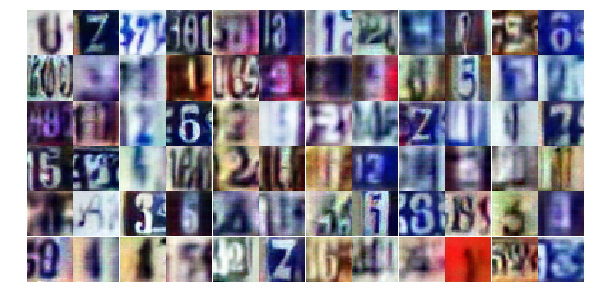

Epoch 24/28... Discriminator Loss: 1.1991... Generator Loss: 0.6072
Epoch 24/28... Discriminator Loss: 0.9776... Generator Loss: 1.0929
Epoch 24/28... Discriminator Loss: 0.9106... Generator Loss: 1.7143
Epoch 24/28... Discriminator Loss: 1.2929... Generator Loss: 0.5489
Epoch 24/28... Discriminator Loss: 0.9668... Generator Loss: 0.8730
Epoch 24/28... Discriminator Loss: 0.7892... Generator Loss: 1.5390
Epoch 24/28... Discriminator Loss: 0.7779... Generator Loss: 1.2066
Epoch 24/28... Discriminator Loss: 1.0660... Generator Loss: 0.7704
Epoch 24/28... Discriminator Loss: 0.9928... Generator Loss: 0.7703
Epoch 24/28... Discriminator Loss: 1.0647... Generator Loss: 0.8810


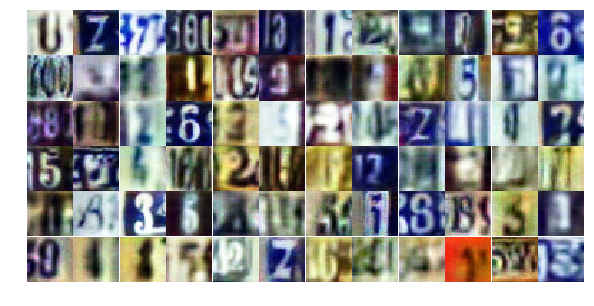

Epoch 24/28... Discriminator Loss: 0.9030... Generator Loss: 0.8772
Epoch 24/28... Discriminator Loss: 0.8780... Generator Loss: 1.0776
Epoch 24/28... Discriminator Loss: 1.2438... Generator Loss: 0.8620
Epoch 24/28... Discriminator Loss: 1.2605... Generator Loss: 0.6076
Epoch 24/28... Discriminator Loss: 0.3733... Generator Loss: 1.4748
Epoch 24/28... Discriminator Loss: 1.3873... Generator Loss: 5.0847
Epoch 24/28... Discriminator Loss: 1.0130... Generator Loss: 1.3059
Epoch 24/28... Discriminator Loss: 1.0373... Generator Loss: 0.7735
Epoch 24/28... Discriminator Loss: 1.3172... Generator Loss: 2.7127
Epoch 24/28... Discriminator Loss: 1.1648... Generator Loss: 1.3907


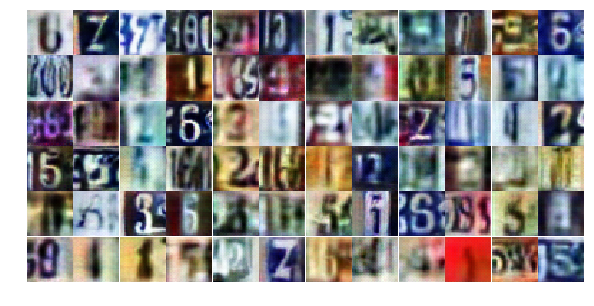

Epoch 24/28... Discriminator Loss: 0.9563... Generator Loss: 0.7700
Epoch 24/28... Discriminator Loss: 0.9959... Generator Loss: 0.7020
Epoch 24/28... Discriminator Loss: 0.6097... Generator Loss: 1.2428
Epoch 24/28... Discriminator Loss: 1.8588... Generator Loss: 1.1401
Epoch 24/28... Discriminator Loss: 1.2973... Generator Loss: 0.5426
Epoch 24/28... Discriminator Loss: 1.4126... Generator Loss: 0.4824
Epoch 24/28... Discriminator Loss: 1.3227... Generator Loss: 0.7326
Epoch 24/28... Discriminator Loss: 0.8881... Generator Loss: 0.9771
Epoch 24/28... Discriminator Loss: 1.1883... Generator Loss: 0.8544
Epoch 24/28... Discriminator Loss: 1.1611... Generator Loss: 0.8272


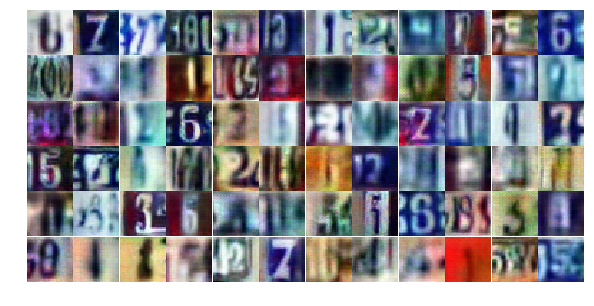

Epoch 24/28... Discriminator Loss: 0.8828... Generator Loss: 0.9693
Epoch 24/28... Discriminator Loss: 1.2491... Generator Loss: 1.3207
Epoch 24/28... Discriminator Loss: 0.8556... Generator Loss: 0.9767
Epoch 24/28... Discriminator Loss: 1.1191... Generator Loss: 1.1645
Epoch 24/28... Discriminator Loss: 1.1735... Generator Loss: 0.7570
Epoch 25/28... Discriminator Loss: 1.0528... Generator Loss: 0.9114
Epoch 25/28... Discriminator Loss: 1.0769... Generator Loss: 0.8279
Epoch 25/28... Discriminator Loss: 0.8005... Generator Loss: 1.2270
Epoch 25/28... Discriminator Loss: 1.3254... Generator Loss: 0.5239
Epoch 25/28... Discriminator Loss: 1.1585... Generator Loss: 0.6488


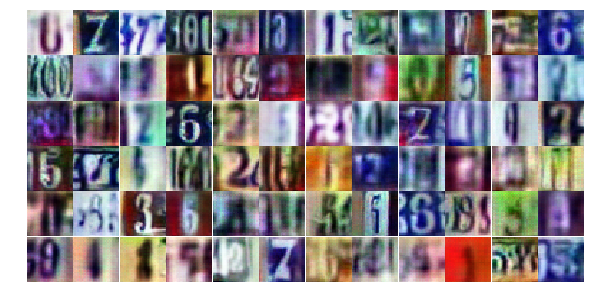

Epoch 25/28... Discriminator Loss: 0.8762... Generator Loss: 1.0663
Epoch 25/28... Discriminator Loss: 1.2470... Generator Loss: 0.6145
Epoch 25/28... Discriminator Loss: 0.9387... Generator Loss: 0.9768
Epoch 25/28... Discriminator Loss: 0.8451... Generator Loss: 1.3289
Epoch 25/28... Discriminator Loss: 1.0653... Generator Loss: 0.7623
Epoch 25/28... Discriminator Loss: 1.1919... Generator Loss: 0.7965
Epoch 25/28... Discriminator Loss: 1.0971... Generator Loss: 1.3332
Epoch 25/28... Discriminator Loss: 1.1554... Generator Loss: 0.6390
Epoch 25/28... Discriminator Loss: 0.9477... Generator Loss: 1.1611
Epoch 25/28... Discriminator Loss: 1.1983... Generator Loss: 0.8267


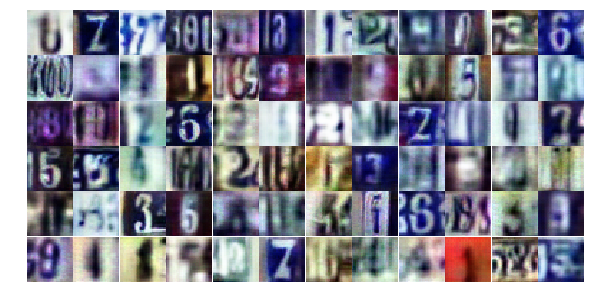

Epoch 25/28... Discriminator Loss: 1.3100... Generator Loss: 0.7383
Epoch 25/28... Discriminator Loss: 1.0921... Generator Loss: 1.1283
Epoch 25/28... Discriminator Loss: 1.2718... Generator Loss: 0.4870
Epoch 25/28... Discriminator Loss: 1.6498... Generator Loss: 0.3801
Epoch 25/28... Discriminator Loss: 1.0579... Generator Loss: 1.0159
Epoch 25/28... Discriminator Loss: 1.0570... Generator Loss: 1.0979
Epoch 25/28... Discriminator Loss: 1.3466... Generator Loss: 0.5203
Epoch 25/28... Discriminator Loss: 1.2373... Generator Loss: 0.7344
Epoch 25/28... Discriminator Loss: 1.1979... Generator Loss: 0.5662
Epoch 25/28... Discriminator Loss: 1.0576... Generator Loss: 0.8362


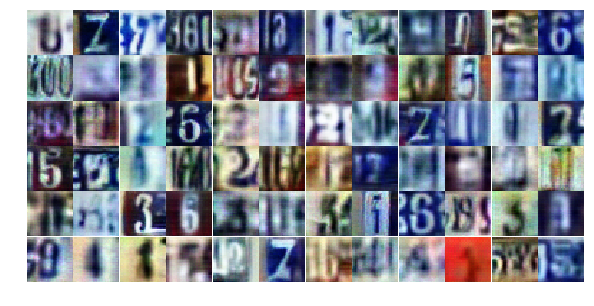

Epoch 25/28... Discriminator Loss: 1.1242... Generator Loss: 0.6979
Epoch 25/28... Discriminator Loss: 0.9404... Generator Loss: 1.0803
Epoch 25/28... Discriminator Loss: 1.4904... Generator Loss: 0.4213
Epoch 25/28... Discriminator Loss: 1.0108... Generator Loss: 0.8695
Epoch 25/28... Discriminator Loss: 1.1724... Generator Loss: 0.6121
Epoch 25/28... Discriminator Loss: 0.8535... Generator Loss: 1.0370
Epoch 25/28... Discriminator Loss: 1.1589... Generator Loss: 0.6731
Epoch 25/28... Discriminator Loss: 0.8578... Generator Loss: 1.1250
Epoch 25/28... Discriminator Loss: 1.2363... Generator Loss: 0.8208
Epoch 25/28... Discriminator Loss: 1.0243... Generator Loss: 1.3394


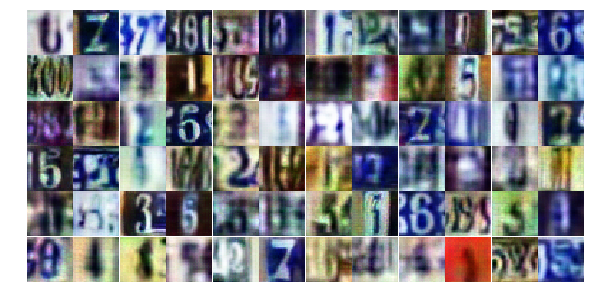

Epoch 25/28... Discriminator Loss: 0.8579... Generator Loss: 1.4369
Epoch 25/28... Discriminator Loss: 0.7683... Generator Loss: 1.7729
Epoch 25/28... Discriminator Loss: 1.3256... Generator Loss: 1.8467
Epoch 25/28... Discriminator Loss: 1.0393... Generator Loss: 1.0887
Epoch 25/28... Discriminator Loss: 0.9323... Generator Loss: 0.8226
Epoch 25/28... Discriminator Loss: 0.9893... Generator Loss: 0.9910
Epoch 25/28... Discriminator Loss: 0.4401... Generator Loss: 1.4285
Epoch 25/28... Discriminator Loss: 1.5392... Generator Loss: 0.3947
Epoch 25/28... Discriminator Loss: 2.3822... Generator Loss: 1.0733
Epoch 25/28... Discriminator Loss: 1.0853... Generator Loss: 1.1582


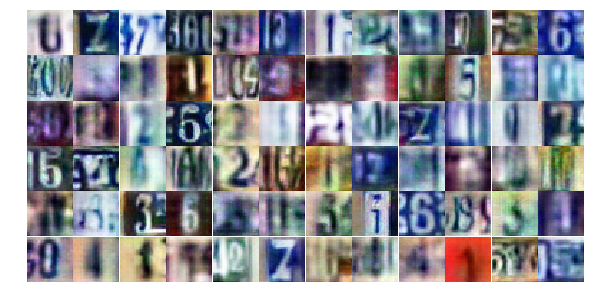

Epoch 25/28... Discriminator Loss: 1.6385... Generator Loss: 2.0861
Epoch 25/28... Discriminator Loss: 1.1375... Generator Loss: 0.7593
Epoch 25/28... Discriminator Loss: 1.1697... Generator Loss: 1.2008
Epoch 25/28... Discriminator Loss: 1.2232... Generator Loss: 0.6189
Epoch 25/28... Discriminator Loss: 1.2923... Generator Loss: 0.5192
Epoch 25/28... Discriminator Loss: 0.9721... Generator Loss: 1.0457
Epoch 25/28... Discriminator Loss: 1.2623... Generator Loss: 0.5923
Epoch 25/28... Discriminator Loss: 1.5224... Generator Loss: 0.4673
Epoch 25/28... Discriminator Loss: 0.9528... Generator Loss: 0.8928
Epoch 25/28... Discriminator Loss: 0.8309... Generator Loss: 0.9434


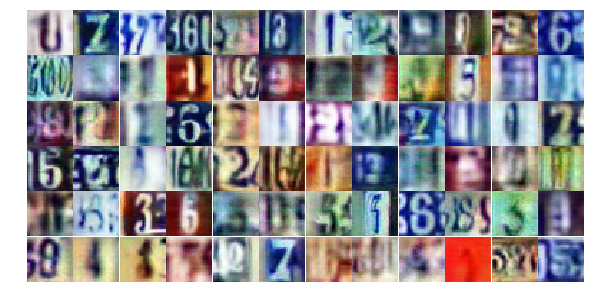

Epoch 25/28... Discriminator Loss: 1.0061... Generator Loss: 1.2828
Epoch 25/28... Discriminator Loss: 1.2003... Generator Loss: 0.7351
Epoch 26/28... Discriminator Loss: 1.2218... Generator Loss: 0.6350
Epoch 26/28... Discriminator Loss: 0.9951... Generator Loss: 0.9843
Epoch 26/28... Discriminator Loss: 0.9252... Generator Loss: 1.1345
Epoch 26/28... Discriminator Loss: 1.1842... Generator Loss: 0.6815
Epoch 26/28... Discriminator Loss: 1.0759... Generator Loss: 0.6954
Epoch 26/28... Discriminator Loss: 1.0956... Generator Loss: 1.5095
Epoch 26/28... Discriminator Loss: 1.1964... Generator Loss: 1.4292
Epoch 26/28... Discriminator Loss: 1.1342... Generator Loss: 0.7723


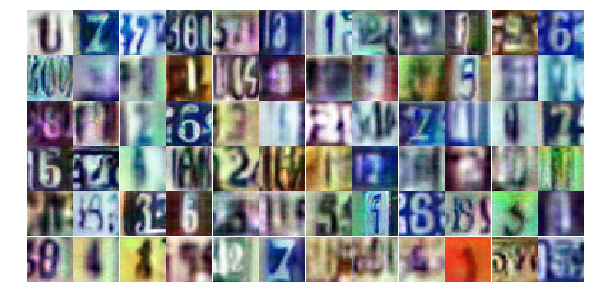

Epoch 26/28... Discriminator Loss: 1.2138... Generator Loss: 1.3855
Epoch 26/28... Discriminator Loss: 0.9102... Generator Loss: 0.8564
Epoch 26/28... Discriminator Loss: 0.7287... Generator Loss: 2.4550
Epoch 26/28... Discriminator Loss: 1.2509... Generator Loss: 0.6637
Epoch 26/28... Discriminator Loss: 1.0761... Generator Loss: 1.0879
Epoch 26/28... Discriminator Loss: 1.1929... Generator Loss: 0.8048
Epoch 26/28... Discriminator Loss: 1.3516... Generator Loss: 0.4938
Epoch 26/28... Discriminator Loss: 0.7154... Generator Loss: 1.1981
Epoch 26/28... Discriminator Loss: 1.2508... Generator Loss: 1.1005
Epoch 26/28... Discriminator Loss: 0.8207... Generator Loss: 1.0892


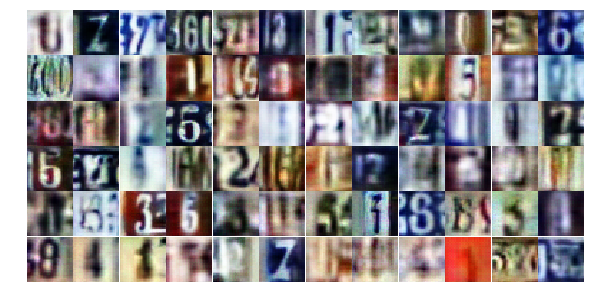

Epoch 26/28... Discriminator Loss: 0.3157... Generator Loss: 1.6662
Epoch 26/28... Discriminator Loss: 0.4419... Generator Loss: 4.1199
Epoch 26/28... Discriminator Loss: 0.1393... Generator Loss: 2.7709
Epoch 26/28... Discriminator Loss: 1.4688... Generator Loss: 0.4232
Epoch 26/28... Discriminator Loss: 1.2815... Generator Loss: 1.8455
Epoch 26/28... Discriminator Loss: 1.0869... Generator Loss: 0.8895
Epoch 26/28... Discriminator Loss: 1.1003... Generator Loss: 0.8756
Epoch 26/28... Discriminator Loss: 1.0471... Generator Loss: 0.9574
Epoch 26/28... Discriminator Loss: 1.2243... Generator Loss: 0.6411
Epoch 26/28... Discriminator Loss: 1.1555... Generator Loss: 0.7112


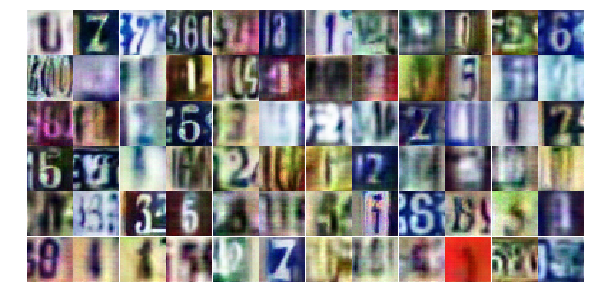

Epoch 26/28... Discriminator Loss: 1.2808... Generator Loss: 1.4231
Epoch 26/28... Discriminator Loss: 0.9956... Generator Loss: 0.9542
Epoch 26/28... Discriminator Loss: 0.9851... Generator Loss: 1.0226
Epoch 26/28... Discriminator Loss: 1.0457... Generator Loss: 0.8159
Epoch 26/28... Discriminator Loss: 1.1639... Generator Loss: 0.7317
Epoch 26/28... Discriminator Loss: 1.1770... Generator Loss: 0.9282
Epoch 26/28... Discriminator Loss: 1.0346... Generator Loss: 0.8129
Epoch 26/28... Discriminator Loss: 1.3189... Generator Loss: 0.9140
Epoch 26/28... Discriminator Loss: 0.7856... Generator Loss: 1.0061
Epoch 26/28... Discriminator Loss: 1.3425... Generator Loss: 0.5596


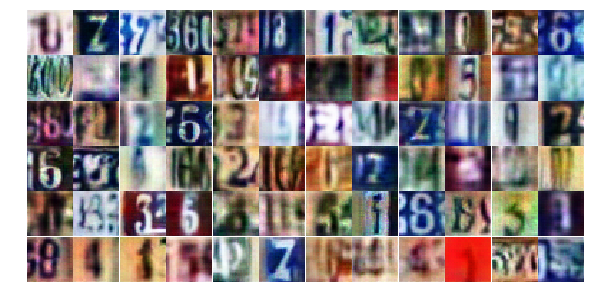

Epoch 26/28... Discriminator Loss: 0.9420... Generator Loss: 0.8363
Epoch 26/28... Discriminator Loss: 0.8254... Generator Loss: 1.1035
Epoch 26/28... Discriminator Loss: 1.2303... Generator Loss: 1.5905
Epoch 26/28... Discriminator Loss: 0.6527... Generator Loss: 1.4944
Epoch 26/28... Discriminator Loss: 0.9918... Generator Loss: 1.4465
Epoch 26/28... Discriminator Loss: 1.1694... Generator Loss: 0.5734
Epoch 26/28... Discriminator Loss: 1.8316... Generator Loss: 0.2844
Epoch 26/28... Discriminator Loss: 1.2568... Generator Loss: 0.5256
Epoch 26/28... Discriminator Loss: 1.1657... Generator Loss: 0.6903
Epoch 26/28... Discriminator Loss: 1.1101... Generator Loss: 0.8229


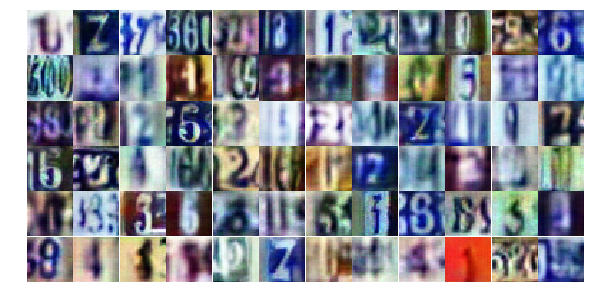

Epoch 26/28... Discriminator Loss: 0.9547... Generator Loss: 0.8725
Epoch 26/28... Discriminator Loss: 0.8436... Generator Loss: 2.8198
Epoch 26/28... Discriminator Loss: 1.1867... Generator Loss: 0.9916
Epoch 26/28... Discriminator Loss: 1.0006... Generator Loss: 0.8982
Epoch 26/28... Discriminator Loss: 1.2708... Generator Loss: 0.6294
Epoch 26/28... Discriminator Loss: 1.4460... Generator Loss: 0.4440
Epoch 26/28... Discriminator Loss: 1.5397... Generator Loss: 1.6320
Epoch 26/28... Discriminator Loss: 1.9509... Generator Loss: 2.9069
Epoch 26/28... Discriminator Loss: 0.8279... Generator Loss: 1.2943
Epoch 27/28... Discriminator Loss: 1.1162... Generator Loss: 0.7326


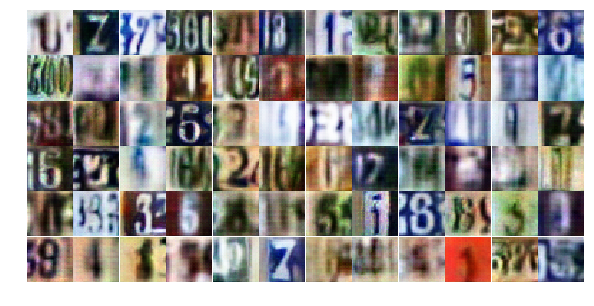

Epoch 27/28... Discriminator Loss: 1.0330... Generator Loss: 0.7898
Epoch 27/28... Discriminator Loss: 1.1053... Generator Loss: 1.2291
Epoch 27/28... Discriminator Loss: 1.3711... Generator Loss: 0.5020
Epoch 27/28... Discriminator Loss: 1.1863... Generator Loss: 0.6868
Epoch 27/28... Discriminator Loss: 1.0030... Generator Loss: 1.4631
Epoch 27/28... Discriminator Loss: 0.2727... Generator Loss: 2.1178
Epoch 27/28... Discriminator Loss: 0.1481... Generator Loss: 2.8303
Epoch 27/28... Discriminator Loss: 0.0570... Generator Loss: 3.5130
Epoch 27/28... Discriminator Loss: 0.0759... Generator Loss: 3.8334
Epoch 27/28... Discriminator Loss: 0.0257... Generator Loss: 4.3466


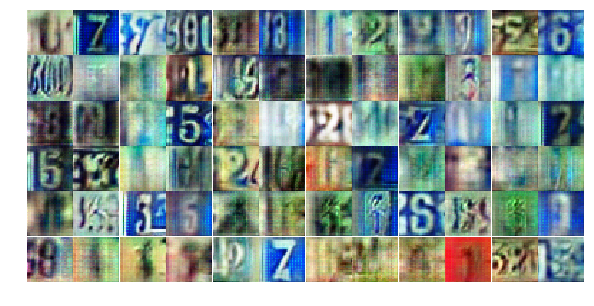

Epoch 27/28... Discriminator Loss: 0.0489... Generator Loss: 4.1024
Epoch 27/28... Discriminator Loss: 0.0231... Generator Loss: 4.8712
Epoch 27/28... Discriminator Loss: 0.0204... Generator Loss: 4.4922
Epoch 27/28... Discriminator Loss: 0.0214... Generator Loss: 4.3137
Epoch 27/28... Discriminator Loss: 0.0124... Generator Loss: 4.8841
Epoch 27/28... Discriminator Loss: 0.0202... Generator Loss: 4.3527
Epoch 27/28... Discriminator Loss: 0.0179... Generator Loss: 4.4779
Epoch 27/28... Discriminator Loss: 0.0221... Generator Loss: 5.6768
Epoch 27/28... Discriminator Loss: 0.0201... Generator Loss: 4.6182
Epoch 27/28... Discriminator Loss: 0.0050... Generator Loss: 6.8231


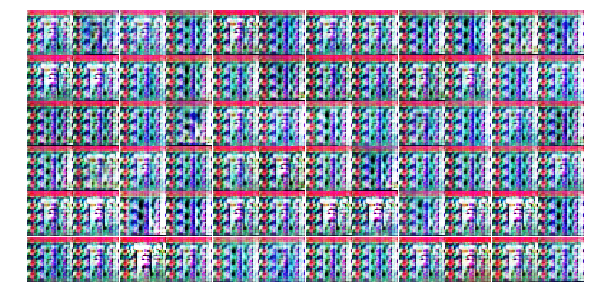

Epoch 27/28... Discriminator Loss: 0.0085... Generator Loss: 6.2382
Epoch 27/28... Discriminator Loss: 0.0092... Generator Loss: 5.2674
Epoch 27/28... Discriminator Loss: 0.0088... Generator Loss: 5.6494
Epoch 27/28... Discriminator Loss: 0.3260... Generator Loss: 2.3136
Epoch 27/28... Discriminator Loss: 0.0790... Generator Loss: 3.4591
Epoch 27/28... Discriminator Loss: 0.0667... Generator Loss: 7.7212
Epoch 27/28... Discriminator Loss: 0.4102... Generator Loss: 9.1655
Epoch 27/28... Discriminator Loss: 0.2229... Generator Loss: 2.4580
Epoch 27/28... Discriminator Loss: 0.2479... Generator Loss: 3.2372
Epoch 27/28... Discriminator Loss: 0.3149... Generator Loss: 2.1206


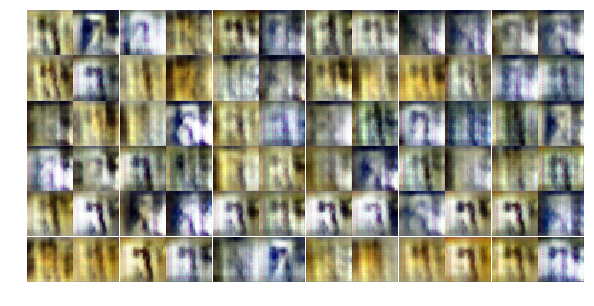

Epoch 27/28... Discriminator Loss: 0.2896... Generator Loss: 1.9804
Epoch 27/28... Discriminator Loss: 0.4423... Generator Loss: 1.7647
Epoch 27/28... Discriminator Loss: 0.3336... Generator Loss: 2.2379
Epoch 27/28... Discriminator Loss: 0.3680... Generator Loss: 1.8744
Epoch 27/28... Discriminator Loss: 0.5150... Generator Loss: 1.5544
Epoch 27/28... Discriminator Loss: 0.4186... Generator Loss: 1.8539
Epoch 27/28... Discriminator Loss: 0.3952... Generator Loss: 1.8626
Epoch 27/28... Discriminator Loss: 0.5924... Generator Loss: 2.1215
Epoch 27/28... Discriminator Loss: 0.4333... Generator Loss: 2.3851
Epoch 27/28... Discriminator Loss: 0.6102... Generator Loss: 1.4162


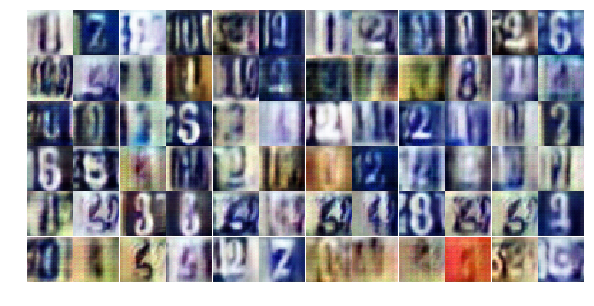

Epoch 27/28... Discriminator Loss: 0.5265... Generator Loss: 1.7381
Epoch 27/28... Discriminator Loss: 0.5616... Generator Loss: 1.2821
Epoch 27/28... Discriminator Loss: 0.5632... Generator Loss: 1.8871
Epoch 27/28... Discriminator Loss: 0.7463... Generator Loss: 1.4646
Epoch 27/28... Discriminator Loss: 0.4153... Generator Loss: 2.4919
Epoch 27/28... Discriminator Loss: 1.0015... Generator Loss: 1.4686
Epoch 27/28... Discriminator Loss: 0.5752... Generator Loss: 1.8045
Epoch 27/28... Discriminator Loss: 0.8214... Generator Loss: 0.9873
Epoch 27/28... Discriminator Loss: 0.7485... Generator Loss: 1.7514
Epoch 27/28... Discriminator Loss: 0.9465... Generator Loss: 0.7943


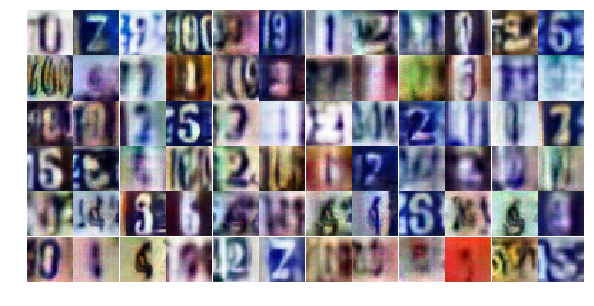

Epoch 27/28... Discriminator Loss: 0.7009... Generator Loss: 1.5553
Epoch 27/28... Discriminator Loss: 1.0281... Generator Loss: 0.8361
Epoch 27/28... Discriminator Loss: 1.1228... Generator Loss: 0.6825
Epoch 27/28... Discriminator Loss: 0.8174... Generator Loss: 1.2558
Epoch 27/28... Discriminator Loss: 1.0992... Generator Loss: 0.6438
Epoch 27/28... Discriminator Loss: 0.5980... Generator Loss: 1.6638
Epoch 27/28... Discriminator Loss: 1.2830... Generator Loss: 0.4659
Epoch 28/28... Discriminator Loss: 0.8089... Generator Loss: 1.1950
Epoch 28/28... Discriminator Loss: 0.9678... Generator Loss: 0.8335
Epoch 28/28... Discriminator Loss: 0.8922... Generator Loss: 0.9257


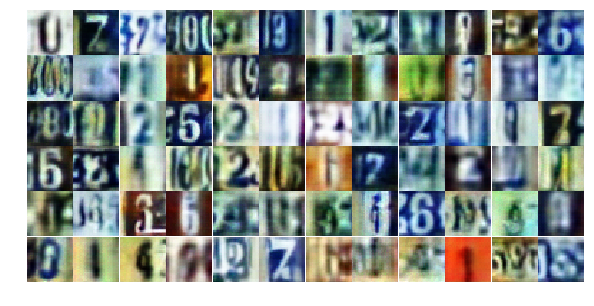

Epoch 28/28... Discriminator Loss: 0.5993... Generator Loss: 1.6259
Epoch 28/28... Discriminator Loss: 0.9688... Generator Loss: 0.9956
Epoch 28/28... Discriminator Loss: 0.8286... Generator Loss: 1.0248
Epoch 28/28... Discriminator Loss: 1.7042... Generator Loss: 2.2660
Epoch 28/28... Discriminator Loss: 2.0589... Generator Loss: 3.7306
Epoch 28/28... Discriminator Loss: 1.0076... Generator Loss: 1.1413
Epoch 28/28... Discriminator Loss: 0.7662... Generator Loss: 1.3724
Epoch 28/28... Discriminator Loss: 0.9573... Generator Loss: 1.5466
Epoch 28/28... Discriminator Loss: 1.0278... Generator Loss: 0.8112
Epoch 28/28... Discriminator Loss: 0.6601... Generator Loss: 1.4397


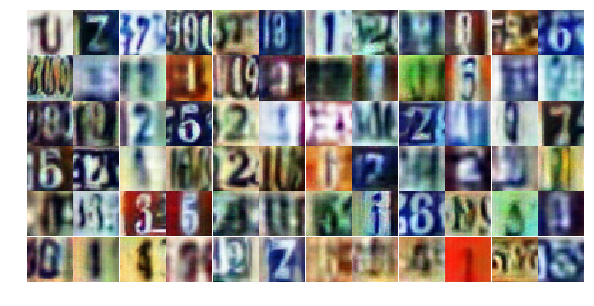

Epoch 28/28... Discriminator Loss: 0.9900... Generator Loss: 0.8108
Epoch 28/28... Discriminator Loss: 0.9857... Generator Loss: 1.7306
Epoch 28/28... Discriminator Loss: 0.4731... Generator Loss: 1.7185
Epoch 28/28... Discriminator Loss: 0.3898... Generator Loss: 1.8570
Epoch 28/28... Discriminator Loss: 0.5178... Generator Loss: 1.9372
Epoch 28/28... Discriminator Loss: 1.1169... Generator Loss: 2.0131
Epoch 28/28... Discriminator Loss: 1.1554... Generator Loss: 0.7016
Epoch 28/28... Discriminator Loss: 1.1838... Generator Loss: 0.6246
Epoch 28/28... Discriminator Loss: 1.0613... Generator Loss: 2.1116
Epoch 28/28... Discriminator Loss: 1.0588... Generator Loss: 1.1132


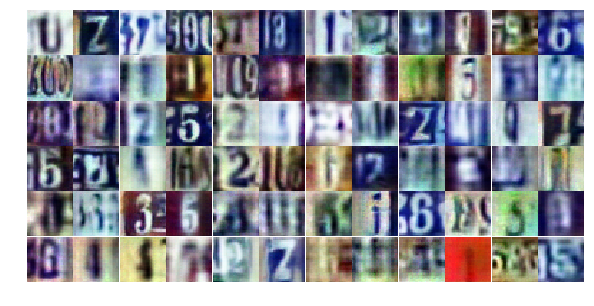

Epoch 28/28... Discriminator Loss: 0.9085... Generator Loss: 0.9498
Epoch 28/28... Discriminator Loss: 0.8271... Generator Loss: 1.1336
Epoch 28/28... Discriminator Loss: 0.7447... Generator Loss: 1.4721
Epoch 28/28... Discriminator Loss: 0.9650... Generator Loss: 0.7967
Epoch 28/28... Discriminator Loss: 0.9310... Generator Loss: 1.0888
Epoch 28/28... Discriminator Loss: 0.7583... Generator Loss: 1.2034
Epoch 28/28... Discriminator Loss: 0.7896... Generator Loss: 1.4299
Epoch 28/28... Discriminator Loss: 0.8879... Generator Loss: 1.2426
Epoch 28/28... Discriminator Loss: 0.7980... Generator Loss: 1.4696
Epoch 28/28... Discriminator Loss: 1.7116... Generator Loss: 0.3750


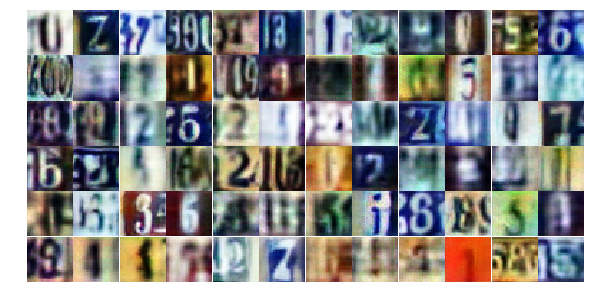

Epoch 28/28... Discriminator Loss: 0.9274... Generator Loss: 0.7900
Epoch 28/28... Discriminator Loss: 0.6352... Generator Loss: 1.5004
Epoch 28/28... Discriminator Loss: 1.2164... Generator Loss: 0.6062
Epoch 28/28... Discriminator Loss: 0.8099... Generator Loss: 1.1309
Epoch 28/28... Discriminator Loss: 0.8627... Generator Loss: 1.3463
Epoch 28/28... Discriminator Loss: 0.9685... Generator Loss: 0.9361
Epoch 28/28... Discriminator Loss: 0.9151... Generator Loss: 1.2025
Epoch 28/28... Discriminator Loss: 0.8915... Generator Loss: 1.0337
Epoch 28/28... Discriminator Loss: 0.9060... Generator Loss: 0.8772
Epoch 28/28... Discriminator Loss: 0.7053... Generator Loss: 1.3439


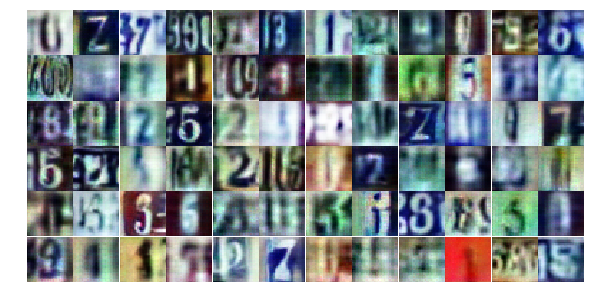

Epoch 28/28... Discriminator Loss: 1.3467... Generator Loss: 2.8984
Epoch 28/28... Discriminator Loss: 1.1893... Generator Loss: 0.6944
Epoch 28/28... Discriminator Loss: 0.5880... Generator Loss: 1.5224
Epoch 28/28... Discriminator Loss: 0.9590... Generator Loss: 1.4777
Epoch 28/28... Discriminator Loss: 1.3878... Generator Loss: 0.4766
Epoch 28/28... Discriminator Loss: 1.0408... Generator Loss: 1.3166
Epoch 28/28... Discriminator Loss: 0.8565... Generator Loss: 1.2725
Epoch 28/28... Discriminator Loss: 0.8086... Generator Loss: 0.8943
Epoch 28/28... Discriminator Loss: 0.9996... Generator Loss: 0.8901
Epoch 28/28... Discriminator Loss: 1.0194... Generator Loss: 0.7720


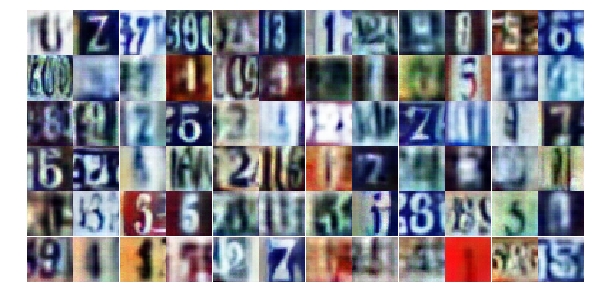

Epoch 28/28... Discriminator Loss: 0.6570... Generator Loss: 1.3579
Epoch 28/28... Discriminator Loss: 1.4104... Generator Loss: 1.8348
Epoch 28/28... Discriminator Loss: 0.8922... Generator Loss: 0.9450
Epoch 28/28... Discriminator Loss: 1.0635... Generator Loss: 1.3264


In [17]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

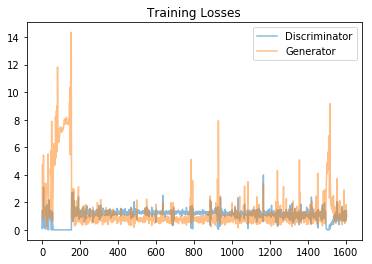

In [18]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

In [ ]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))